![](https://www.vhv.rs/dpng/f/21-217176_street-png.png)

Reference: https://www.kaggle.com/hamzashabbirbhatti/eda-a-quant-s-prespective

# Data Description

This dataset contains an anonymized set of features, feature_{0...129}, representing real stock market data. Each row in the dataset represents a trading opportunity, for which you will be predicting an action value: 1 to make the trade and 0 to pass on it. Each trade has an associated weight and resp, which together represents a return on the trade. The date column is an integer which represents the day of the trade, while ts_id represents a time ordering. In addition to anonymized feature values, you are provided with metadata about the features in features.csv.

In the training set, train.csv, you are provided a resp value, as well as several other resp_{1,2,3,4} values that represent returns over different time horizons. These variables are not included in the test set. Trades with weight = 0 were intentionally included in the dataset for completeness, although such trades will not contribute towards the scoring evaluation.

This is a code competition that relies on a time-series API to ensure models do not peek forward in time. To use the API, follow the instructions on the Evaluation page. When you submit your notebook, it will be rerun on an unseen test:

   - During the model training phase of the competition, this unseen test set is comprised of approximately 1 million rows of historical data.
   - During the live forecasting phase, the test set will use periodically updated live market data.

Note that during the second (forecasting) phase of the competition, the notebook time limits will scale with the number of trades presented in the test set. Refer to the Code Requirements for details.

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec
from collections import defaultdict

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))
  
# Then move kaggle.json into the folder where the API expects to find it.
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json
User uploaded file "kaggle.json" with length 74 bytes


In [ ]:
!kaggle competitions download -c jane-street-market-prediction

  0% 0.00/59.0 [00:00<?, ?B/s]
100% 59.0/59.0 [00:00<00:00, 105kB/s]
  0% 0.00/441k [00:00<?, ?B/s]
100% 441k/441k [00:00<00:00, 60.9MB/s]
  0% 0.00/23.3k [00:00<?, ?B/s]
100% 23.3k/23.3k [00:00<00:00, 23.6MB/s]
100% 2.60G/2.61G [00:32<00:00, 108MB/s]
100% 2.61G/2.61G [00:32<00:00, 85.9MB/s]
  0% 0.00/108k [00:00<?, ?B/s]
100% 108k/108k [00:00<00:00, 121MB/s]
 55% 9.00M/16.4M [00:00<00:00, 39.4MB/s]
100% 16.4M/16.4M [00:00<00:00, 54.4MB/s]


In [ ]:
!unzip train.csv.zip

Archive:  train.csv.zip
  inflating: train.csv               


In [ ]:
df = pd.read_csv("train.csv")

* Dataset has 138 columns. by looking at eh first 5 rows of data it looks like that data has some missing values as well.

In [ ]:
df.head()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29,feature_30,feature_31,feature_32,...,feature_91,feature_92,feature_93,feature_94,feature_95,feature_96,feature_97,feature_98,feature_99,feature_100,feature_101,feature_102,feature_103,feature_104,feature_105,feature_106,feature_107,feature_108,feature_109,feature_110,feature_111,feature_112,feature_113,feature_114,feature_115,feature_116,feature_117,feature_118,feature_119,feature_120,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0,0.000000,0.009916,0.014079,0.008773,0.001390,0.006270,1,-1.872746,-2.191242,-0.474163,-0.323046,0.014688,-0.002484,NaN,NaN,-0.989982,-1.055090,NaN,NaN,-2.667671,-2.001475,-1.703595,-2.196892,NaN,NaN,1.483295,1.307466,NaN,NaN,1.175200,0.967805,1.608410,1.319365,NaN,NaN,-0.515073,-0.448988,NaN,NaN,...,1.158770,NaN,3.754522,7.137163,-1.863069,NaN,0.434466,NaN,-0.292035,0.317003,-2.605820,NaN,2.896986,NaN,1.485813,4.147254,-2.238831,NaN,-0.892724,NaN,-0.156332,0.622816,-3.921523,NaN,2.561593,NaN,3.457757,6.649580,-1.472686,NaN,NaN,1.168391,8.313583,1.782433,14.018213,2.653056,12.600292,2.301488,11.445807,0
1,0,16.673515,-0.002828,-0.003226,-0.007319,-0.011114,-0.009792,-1,-1.349537,-1.704709,0.068058,0.028432,0.193794,0.138212,NaN,NaN,-0.151877,-0.384952,NaN,NaN,1.225838,0.789076,1.110580,1.102281,NaN,NaN,-0.590600,-0.625682,NaN,NaN,-0.543425,-0.547486,-0.706600,-0.667806,NaN,NaN,0.910558,0.914465,NaN,NaN,...,1.157671,NaN,1.297679,1.281956,-2.427595,NaN,0.024913,NaN,-0.413607,-0.073672,-2.434546,NaN,0.949879,NaN,0.724655,1.622137,-2.209020,NaN,-1.332492,NaN,-0.586619,-1.040491,-3.946097,NaN,0.983440,NaN,1.357907,1.612348,-1.664544,NaN,NaN,-1.178850,1.777472,-0.915458,2.831612,-1.417010,2.297459,-1.304614,1.898684,1
2,0,0.000000,0.025134,0.027607,0.033406,0.034380,0.023970,-1,0.812780,-0.256156,0.806463,0.400221,-0.614188,-0.354800,NaN,NaN,5.448261,2.668029,NaN,NaN,3.836342,2.183258,3.902698,3.045431,NaN,NaN,-1.141082,-0.979962,NaN,NaN,-1.157585,-0.966803,-1.430973,-1.103432,NaN,NaN,5.131559,4.314714,NaN,NaN,...,2.420089,NaN,0.800962,1.143663,-3.214578,NaN,1.585939,NaN,0.193996,0.953114,-2.674838,NaN,2.200085,NaN,0.537175,2.156228,-3.568648,NaN,1.193823,NaN,0.097345,0.796214,-4.090058,NaN,2.548596,NaN,0.882588,1.817895,-2.432424,NaN,NaN,6.115747,9.667908,5.542871,11.671595,7.281757,10.060014,6.638248,9.427299,2
3,0,0.000000,-0.004730,-0.003273,-0.000461,-0.000476,-0.003200,-1,1.174378,0.344640,0.066872,0.009357,-1.006373,-0.676458,NaN,NaN,4.508206,2.484260,NaN,NaN,2.902176,1.799163,3.192700,2.848359,NaN,NaN,-1.401637,-1.428248,NaN,NaN,-1.421175,-1.487976,-1.756415,-1.647543,NaN,NaN,4.766182,4.528353,NaN,NaN,...,2.330484,NaN,0.182066,1.088451,-3.527752,NaN,-1.338859,NaN,-1.257774,-1.194013,-1.719062,NaN,-0.940190,NaN,-1.510224,-1.781693,-3.373969,NaN,2.513074,NaN,0.424964,1.992887,-2.616856,NaN,0.561528,NaN,-0.994041,0.099560,-2.485993,NaN,NaN,2.838853,0.499251,3.033732,1.513488,4.397532,1.266037,3.856384,1.013469,3
4,0,0.138531,0.001252,0.002165,-0.001215,-0.006219,-0.002604,1,-3.172026,-3.093182,-0.161518,-0.128149,-0.195006,-0.143780,NaN,NaN,2.683018,1.450991,NaN,NaN,1.257761,0.632336,0.905204,0.575275,NaN,NaN,2.550883,2.484082,NaN,NaN,2.502828,2.606440,2.731251,2.566561,NaN,NaN,-1.477905,-1.722451,NaN,NaN,...,4.345282,NaN,2.737738,2.602937,-1.785502,NaN,-0.172561,NaN,-0.299516,-0.420021,-2.354611,NaN,0.762192,NaN,1.598620,0.623132,-1.742540,NaN,-0.934675,NaN,-0.373013,-1.213540,-3.677787,NaN,2.684119,NaN,2.861848,2.134804,-1.279284,NaN,NaN,0.344850,4.101145,0.614252,6.623456,0.800129,5.233243,0.362636,3.926633,4


In [ ]:
meta_data = pd.read_csv('features.csv')

In [ ]:
meta_data.head()

,feature,tag_0,tag_1,tag_2,tag_3,tag_4,tag_5,tag_6,tag_7,tag_8,tag_9,tag_10,tag_11,tag_12,tag_13,tag_14,tag_15,tag_16,tag_17,tag_18,tag_19,tag_20,tag_21,tag_22,tag_23,tag_24,tag_25,tag_26,tag_27,tag_28
0,feature_0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,feature_1,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,feature_2,False,False,False,False,False,False,True,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,feature_3,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,feature_4,False,False,False,False,False,False,True,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [ ]:
df.ts_id.unique()

array([      0,       1,       2, ..., 2390488, 2390489, 2390490])

In [ ]:
len(df.ts_id.unique())

2390491

In [ ]:
df.sort_values(by= ['date','ts_id'],inplace=True)

In [ ]:
sample_df = df.query('date == 0')

In [ ]:
sample_df.describe()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29,feature_30,feature_31,feature_32,...,feature_91,feature_92,feature_93,feature_94,feature_95,feature_96,feature_97,feature_98,feature_99,feature_100,feature_101,feature_102,feature_103,feature_104,feature_105,feature_106,feature_107,feature_108,feature_109,feature_110,feature_111,feature_112,feature_113,feature_114,feature_115,feature_116,feature_117,feature_118,feature_119,feature_120,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
count,5587.0,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,5587.000000,4787.000000,4787.000000,5585.000000,5585.000000,5401.000000,5401.000000,5553.000000,5553.000000,5571.000000,5571.000000,4784.000000,4784.000000,5585.000000,5585.000000,5399.000000,5399.000000,5553.000000,5553.000000,5571.000000,5571.000000,4784.000000,4784.000000,5585.000000,5585.000000,5399.000000,5399.000000,...,5585.000000,5435.000000,5553.000000,5571.000000,5587.000000,4871.000000,5585.000000,5435.000000,5553.000000,5571.000000,5587.000000,4871.000000,5585.000000,5435.000000,5553.000000,5571.000000,5587.000000,4871.000000,5585.000000,5435.000000,5553.000000,5571.000000,5587.000000,4871.000000,5585.000000,5435.000000,5553.000000,5571.000000,5587.000000,5437.000000,5437.000000,5587.000000,5587.000000,5552.000000,5552.000000,5566.000000,5566.000000,5583.000000,5583.000000,5587.000000
mean,0.0,2.004706,0.000020,0.000036,0.000460,0.002755,0.002285,0.020226,0.704028,-0.595923,0.102204,0.017371,0.111686,0.042895,0.169014,-0.085089,0.855089,-0.367322,0.249186,-0.225808,0.505852,-0.261926,0.637426,-0.470387,0.178181,0.026680,0.414203,0.121306,0.347005,0.098755,0.403261,0.137059,0.420384,0.128853,0.238670,0.113446,0.503686,0.229105,0.331015,0.150020,...,0.804891,0.626870,0.598617,0.658164,0.721280,0.115894,0.311491,0.131886,0.201736,0.234506,0.119657,0.590469,0.703889,0.495732,0.515177,0.633540,0.649164,0.103825,0.115466,0.224546,0.205613,0.084561,0.123119,0.643725,0.853178,0.688223,0.728163,0.792377,0.608926,1.006430,-0.677243,1.021091,-0.448813,0.968835,-0.729380,1.243077,-0.513070,1.130553,-0.436875,2793.000000
std,0.0,5.756178,0.011050,0.014902,0.027288,0.035080,0.028258,0.999885,2.824716,1.820124,2.443553,1.209477,2.060284,1.006739,2.014289,1.230859,2.531002,1.115580,1.828665,1.499428,2.462539,1.222786,2.069017,1.495159,1.565842,1.151467,1.916910,1.201830,2.556400,0.986929,2.317814,1.601241,2.277173,1.393124,1.984193,1.469888,2.021975,1.324900,2.021699,1.691045,...,3.207743,2.022387,2.238293,2.581071,2.098956,1.732061,2.097978,1.910073,1.649681,1.729739,1.644195,2.090357,2.525400,1.577918,1.895602,2.893104,2.107754,2.295506,2.250570,1.746352,1.891005,2.601807,2.075908,1.887119,2.578053,2.094636,2.319472,2.512411,1.671011,2.025139,1.979969,2.308991,1.722394,1.942894,2.181850,2.749516,1.651623,2.529628,1.543382,1612.972308
min,0.0,0.000000,-0.162525,-0.169475,-0.194096,-0.216788,-0.168365,-1.000000,-3.172026,-3.093182,-7.401405,-4.544310,-6.102448,-3.287124,-11.873722,-7.726835,-11.549056,-6.528488,-17.364956,-12.226912,-25.777177,-14.323229,-11.655753,-7.833867,-10.272717,-7.365138,-7.375763,-4.552891,-16.118822,-7.938220,-14.559287,-8.702156,-12.235744,-7.684609,-11.795004,-8.468562,-9.238102,-7.280102,-19.087814,-13.497338,...,-1.515613,-2.115890,-1.746285,-1.086886,-5.333725,-2.627354,-1.338859,-2.175540,-1.257774,-1.194013,-3.194766,-4.660854,-0.940190,-1.652230,-1.510224,-1.781693,-5.022859,-4.463797,-3.548454,-1.990096,-1.838865,-3.807339,-5.018341,-4.149114,-2.922627,-4.291076,-4.159270,-3.202494,-3.32306

In [ ]:

sample_df = sample_df.apply(lambda x: x.fillna(x.mean()),axis=0)

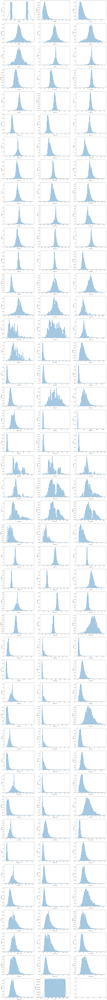

In [ ]:

fig, axes = plt.subplots(nrows=44
                         , ncols=3,figsize=(25,250))
for i, column in enumerate(sample_df.iloc[:,7:].columns):
    sns.distplot(sample_df[column],ax=axes[i//3,i%3])


- Looking at the Distribution of dataset it seems that most of the features are Normally distributed (Standardized) and they are mean/Zero reverted. 

- Looking at the Histogram of features from it seems that dataset has has been provided has features that are Zero reverted.

  


# Weight


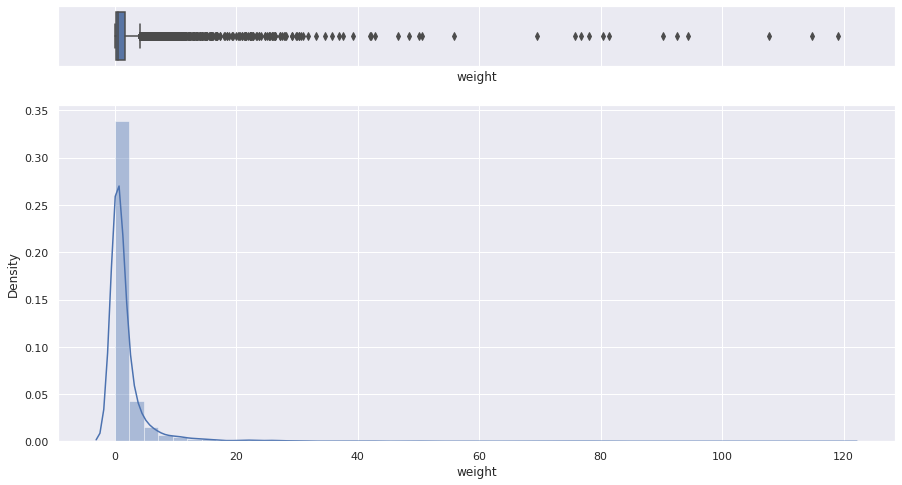

In [ ]:
sns.set(rc={'figure.figsize':(15,8)})
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)})

sns.boxplot(sample_df["weight"], ax=ax_box)
sns.distplot(sample_df["weight"], ax=ax_hist)


 - From above chart we can see that lot of trades in day 0 has zero weight.thats why median is also close to zero. Another thing to note here is that it is given in data description is that competition host  has introduced zero in the dataset and i am quoting them here as well
     - "Trades with weight = 0 were intentionally included in the dataset for completeness, although such trades will not contribute towards the scoring evaluation"

# Resp 



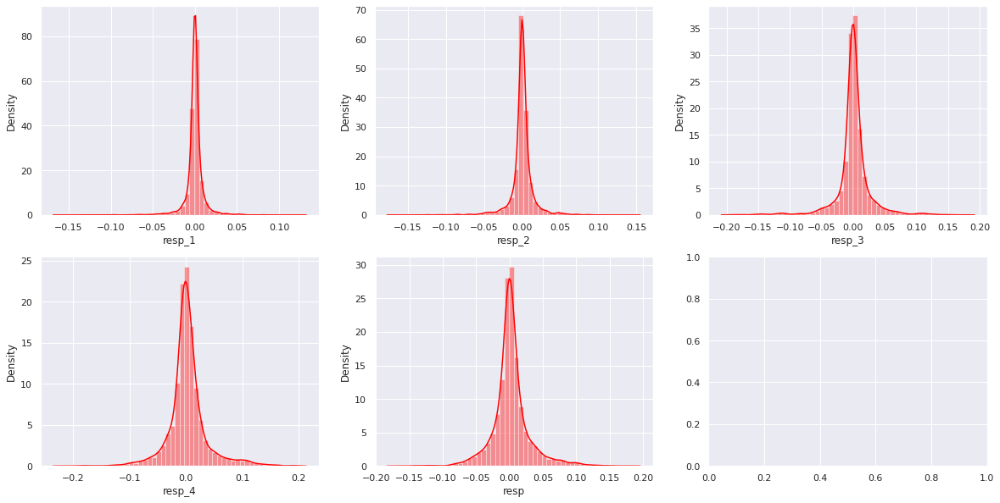

In [ ]:
resp_df = sample_df.iloc[:,2:7]
fig, axes = plt.subplots(nrows=2
                         , ncols=3,figsize=(20,10))
for i, column in enumerate(resp_df.columns):
    sns.distplot(sample_df[column],ax=axes[i//3,i%3],color='red')

We can see from the distribution is that all 5 of these resp features are perfectly zero reverted. 
  - "The only response variable in evaluation is Resp (see the evaluation metric), Resp1 - Resp4 only exists in the train.csv, they are correlated to Resp but not exactly the same (see the data description). They are provided just in case some people want some alternative objective metrics to regularize their model training."
  

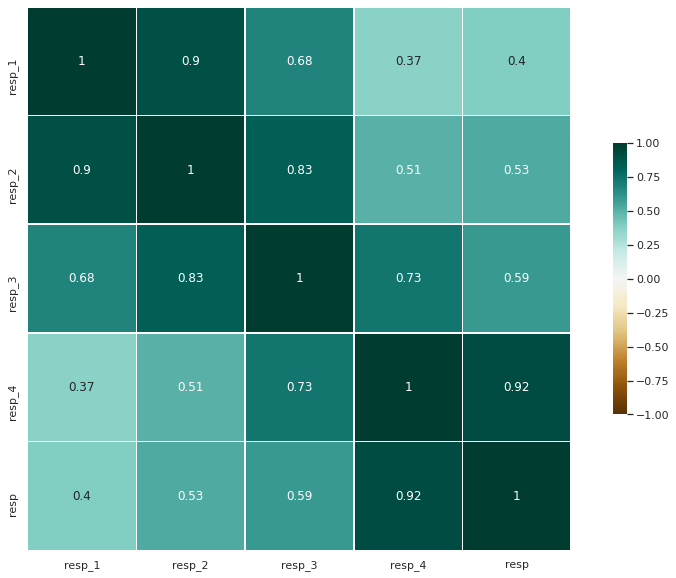

In [ ]:
corr = resp_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 10))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

*   From this correlation chart we can see that feature resp_4 has the highest positive correlation with feature resp and feature resp_1 has least positive correlation with feature resp.

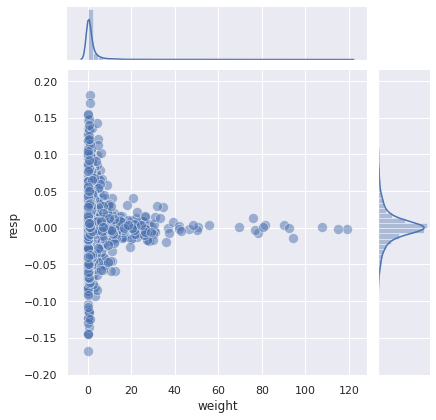

In [ ]:
g = sns.JointGrid(data=sample_df, x="weight", y="resp")
g.plot_joint(sns.scatterplot, s=100, alpha=.5)
g.plot_marginals(sns.distplot, kde=True)

   -  From chart of day one weights above we can see that some trades have weight close to 120 thats why i decided to divide these trades in to three categories that are less than 40 , Equal to 40 and less than 80 and trades having weight greater than 80. i will look into these in later sections.

In [ ]:
conditions = [
    (sample_df['weight'] <= 40),
    (sample_df['weight'] > 40) & (sample_df['weight'] <= 80),
    (sample_df['weight'] > 80) 
    ]
values = ['tier_3', 'tier_2', 'tier_1']
sample_df['weight_tier'] = np.select(conditions, values)


# Meta Data
- tags in meta data represent some kind of concepts are used to create these features.


# Hypothesis
- features made from same concepts will have same behaviour in accordance to resp values and features will have correlation between them as well.



In [ ]:
# meta_data_t.head()
categories =  defaultdict(list)

for columns  in meta_data.columns[1:]:
        categories[f'{columns}'].append(meta_data.query(f'{columns} == True')['feature'].to_list())


In [ ]:
categories

defaultdict(list,
            {'tag_0': [['feature_9',
               'feature_10',
               'feature_19',
               'feature_20',
               'feature_29',
               'feature_30',
               'feature_56',
               'feature_73',
               'feature_79',
               'feature_85',
               'feature_91',
               'feature_97',
               'feature_103',
               'feature_109',
               'feature_115',
               'feature_122',
               'feature_123']],
             'tag_1': [['feature_15',
               'feature_16',
               'feature_25',
               'feature_26',
               'feature_35',
               'feature_36',
               'feature_59',
               'feature_76',
               'feature_82',
               'feature_88',
               'feature_94',
               'feature_100',
               'feature_106',
               'feature_112',
               'feature_118',
               'feature_12

# Group Tag 0
* This Group included Tag 0 features that are created with 1st  concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_0_df = sample_df[[*categories['tag_0'][0]]]

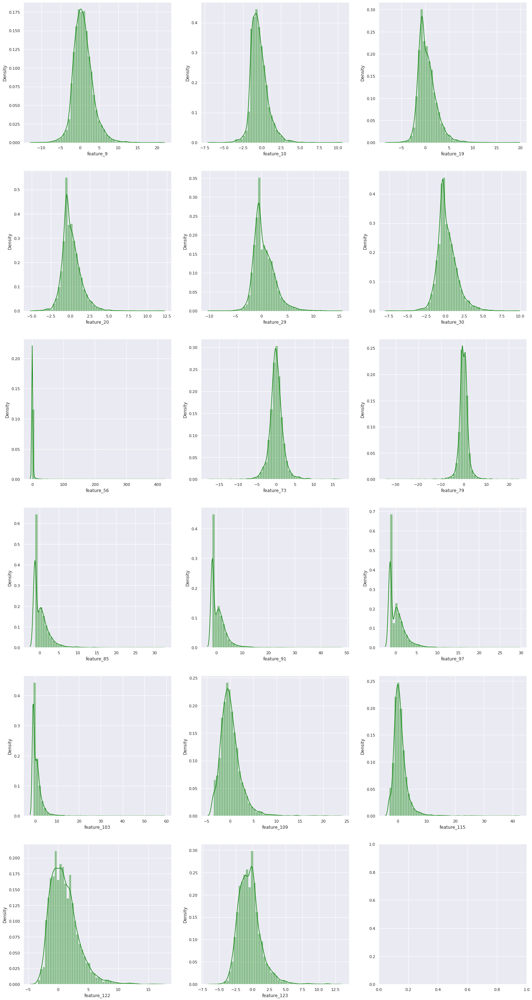

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=3,figsize=(25,50))
for i, column in enumerate(tag_0_df.columns):
    sns.distplot(tag_0_df[column],ax=axes[i//3,i%3],color='Green')

# Correlation Analysis of Group 0

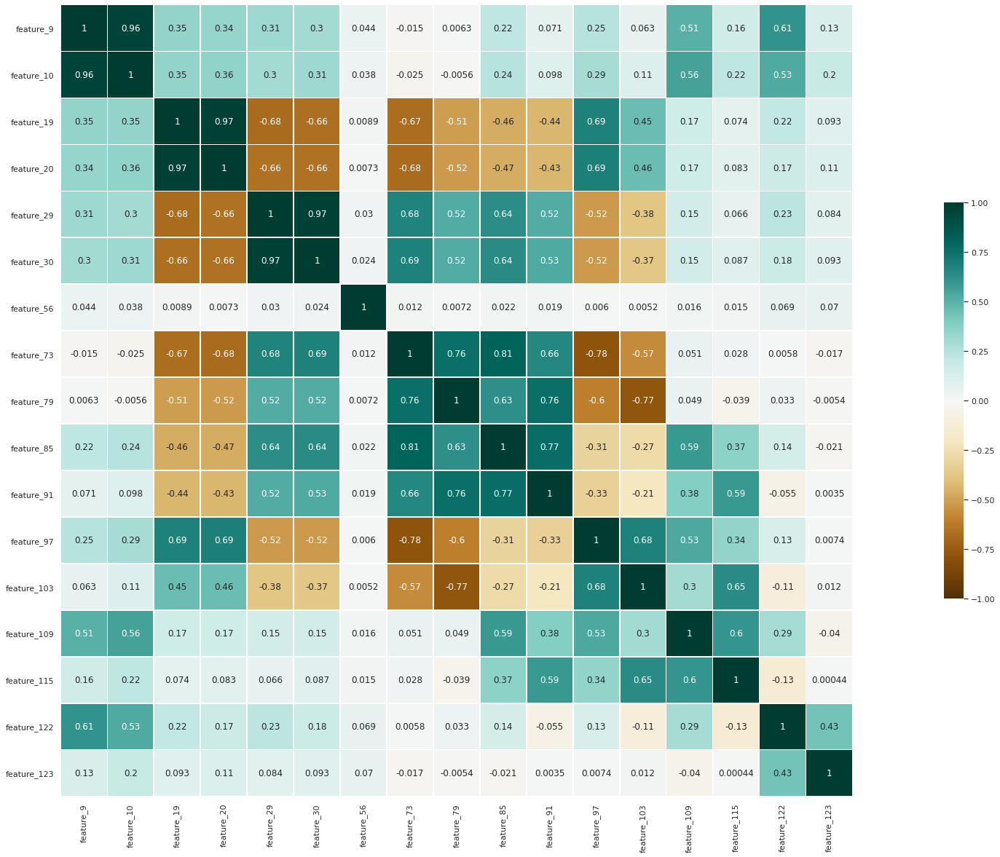

In [ ]:
corr = tag_0_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(45, 20))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* Feature 56 has no correlation with any other features 

* 9,10 & 19, 20 have strong correlation with each other 

# Linear Regression Analysis of Group 0
  

In [ ]:
from scipy import stats
def r2(x, y):
    return stats.pearsonr(x, y)[0] ** 2

In [ ]:
import seaborn as sns
class myjoint(sns.JointGrid):
    def __init__(self, x, y, data=None,height=7, ratio=5, space=.2,
                 dropna=True, xlim=None, ylim=None, size=None):
        super(myjoint, self).__init__(x, y, data,height, ratio, space,
                 dropna, xlim, ylim, size)
        plt.close(2)
        # Set up the subplot grid
        self.ax_joint = f.add_subplot(gs[1:, :-1])
        self.ax_marg_x = f.add_subplot(gs[0, :-1], sharex=self.ax_joint)
        self.ax_marg_y = f.add_subplot(gs[1:, -1], sharey=self.ax_joint)

        # Turn off tick visibility for the measure axis on the marginal plots
        plt.setp(self.ax_marg_x.get_xticklabels(), visible=False)
        plt.setp(self.ax_marg_y.get_yticklabels(), visible=False)

feature_9 R2 score:0.0014
feature_10 R2 score:0.0007
feature_19 R2 score:0.0368
feature_20 R2 score:0.0215
feature_29 R2 score:0.0481
feature_30 R2 score:0.0286
feature_56 R2 score:0.0003
feature_73 R2 score:0.0139
feature_79 R2 score:0.0183
feature_85 R2 score:0.0161
feature_91 R2 score:0.0155
feature_97 R2 score:0.0082
feature_103 R2 score:0.0112
feature_109 R2 score:0.0015
feature_115 R2 score:0.0
feature_122 R2 score:0.0004
feature_123 R2 score:0.0001


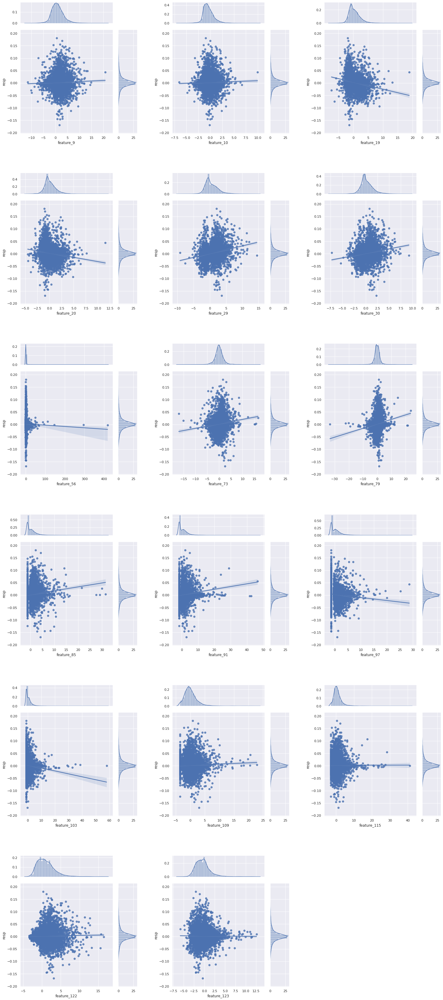

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 3, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_0_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
    r2_score = r2(x=sample_df[column].values,y=sample_df["resp"].values)
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Feature 115 has lowest R2 score of 0.0 in this tag/Group of features.
* Features 29 has highest R2 score in this tag of 0.0484 and feature 19 has second highest R2 score of 0.0368.
* Positive Corr: 29, 30, 73, 79
* Negative corr: 19, 29, 103

# Group  Tag 1
*    These features that are in tag 1 belong to same group due to same concepts that were used to create them. There are some features are using more than one concepts/tags.

In [ ]:
tag_1_df = sample_df[[*categories['tag_1'][0]]]

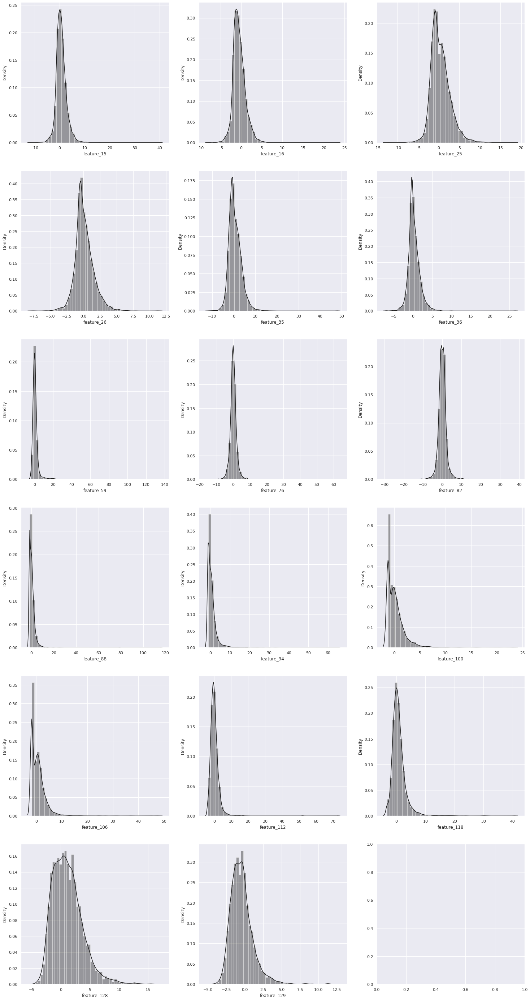

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=3,figsize=(25,50))
for i, column in enumerate(tag_1_df.columns):
    sns.distplot(tag_1_df[column],ax=axes[i//3,i%3],color='k')

# Correlation Analysis of Group 1

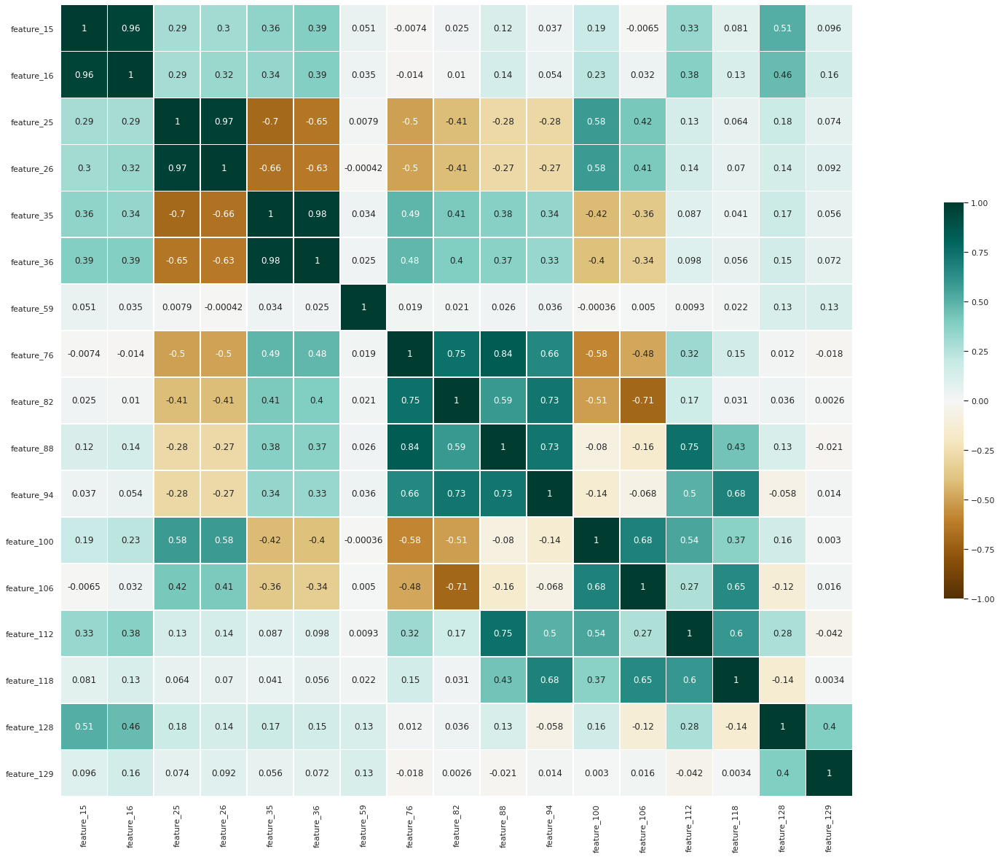

In [ ]:
corr = tag_1_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(45, 20))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

# Linear Regression Analysis of Group 1  
   

feature_15 R2 score:0.0016
feature_16 R2 score:0.0009
feature_25 R2 score:0.0483
feature_26 R2 score:0.0298
feature_35 R2 score:0.0524
feature_36 R2 score:0.0315
feature_59 R2 score:0.0007
feature_76 R2 score:0.0093
feature_82 R2 score:0.0136
feature_88 R2 score:0.0071
feature_94 R2 score:0.0067
feature_100 R2 score:0.0049
feature_106 R2 score:0.0111
feature_112 R2 score:0.0009
feature_118 R2 score:0.0001
feature_128 R2 score:0.0002
feature_129 R2 score:0.0002


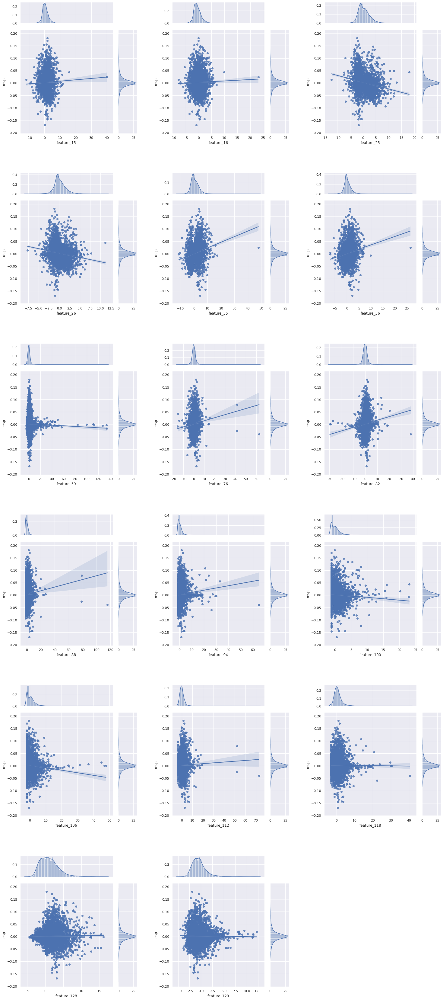

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 3, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_1_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
#     plt.xlabel(f"{column}")
# f.tight_layout()


* Feature 115 has lowest R2 score of 0.0 in this tag/Group of features.
* Features 29 has highest R2 score in this tag of 0.0484 and feature 19 has second highest R2 score of 0.0368.
* Positive Corr: 29, 30, 73, 79
* Negative corr: 19, 29, 103

#  Group Tag 2
   - These features that are in tag 2 belong to same group due to same concepts that were used to create them. There are some features are using more than one concepts/tags.

In [ ]:
tag_2_df = sample_df[[*categories['tag_2'][0]]]

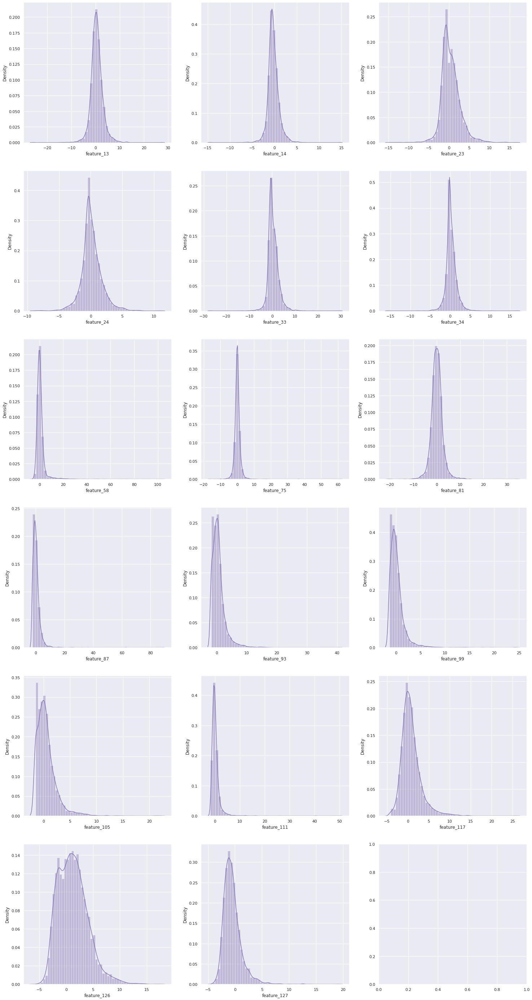

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=3,figsize=(25,50))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_2_df.columns):
    sns.distplot(tag_2_df[column],ax=axes[i//3,i%3],color='m')

# Correlation Analysis of Group 2

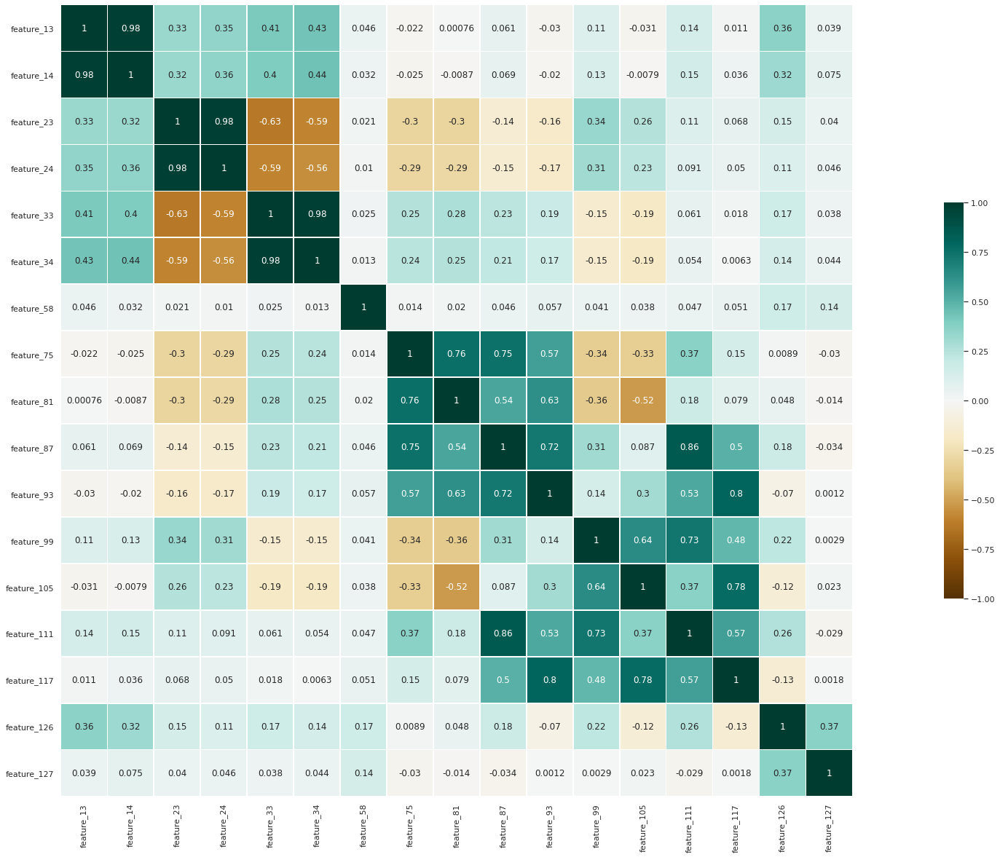

In [ ]:
corr = tag_2_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(45, 20))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

# Linear Regression Analysis of Group 2

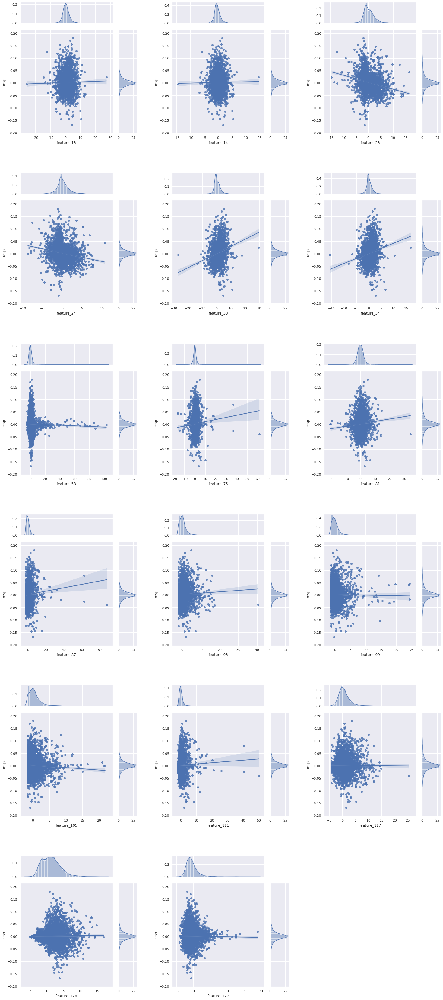

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 3, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_2_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* in 6 features we have highest correlation with group of two for example features 13 ,14 have highest correlation with each other then same pattern goes on till feature 58( same pattern as feature 56,57,59 in above categories). then pattern start again.

* Positive relation between features 33,34,87,11 and resp(target variable) can be seen in Linear Regression analysis above.
* Negative relation between featuers 23,24 and resp(target variable) can be seen in above charts.
* Features 23 has highest R2 score in this tag of 0.0542 and feature 33 has second highest R2 score of 0.054.
* Feature 117 has lowest R2 score of 0.0001 in this tag/Group of features.

#  Group Tag 3
* These features that are in tag 3 belong to same group due to same concepts that were used to create them. There are some features are using more than one concepts/tags.

In [ ]:
tag_3_df = sample_df[[*categories['tag_3'][0]]]

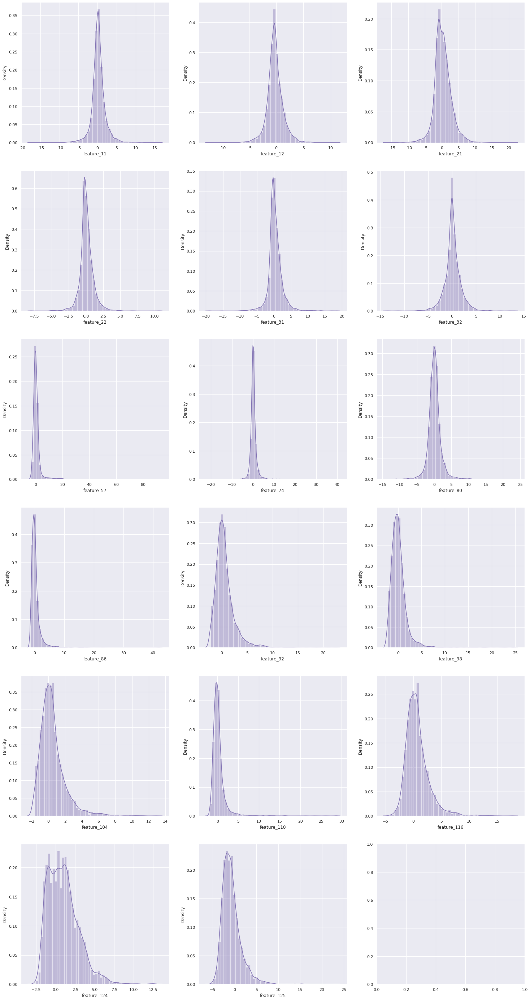

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=3,figsize=(25,50))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_3_df.columns):
    sns.distplot(tag_3_df[column],ax=axes[i//3,i%3],color='m')

# Correlation Analysis of Group 3

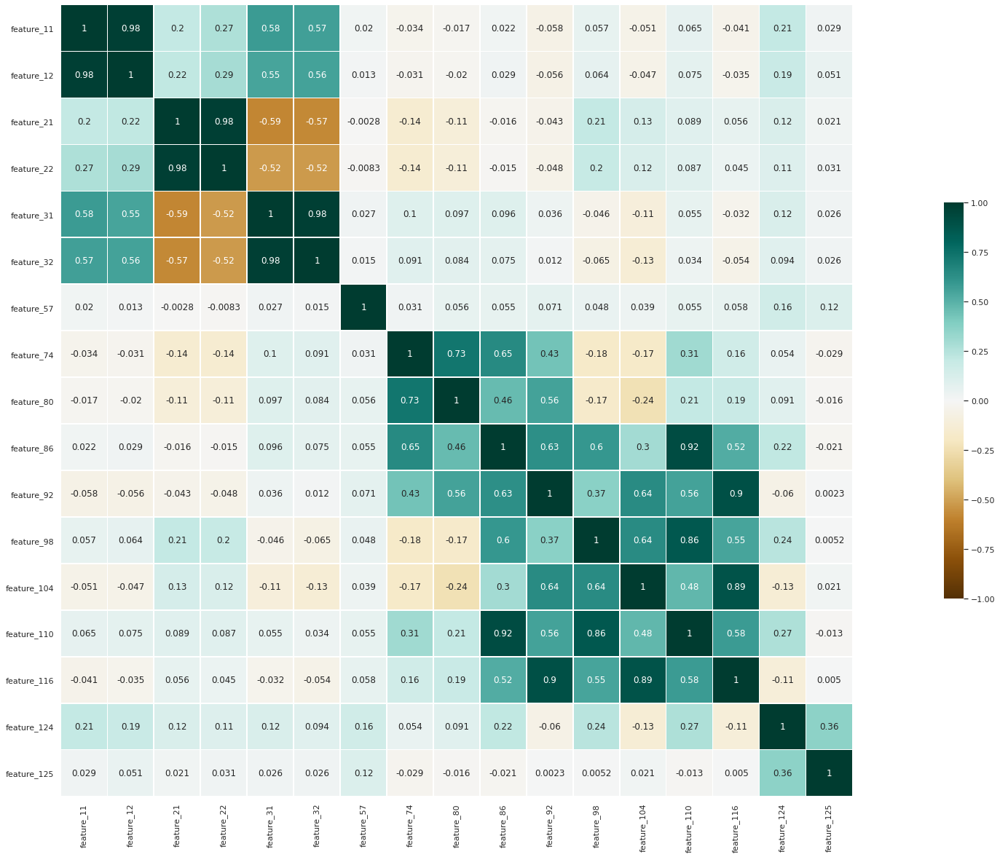

In [ ]:
corr = tag_3_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(45, 20))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   - Same correlation pattern in group of two features that we have seen in above Groups. Just like above odd  features before, 57 is has no or very little correlation with other features in this Group same behaviour that we have seen before and then after feature 57  that correlation pattern start again.

## Linear Regression Analysis of Group 3   
 

feature_11 R2 score:0.0097
feature_12 R2 score:0.0065
feature_21 R2 score:0.0481
feature_22 R2 score:0.0298
feature_31 R2 score:0.0599
feature_32 R2 score:0.044
feature_57 R2 score:0.0007
feature_74 R2 score:0.0011
feature_80 R2 score:0.0005
feature_86 R2 score:0.0015
feature_92 R2 score:0.0
feature_98 R2 score:0.0
feature_104 R2 score:0.0014
feature_110 R2 score:0.0008
feature_116 R2 score:0.0004
feature_124 R2 score:0.0001
feature_125 R2 score:0.0004


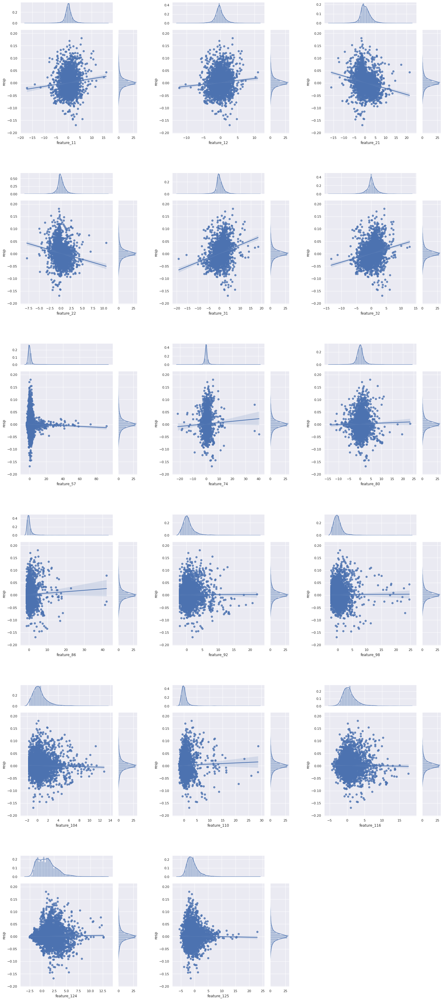

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 3, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_3_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print((f"{column} R2 score:{round(r2_score,4)}"))
# f.tight_layout()


* Positive relation between features 11,12,31,32 and resp(target variable) can be seen in Linear Regression analysis above.
* Negative relation between featuers 21,22 and resp(target variable) can be seen in above charts.
* Feature 31 has highest R2 score in this tag of 0.0599 and feature 21 has second highest R2 score of 0.0481.
* Features 92,98 has lowest R2 score of 0.0 in this tag/Group of features.

# Group tag 4
* This Group included Tag 4 features that are created with 5th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_4_df = sample_df[[*categories['tag_4'][0]]]

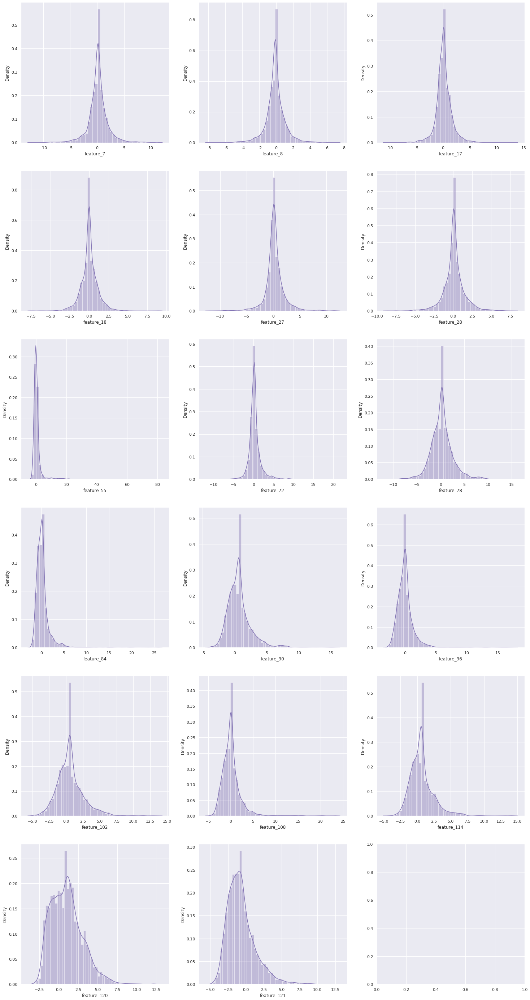

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=3,figsize=(25,50))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_4_df.columns):
    sns.distplot(tag_4_df[column],ax=axes[i//3,i%3],color='m')

# Correlaion Analysis of Group 4

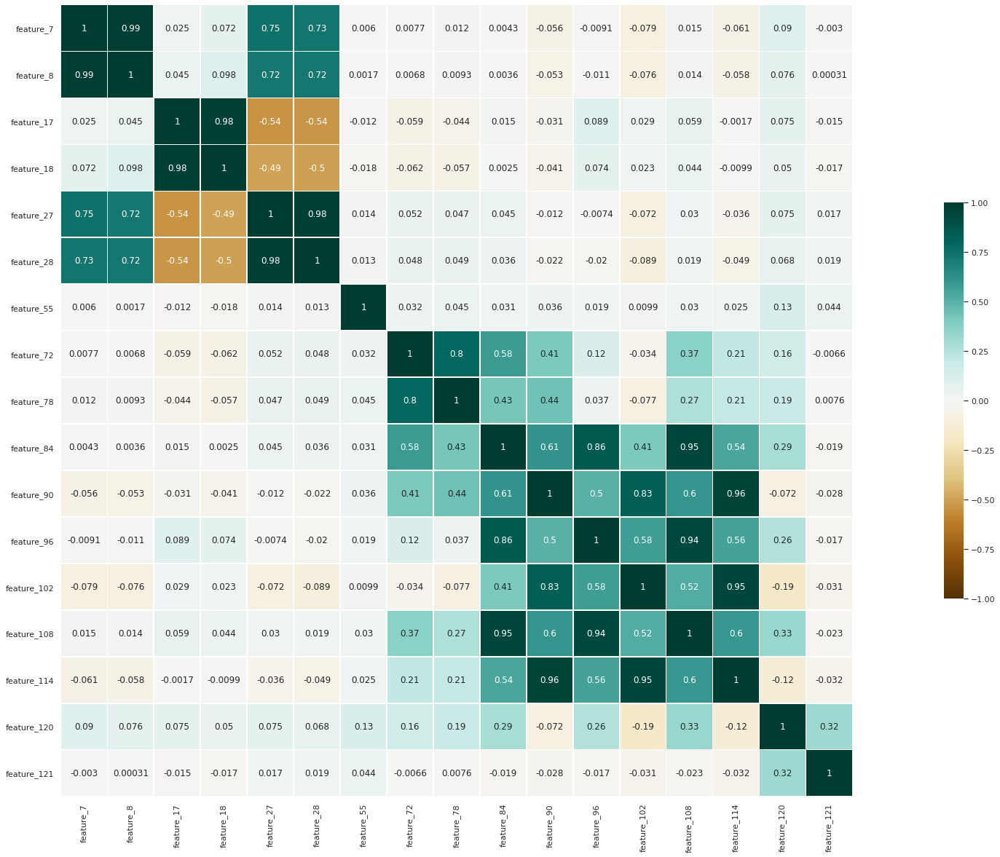

In [ ]:
corr = tag_4_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(45, 20))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   - Same Correlation Pattern as i have described above. first 6 features have correlation with each other but not with other then we have feature 55 that have no correlation with any feature,and remaining 10 features have correlation with each other but not with any other feature.

#  Linear Regression Analysis of Group 4   
   - Here i have tried to find out between different features of Tag 4 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 4 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 4 category and on y axis resp is used.
   

feature_7 R2 score:0.015
feature_8 R2 score:0.0112
feature_17 R2 score:0.0542
feature_18 R2 score:0.0388
feature_27 R2 score:0.0632
feature_28 R2 score:0.048
feature_55 R2 score:0.0006
feature_72 R2 score:0.0001
feature_78 R2 score:0.0001
feature_84 R2 score:0.0004
feature_90 R2 score:0.0005
feature_96 R2 score:0.0005
feature_102 R2 score:0.0004
feature_108 R2 score:0.0007
feature_114 R2 score:0.0005
feature_120 R2 score:0.0
feature_121 R2 score:0.0008


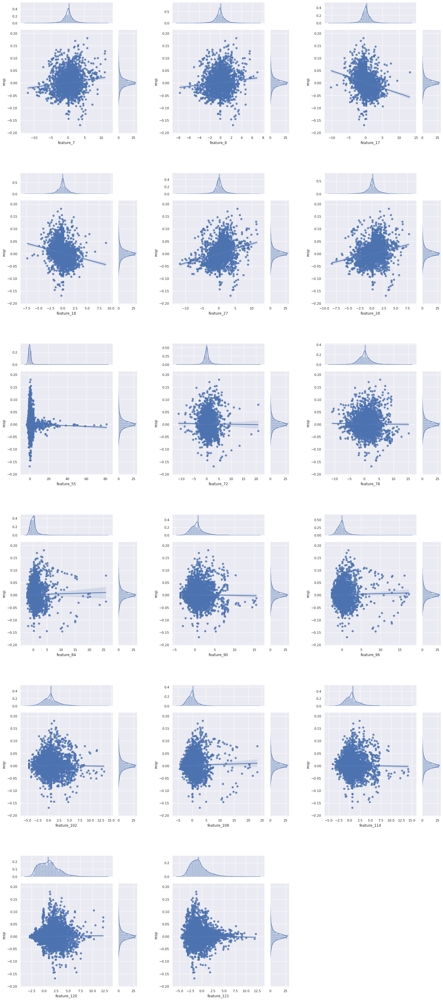

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 3, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_4_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Feature 17,18,27,28 has different distribution in above charts than any  other features in this group. Most of the features in this Group are normally distributed. But shape of these charts is a lot different.These features have relatively high R2 Score than any other features in this group.
* Positive relation between features 27,28,7,8 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between featuers 17,18 and resp(target variable) can be seen in above charts.
* Features 27 has highest **R2 score** in this tag of 0.0638 and it is the highest i have seen so far.feature 17 has second highest **R2 score** of 0.0542.
* Feature 120 has lowest **R2 score** of 0.0001 in this tag/Group of features.  
 


# Group Tag 5
* This Group included Tag 5 features that are created with 6th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_5_df = sample_df[[*categories['tag_5'][0]]]

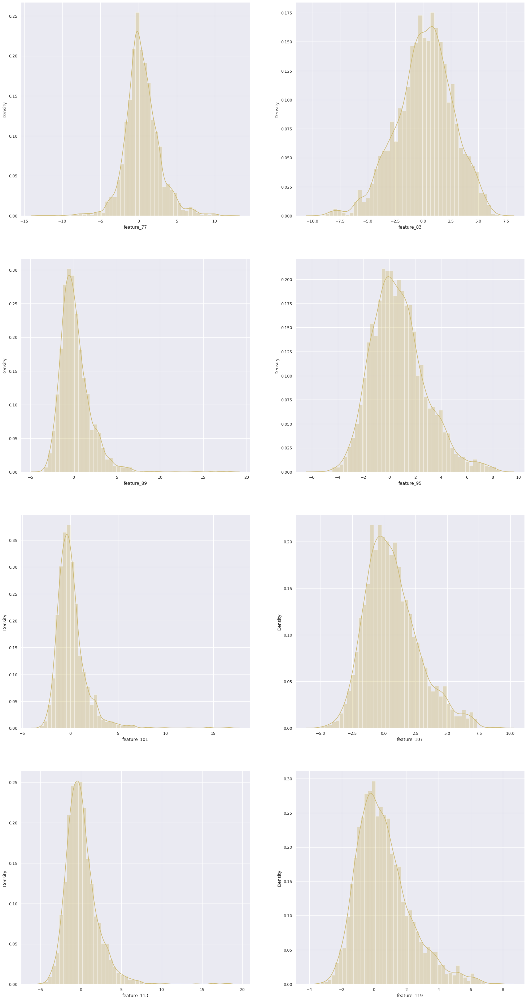

In [ ]:
fig, axes = plt.subplots(nrows=4
                         , ncols=2,figsize=(25,50))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_5_df.columns):
    sns.distplot(tag_5_df[column],ax=axes[i//2,i%2],color='y')

* From the chart above we can see that only 8 features belong to this category.
* Groups before this have more than 16 features but this one has only 8.
* Again all the features here are zero reverted.

# Correlation Analysis of Group 5

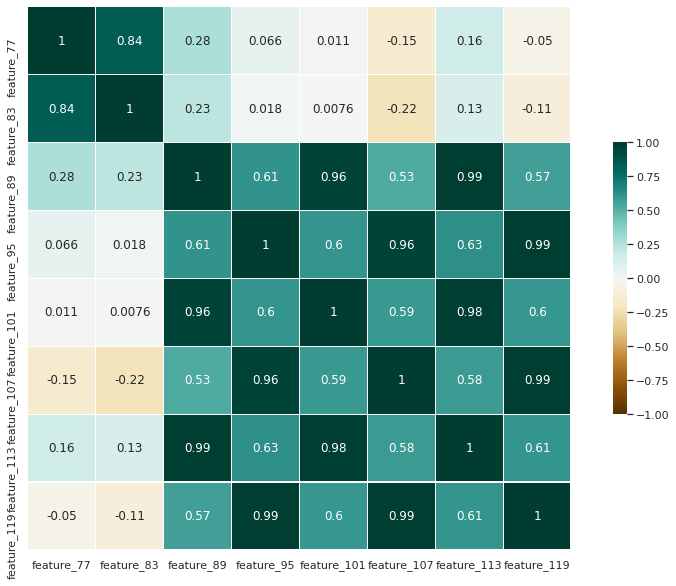

In [ ]:
corr = tag_5_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 10))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* Same correation pattern can be seen here as well.
* first two features have strong correlation with each other and have no significant correlation with any other features.
* last 6 features has strong correlation relation with each other and does not have significant correlation first two features.

# Linear Regression Analysis of Group 5  
   
   

feature_77 R2 score:0.0018
feature_83 R2 score:0.0005
feature_89 R2 score:0.0059
feature_95 R2 score:0.0006
feature_101 R2 score:0.0091
feature_107 R2 score:0.0011
feature_113 R2 score:0.0074
feature_119 R2 score:0.0008


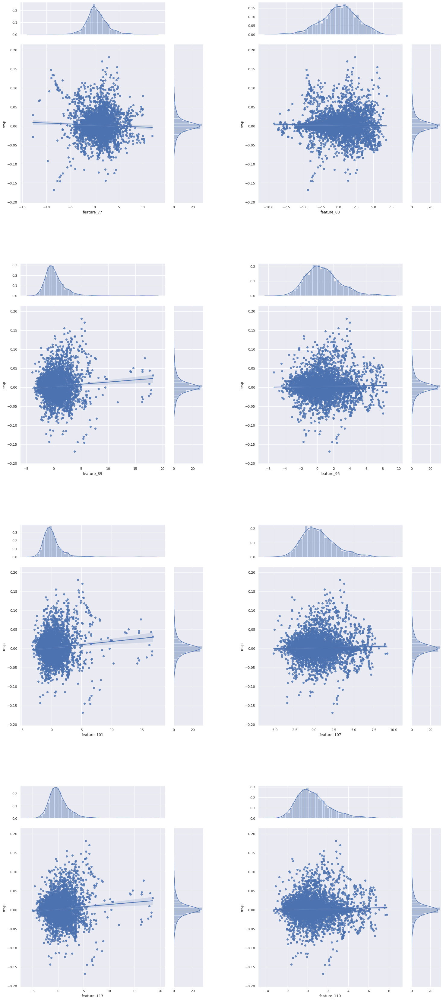

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(4, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_5_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()




* Positive relation between features 89,101,113 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* No Negative relation between features and resp(target variable) has seen in above charts.
* Features 101 has highest **R2 score** in this tag of 0.009 and feature 113 has second highest **R2 score** of 0.0074.
* Feature 83 has lowest **R2 score** of 0.0005 in this tag/Group of features.  
 


# Group Tag 6
* This Group included Tag 6 features that are created with 7th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_6_df = sample_df[[*categories['tag_6'][0]]]

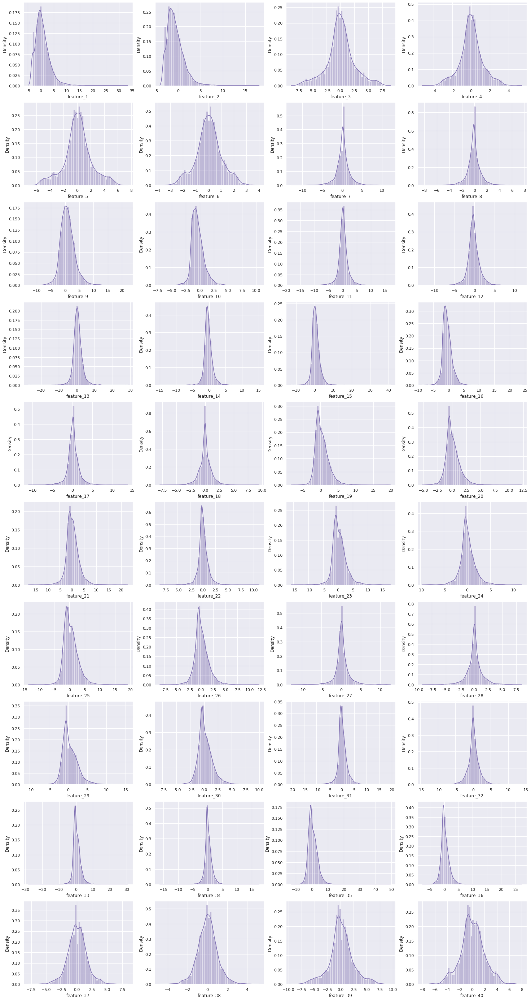

In [ ]:
fig, axes = plt.subplots(nrows=10
                         , ncols=4,figsize=(25,50))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_6_df.columns):
    sns.distplot(tag_6_df[column],ax=axes[i//4,i%4],color='m')

* This Group/ tag has highest number of features so far i have seen.
* Previous categories had 17 features and one had 8 features.
By looking at the highest number of features in a category leds me to my another hypothesis is that



# Hypothesis
> Highest Numbers of features in a category can mean that concepts that are used here to create these features are lot more useful to explain this commidity's behaviour.


# Correlation Analysis of Group 6

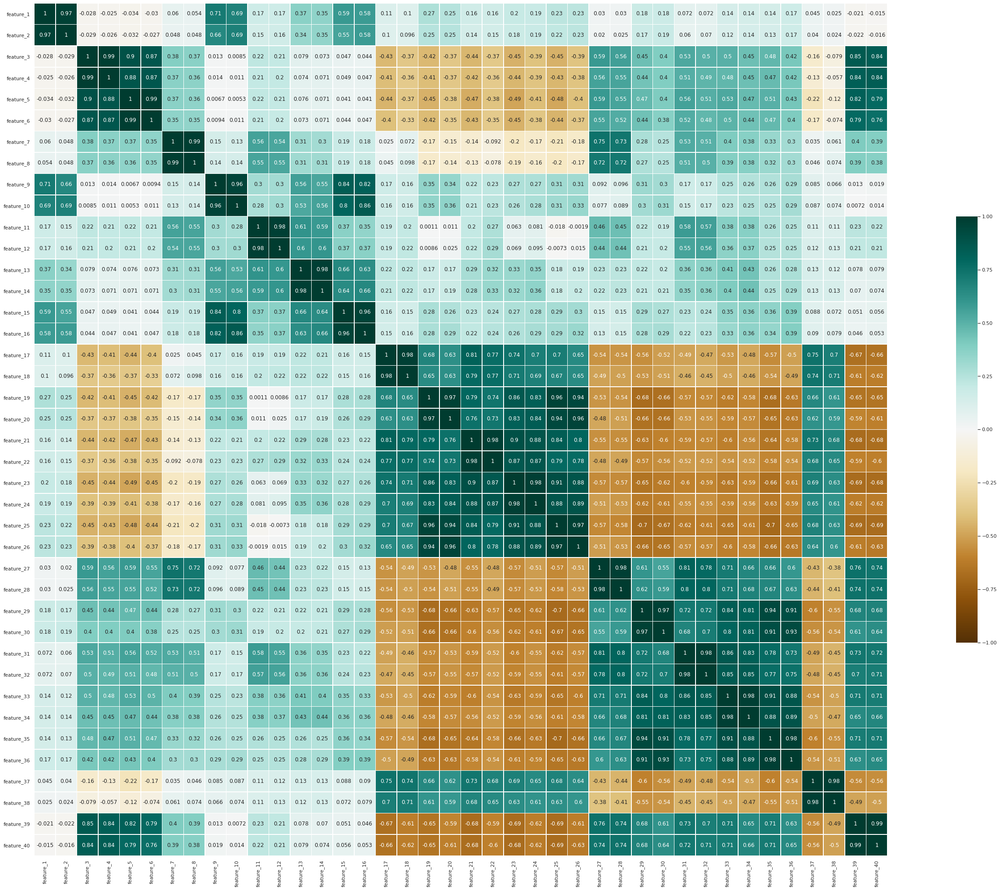

In [ ]:
corr = tag_6_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(55, 35))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* Same Positive correlation pattern in group of two features can be seen here as well.
* Then we can see Positive correlation  from feature 17 to feature 26 among features but these features are negatively correlated with features that are net to them.( From 27 to 36).
* same behaviour of positive correlation and negative correlation can be seen for last four features as well.

# Linear Regression Analysis of Group 6   
   - Here i have tried to find out between different features of Tag 6 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 6 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 6 category and on y axis resp is used.
   

feature_1 R2 score:0.0022
feature_2 R2 score:0.0015
feature_3 R2 score:0.076
feature_4 R2 score:0.0681
feature_5 R2 score:0.0759
feature_6 R2 score:0.0653
feature_7 R2 score:0.015
feature_8 R2 score:0.0112
feature_9 R2 score:0.0014
feature_10 R2 score:0.0007
feature_11 R2 score:0.0097
feature_12 R2 score:0.0065
feature_13 R2 score:0.0004
feature_14 R2 score:0.0001
feature_15 R2 score:0.0016
feature_16 R2 score:0.0009
feature_17 R2 score:0.0542
feature_18 R2 score:0.0388
feature_19 R2 score:0.0368
feature_20 R2 score:0.0215
feature_21 R2 score:0.0481
feature_22 R2 score:0.0298
feature_23 R2 score:0.0542
feature_24 R2 score:0.0365
feature_25 R2 score:0.0483
feature_26 R2 score:0.0298
feature_27 R2 score:0.0632
feature_28 R2 score:0.048
feature_29 R2 score:0.0481
feature_30 R2 score:0.0286
feature_31 R2 score:0.0599
feature_32 R2 score:0.044
feature_33 R2 score:0.0517
feature_34 R2 score:0.0337
feature_35 R2 score:0.0524
feature_36 R2 score:0.0315
feature_37 R2 score:0.0568
feature_38 R2 

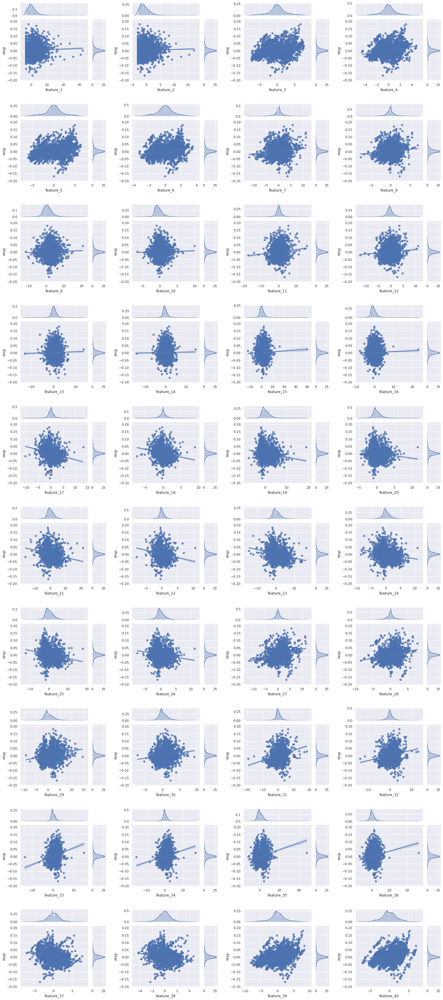

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(10, 4, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_6_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* The pattern with strong correlation in group of two features can be seen here.
* First two features has strong correlation with each other. Then next 4 features have strong positive correlation with each other but some features have negative correlation and positive correlation with last 25 features.
* By looking at the features correlation it validates my Hypothesis about strong correlation among features that are created with similar concept.
* ****This Groups has one of the Highest  Number of features as well as Highest  R2 Score as well****.
* Positive relation between features 39,40,33,34,35,36,29,30,31,32,27,28 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between featuers 37,38,26,25,17,18,19,20,21,22,23,24,3,4,5,6,7,12,11 and resp(target variable) can be seen in above charts.
* Features 39 has highest **R2 score** in this tag of 0.1344 and feature 40 has second highest **R2 score** of 0.1099.
* Feature 13 has lowest **R2 score** of 0.0004 in this tag/Group of features.  


   > By Looking at the Highest Values of R2 score for this group this validates my **Hypothesis** that i have mentioed above.
 

# Group tag 7

* This Group included Tag 7 features that are created with 6th similar concept another thing these features that these features are present in tag 6 as well so these features are created from combination of similar concept.


In [ ]:
tag_7_df = sample_df[[*categories['tag_7'][0]]]

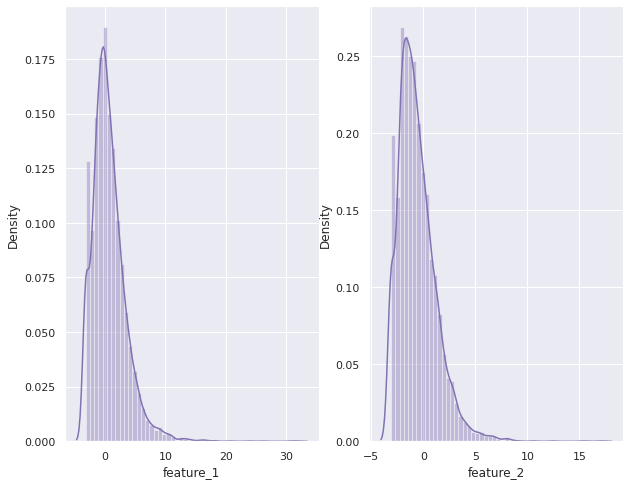

In [ ]:
fig, axes = plt.subplots(nrows=1
                         , ncols=2,figsize=(10,8))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_7_df.columns):
    sns.distplot(tag_7_df[column],ax=axes[i%2],color='m')

# Correlation Analysis of Group 7

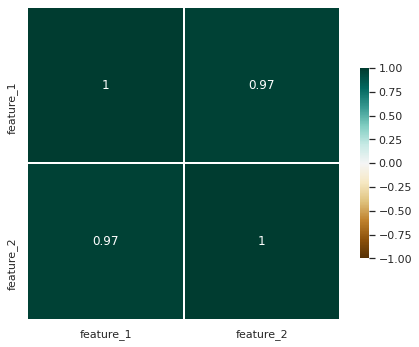

In [ ]:
corr = tag_7_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(7, 7))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* From above chart we can see that there is strong positive correlation among these two features.

   # Linear Regression Analysis of Group 7
   - Here i have tried to find out between different features of Tag 7 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 7 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 7 category and on y axis resp is used.
   

feature_1 R2 score:0.0022
feature_2 R2 score:0.0015


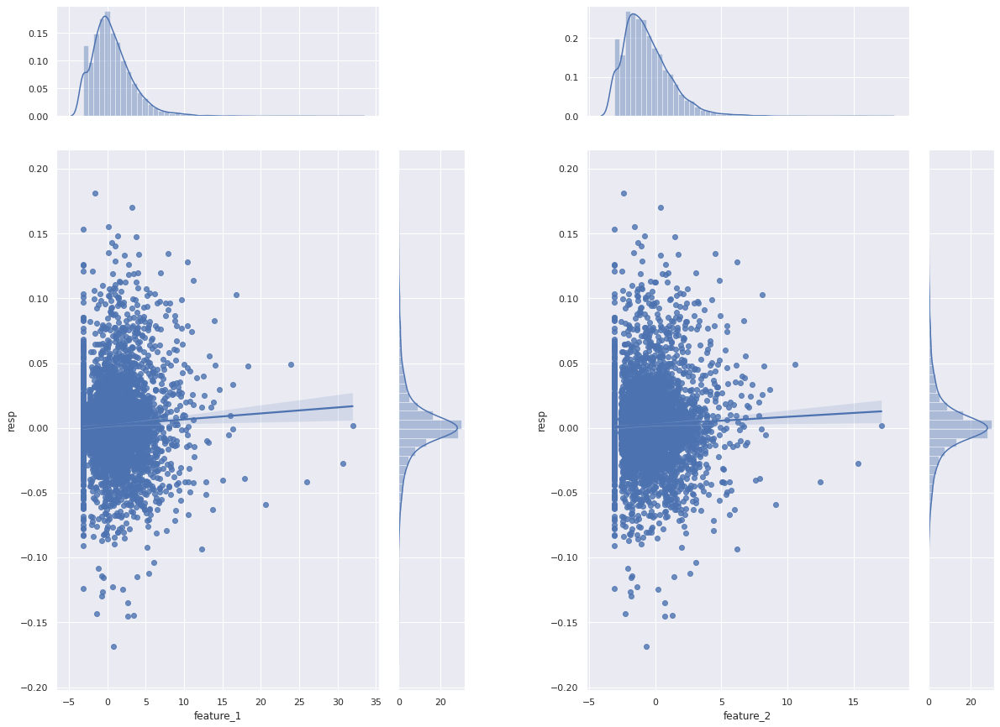

In [ ]:

ratio=4
f = plt.figure(figsize=(20,15))
outer_grid = gridspec.GridSpec(1, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_7_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Strong Correlation can be seen in these tow features. 
* These two features are also present in Tag 6 as well.it means that two concept  can be used together to create combination of  features.
* Both features has some what Neutral Relationship with Resp  Values as seen in above charts.
* feature 1 has higest **R2 Score** in this Group of 0.0022.

#  Group Tag 8
* This Group included Tag 8 features that are created with 9th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_8_df = sample_df[[*categories['tag_8'][0]]]

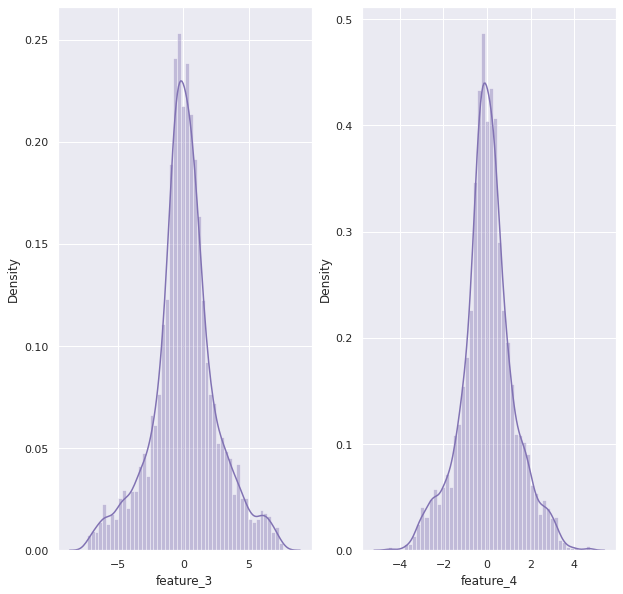

In [ ]:
fig, axes = plt.subplots(nrows =1
                         , ncols=2,figsize=(10,10))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_8_df.columns):
    sns.distplot(tag_6_df[column],ax=axes[i%2],color='m')

# Correlation Analysis of Group 8

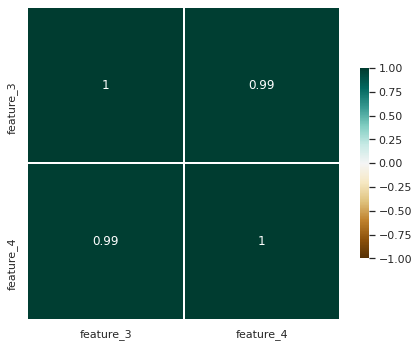

In [ ]:
corr = tag_8_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(7, 7))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* Strong positive correlation again in this group validates my Hypothesis as well.

 # Linear Regression Analysis of Group 8  

   

feature_3 R2 score:0.076
feature_4 R2 score:0.0681


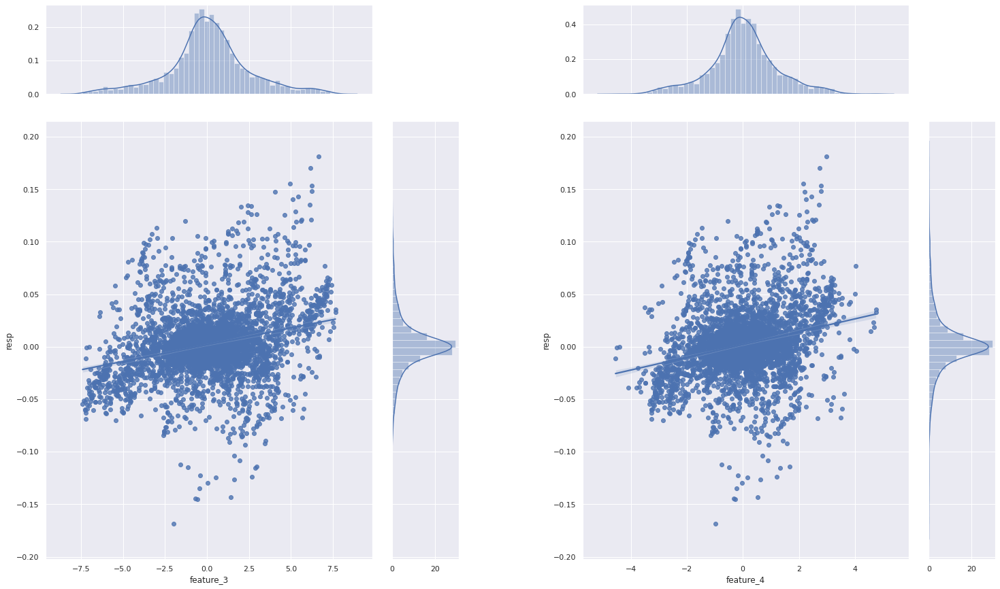

In [ ]:

ratio=4
f = plt.figure(figsize=(25,15))
outer_grid = gridspec.GridSpec(1, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_8_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Strong positive correlation exist in both these features.
* There exist is a relationship in resp values and these two features. in above chart i have fitted a linear regression model to show it.
* Positive relation between features 3,4 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Features 3 has highest **R2 score** in this tag of 0.076.
* Feature 4 has lowest **R2 score** of 0.0681 in this tag/Group of features.  
 

# Group Tag 9
* This Group included Tag 9 features that are created with 10th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_9_df = sample_df[[*categories['tag_9'][0]]]

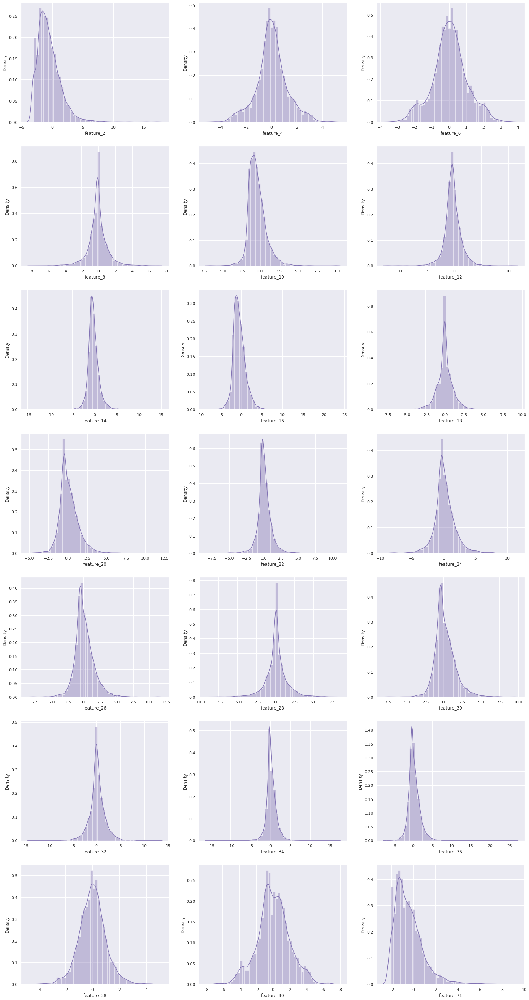

In [ ]:
fig, axes = plt.subplots(nrows=7
                         , ncols=3,figsize=(25,50))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_9_df.columns):
    sns.distplot(tag_9_df[column],ax=axes[i//3,i%3],color='m')

# Correlation Analysis of Group 9

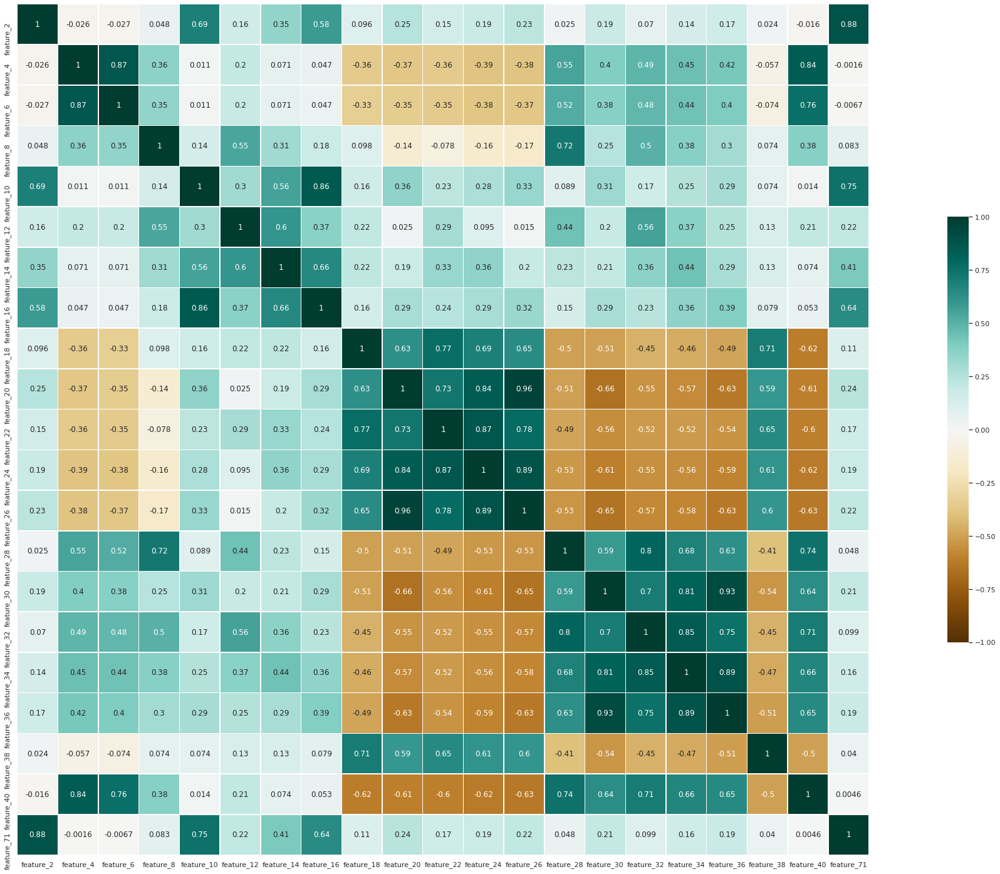

In [ ]:
corr = tag_9_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(45, 25))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

# Linear Regression Analysis of Group 9   

   

feature_2 R2 score:0.0015
feature_4 R2 score:0.0681
feature_6 R2 score:0.0653
feature_8 R2 score:0.0112
feature_10 R2 score:0.0007
feature_12 R2 score:0.0065
feature_14 R2 score:0.0001
feature_16 R2 score:0.0009
feature_18 R2 score:0.0388
feature_20 R2 score:0.0215
feature_22 R2 score:0.0298
feature_24 R2 score:0.0365
feature_26 R2 score:0.0298
feature_28 R2 score:0.048
feature_30 R2 score:0.0286
feature_32 R2 score:0.044
feature_34 R2 score:0.0337
feature_36 R2 score:0.0315
feature_38 R2 score:0.0368
feature_40 R2 score:0.1099
feature_71 R2 score:0.0023


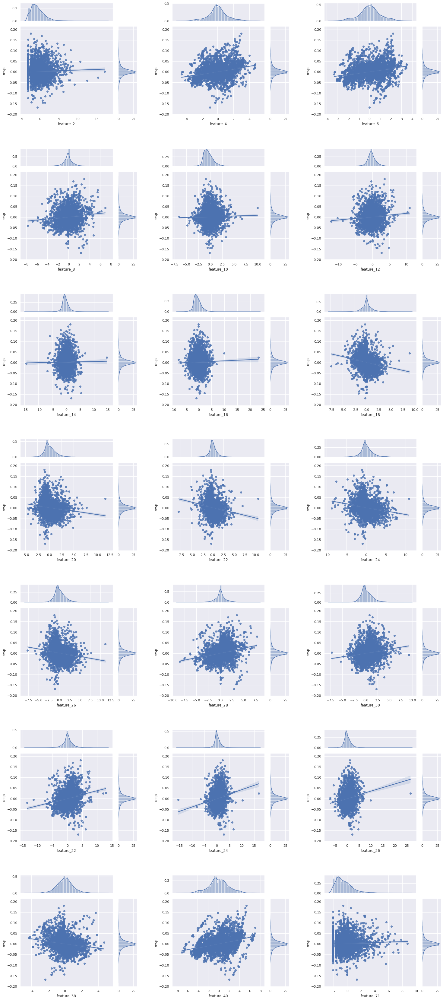

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(7, 3, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_9_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Same relation that we have seen in previous tag between resp and features can be seen here in features 6 and 40.
* Feature 2 that is also present in Tag 7 has direct relation (positive correlation) with feature 71 that is present in this category.
* Positive relation between features 40,36,34,32,4,6,30,28 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between featuers 20,22,24,26,38 and resp(target variable) can be seen in above charts.
* Features 40 has highest **R2 score** in this tag of 0.1099 and feature 4 has second highest **R2 score** of 0.0681.
* Feature 14 has lowest **R2 score** of 0.0001 in this tag/Group of features.  
 

# Group Tag 10
* This Group included Tag 10 features that are created with 11th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_10_df = sample_df[[*categories['tag_10'][0]]]

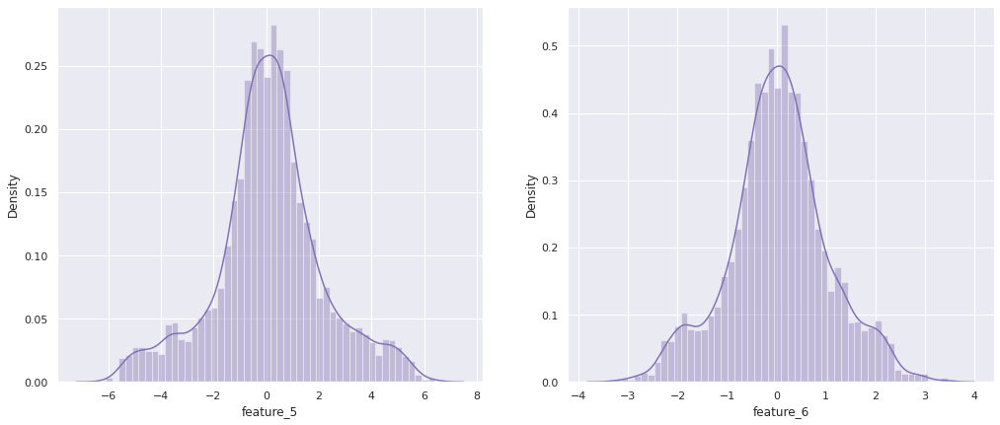

In [ ]:
fig, axes = plt.subplots(nrows=1
                         , ncols=2,figsize=(17,7))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_10_df.columns):
    sns.distplot(tag_10_df[column],ax=axes[i%2],color='m')

* These features are present   in previous Group/tag 6 as well.
* By looking at the distribution of  data we can say that features are zero reverted.

# Correlation Analysis of Group 10 

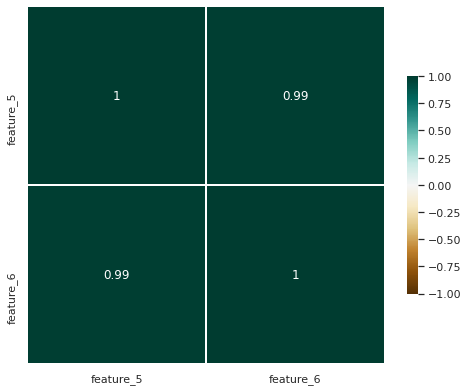

In [ ]:
corr = tag_10_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(8, 8))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* strong positive correlation  exist here in these features as well.

   # Linear Regression Analysis of Group 10
   - Here i have tried to find out between different features of Tag 10 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 10 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 10 category and on y axis resp is used.
   

feature_5 R2 score:0.0759
feature_6 R2 score:0.0653


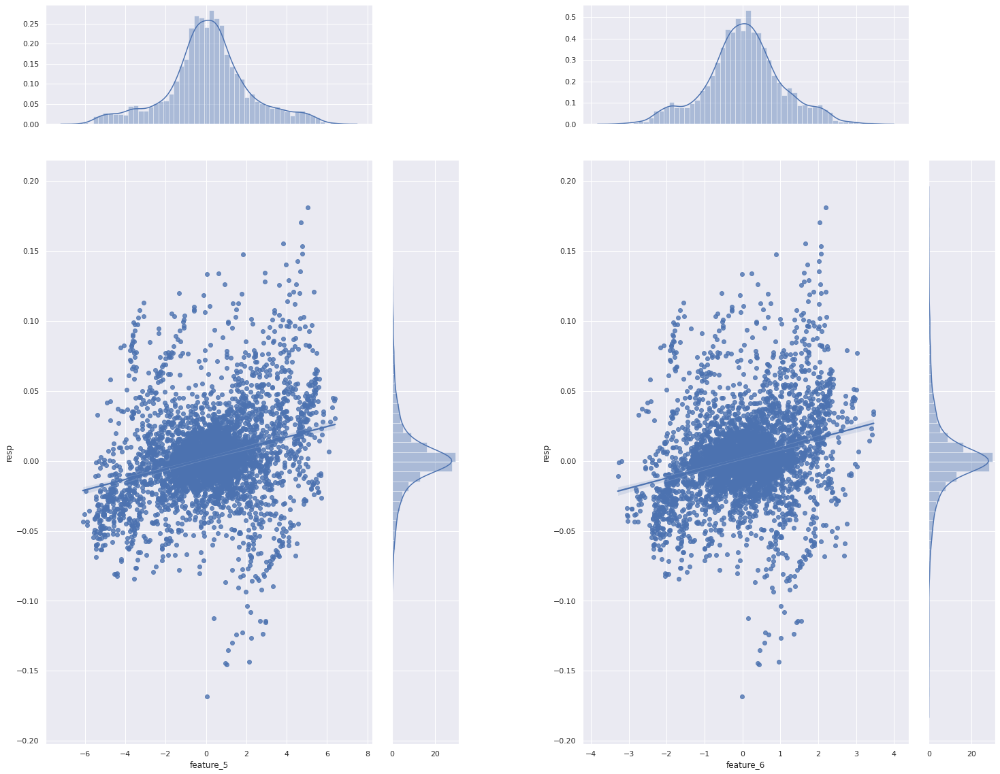

In [ ]:

ratio=4
f = plt.figure(figsize=(25,20))
outer_grid = gridspec.GridSpec(1, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_10_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* By looking at the linear regression fitted above we can see that  linear regression can be used between resp and features in this group to explain their relationship.
* Positive relation between both features and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Features 5 has highest **R2 score** in this tag of 0.0759.
* Feature 6 has lowest **R2 score** of 0.0653 in this tag/Group of features.  
 

# Group Tag 11
* This Group included Tag 11 features that are created with 12th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_11_df = sample_df[[*categories['tag_11'][0]]]

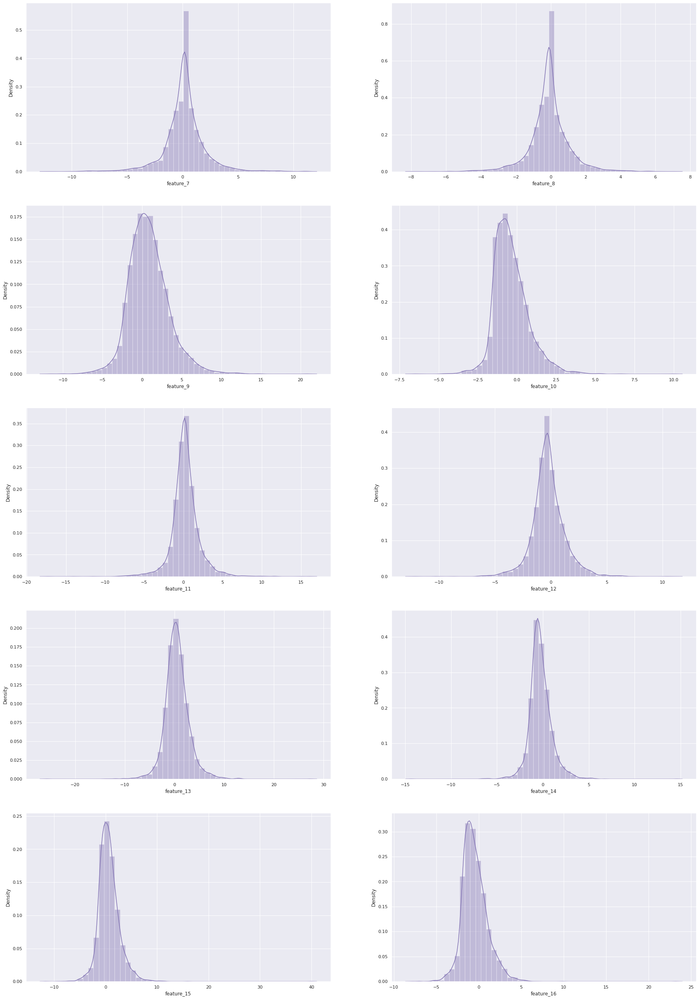

In [ ]:
fig, axes = plt.subplots(nrows=5
                         , ncols=2,figsize=(30,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_11_df.columns):
    sns.distplot(tag_11_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 11

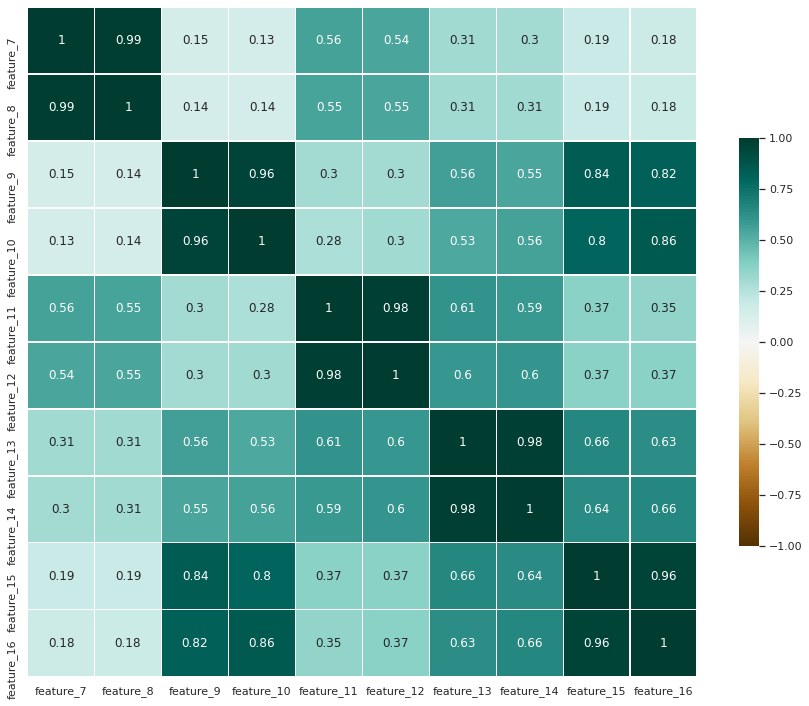

In [ ]:
corr = tag_11_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 15))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* All the featuers that are present in this Group have Positive correlation with Each other.
* Strong correlation pattern in the group of two features can be seen here as well.
* No negative correlationamong features is present in this group.

   # Linear Regression Analysis of Group 11
   - Here i have tried to find out between different features of Tag 11 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 11 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 11 category and on y axis resp is used.
   

feature_7 R2 score:0.015
feature_8 R2 score:0.0112
feature_9 R2 score:0.0014
feature_10 R2 score:0.0007
feature_11 R2 score:0.0097
feature_12 R2 score:0.0065
feature_13 R2 score:0.0004
feature_14 R2 score:0.0001
feature_15 R2 score:0.0016
feature_16 R2 score:0.0009


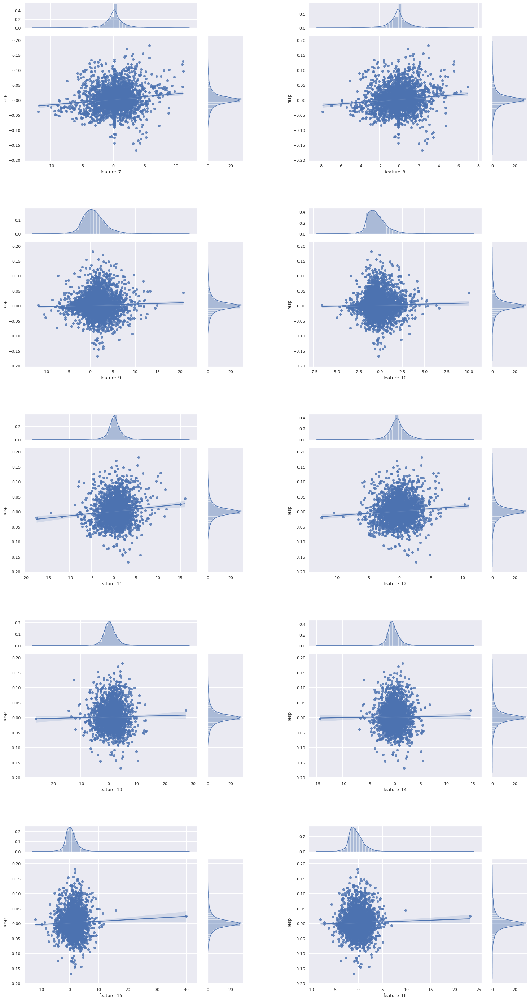

In [ ]:

ratio=4
f = plt.figure(figsize=(25,50))
outer_grid = gridspec.GridSpec(5, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_11_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between features 7,8,11,12 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* No Negative relation between features  and resp(target variable) in present in this Group.
* Features 7 has highest **R2 score** in this tag of 0.015 and feature 8 has second highest **R2 score** of 0.0112.
* Feature 14 has lowest **R2 score** of 0.0001 in this tag/Group of features.  
 

# Group Tag 12
* This Group included Tag 12 features that are created with 13th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_12_df = sample_df[[*categories['tag_12'][0]]]


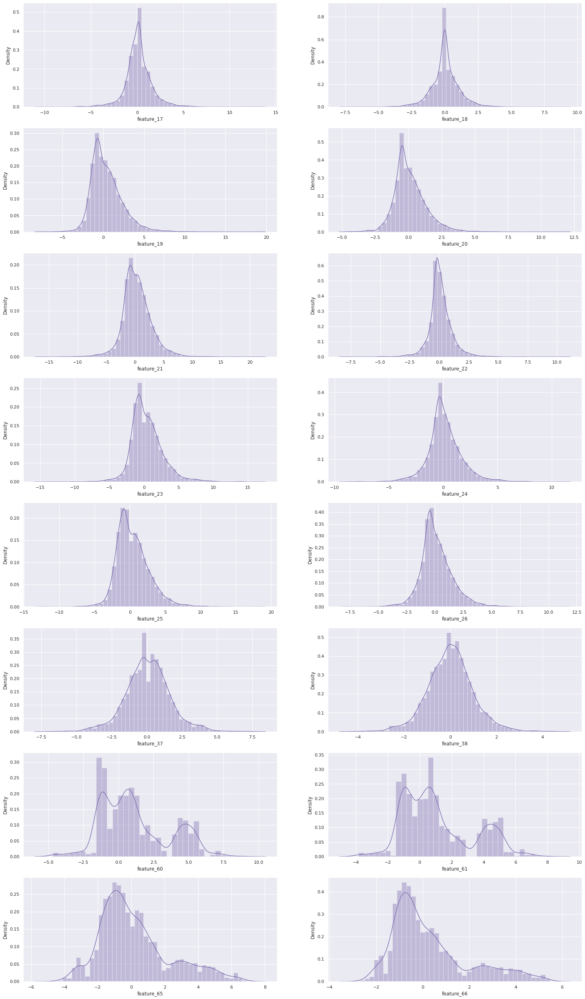

In [ ]:
fig, axes = plt.subplots(nrows=8
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_12_df.columns):
    sns.distplot(tag_12_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 12

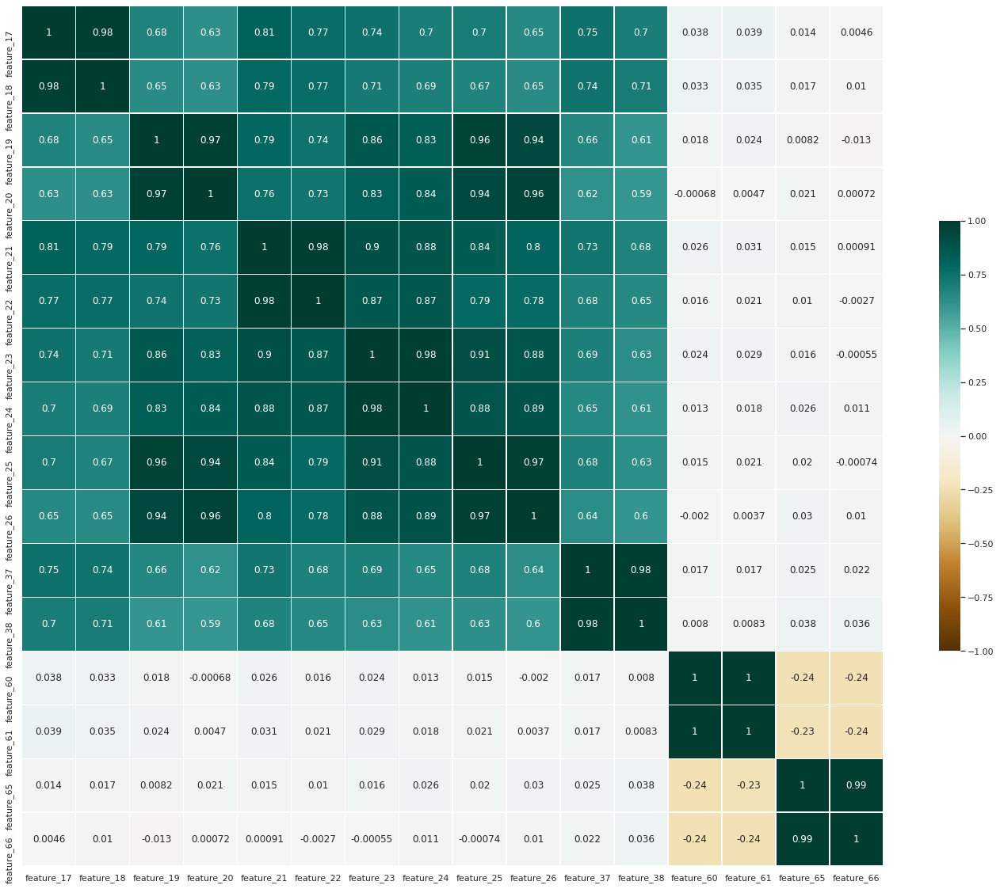

In [ ]:
corr = tag_12_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(25, 20))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* First 12 features have Strong Positive Correlation with each other.
* Strong Postive correlation  in Groups of two features can be seen here as well.
* Last 4 features have negative correlation among them as well. 

   # Linear Regression Analysis of Group 12
   
   

feature_17 R2 score:0.0542
feature_18 R2 score:0.0388
feature_19 R2 score:0.0368
feature_20 R2 score:0.0215
feature_21 R2 score:0.0481
feature_22 R2 score:0.0298
feature_23 R2 score:0.0542
feature_24 R2 score:0.0365
feature_25 R2 score:0.0483
feature_26 R2 score:0.0298
feature_37 R2 score:0.0568
feature_38 R2 score:0.0368
feature_60 R2 score:0.0004
feature_61 R2 score:0.0004
feature_65 R2 score:0.0001
feature_66 R2 score:0.0001


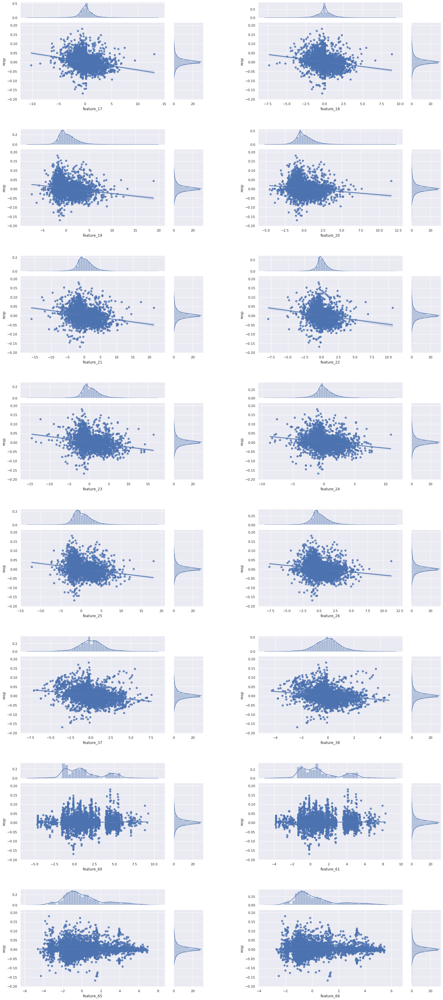

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(8, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_12_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Features 60 and feature 61 has different distribtion of data than any other features i have seen.
* No Positive relation between features and resp(target variable) is present in this Group.
* Negative relation between first 12 features  and resp(target variable) can be seen in above charts.
* Features 37 has highest **R2 score** in this tag of 0.0568 and feature 17,23 has second highest **R2 score** of 0.0542.
* Feature 66 has lowest **R2 score** of 0.0001 in this tag/Group of features.  
 

# Group Tag 13
* This Group included Tag 13 features that are created with 14th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_13_df = sample_df[[*categories['tag_13'][0]]]


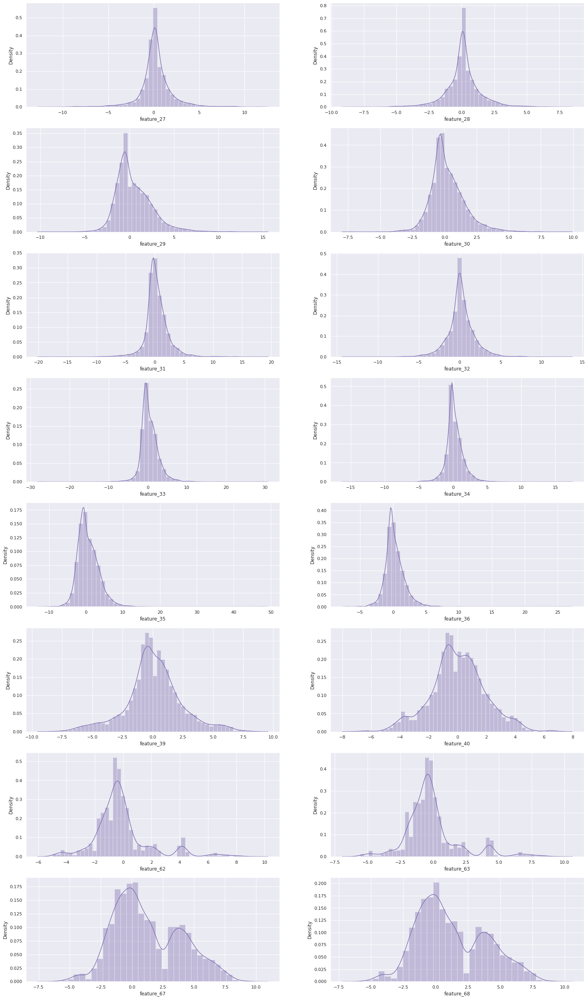

In [ ]:
fig, axes = plt.subplots(nrows=8
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_13_df.columns):
    sns.distplot(tag_13_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 13

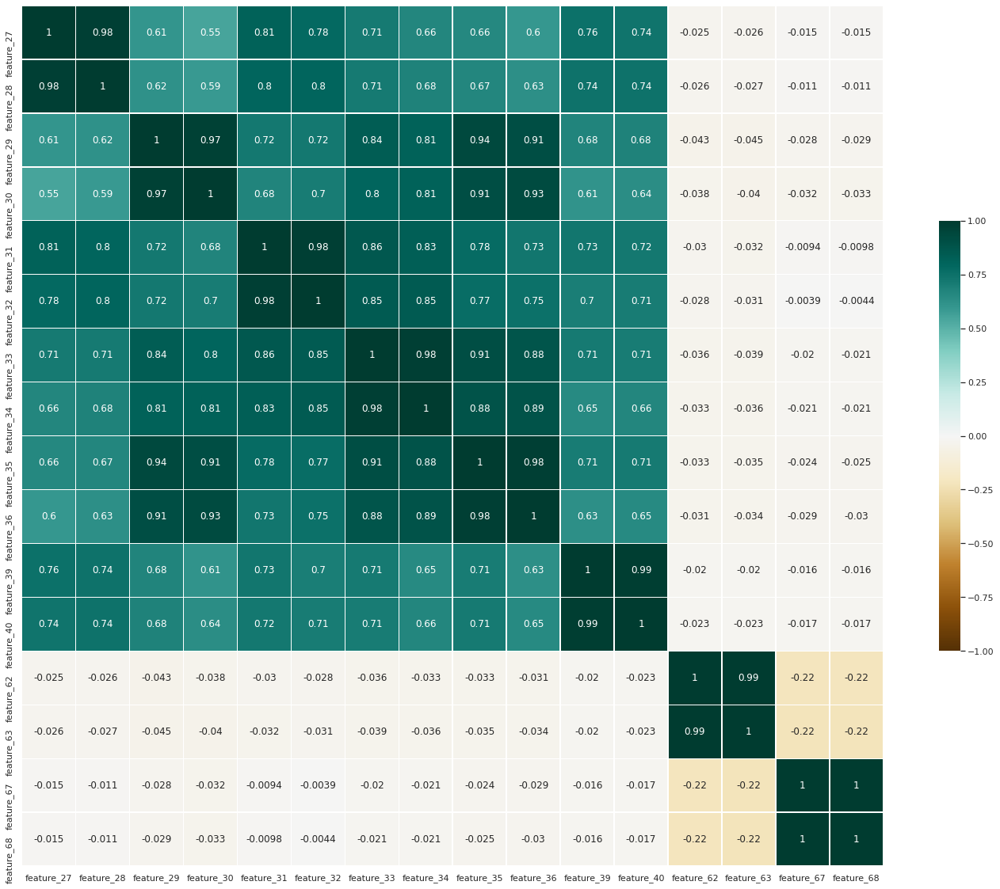

In [ ]:
corr = tag_13_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(25, 20))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 13
   - Here i have tried to find out between different features of Tag 13 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 13 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 13 category and on y axis resp is used.
   

feature_27 R2 score:0.0632
feature_28 R2 score:0.048
feature_29 R2 score:0.0481
feature_30 R2 score:0.0286
feature_31 R2 score:0.0599
feature_32 R2 score:0.044
feature_33 R2 score:0.0517
feature_34 R2 score:0.0337
feature_35 R2 score:0.0524
feature_36 R2 score:0.0315
feature_39 R2 score:0.1344
feature_40 R2 score:0.1099
feature_62 R2 score:0.0
feature_63 R2 score:0.0
feature_67 R2 score:0.0008
feature_68 R2 score:0.0009


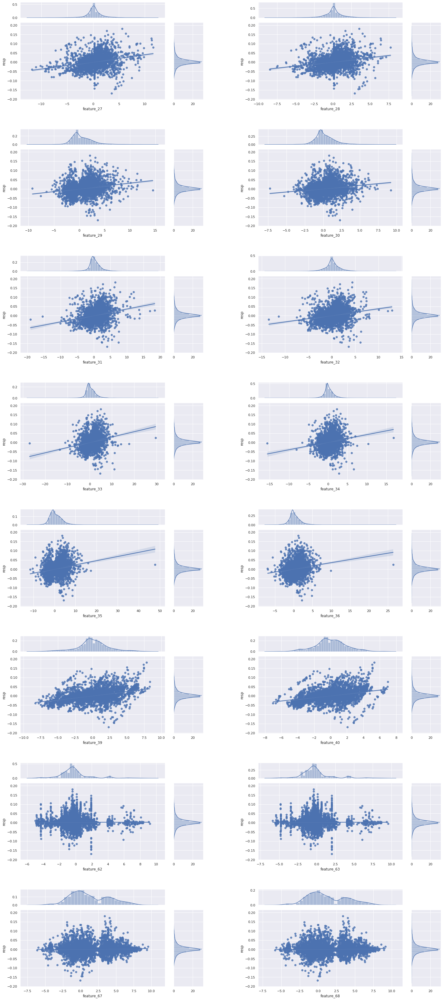

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(8, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_13_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between almost all features  and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* No Negative relation between featuers and resp(target variable) is found in this Group.
* Features 39 has highest **R2 score** in this tag of 0.1344 and feature 40 has second highest **R2 score** of 0.1099.
* Features 62.63 has lowest **R2 score** of 0.0 in this tag/Group of features.
* **This Tag looks like a reflection of Previous Group**
 

# Group Tag 14
* This Group included Tag 14 features that are created with 15th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_14_df = sample_df[[*categories['tag_14'][0]]]


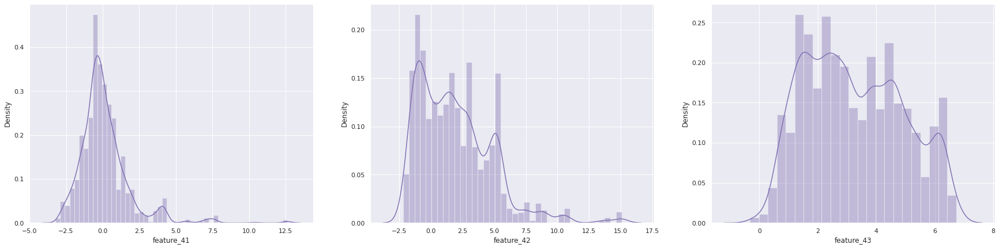

In [ ]:
fig, axes = plt.subplots(nrows=1
                         , ncols=3,figsize=(30,7))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_14_df.columns):
    sns.distplot(tag_14_df[column],ax=axes[i%3],color='m')

# Correlation analysis of Group 14

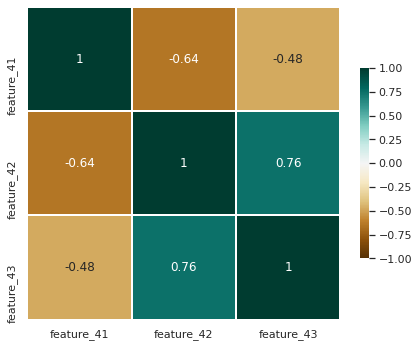

In [ ]:
corr = tag_14_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(7, 7))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* feature 41 have Negative correlation with features 42 and 43.
* Positive Correlation between 42 and 43 is present in this group.

   # Linear Regression Analysis of Group 14
   - Here i have tried to find out between different features of Tag 14 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 14 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 14 category and on y axis resp is used.
   

feature_41 R2 score:0.002
feature_42 R2 score:0.0006
feature_43 R2 score:0.0039


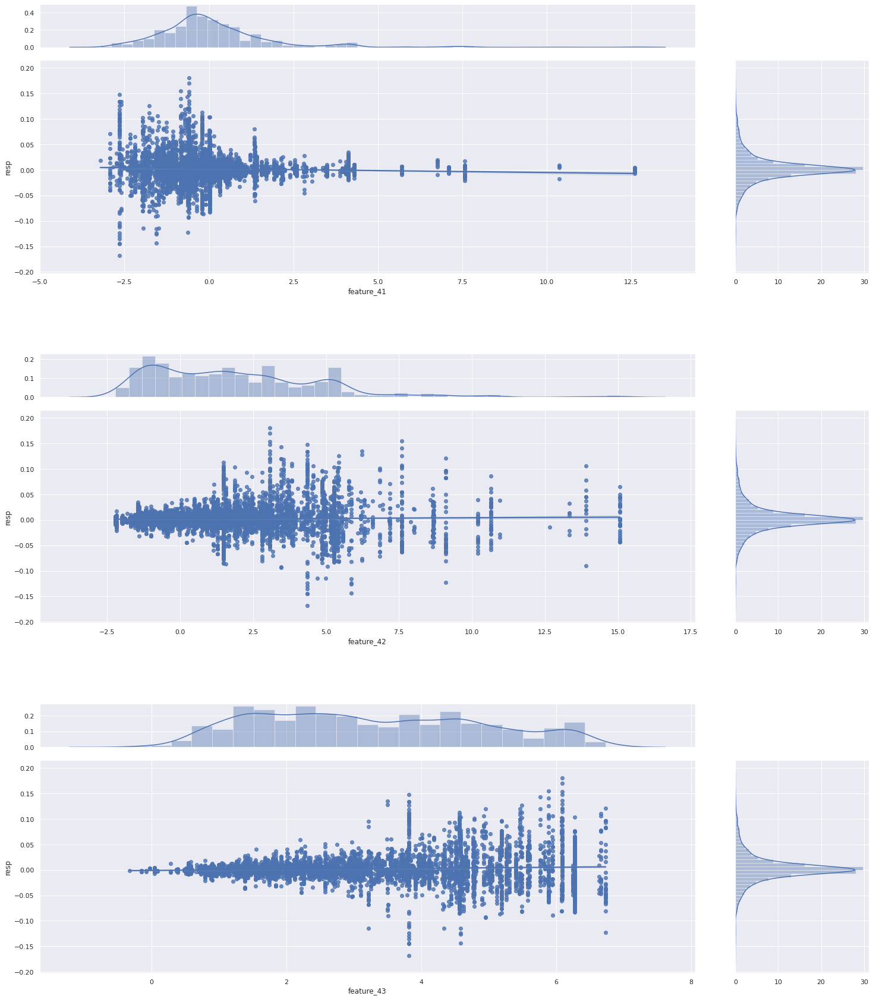

In [ ]:

ratio=4
f = plt.figure(figsize=(25,30))
outer_grid = gridspec.GridSpec(3, 1, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_14_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Features 43 has highest **R2 score** in this tag of 0.0039 and feature 41 has second highest **R2 score** of 0.002.
* Features 42 has lowest **R2 score** of 0.00006 in this tag/Group of features.
* Distribution of these features is quite different than any other features that i have seen.
 

# Group Tag 15
* This Group included Tag 15 features that are created with 16th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_15_df = sample_df[[*categories['tag_15'][0]]]


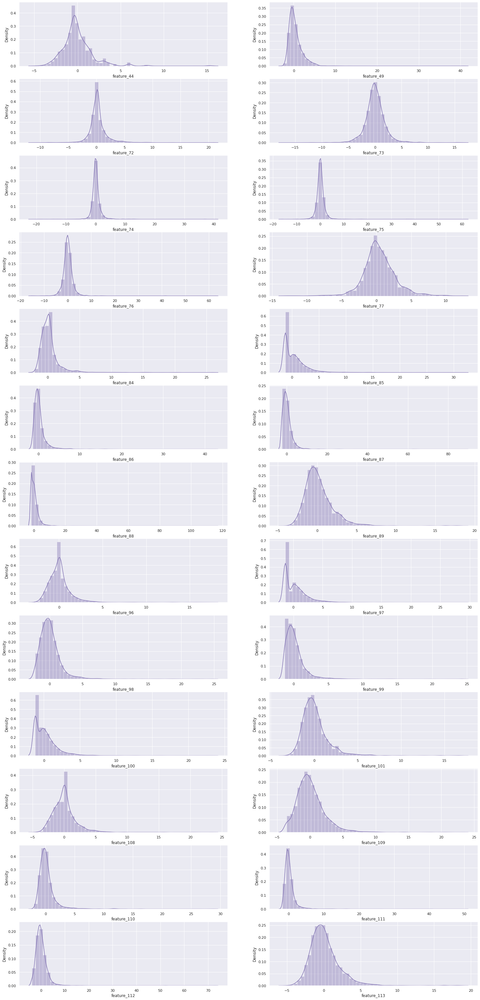

In [ ]:
fig, axes = plt.subplots(nrows=13
                         , ncols=2,figsize=(25,55))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_15_df.columns):
    sns.distplot(tag_15_df[column],ax=axes[i//2,i%2],color='m')

* Skewness can be seen here in lot of feaures than any other groups before.
* Only features 72,73 and 75 have similar skewness as Normal Distribution.
* large Skewness value be due to smaller sample size that i using here.

# Correlation Analysis of Tag 15

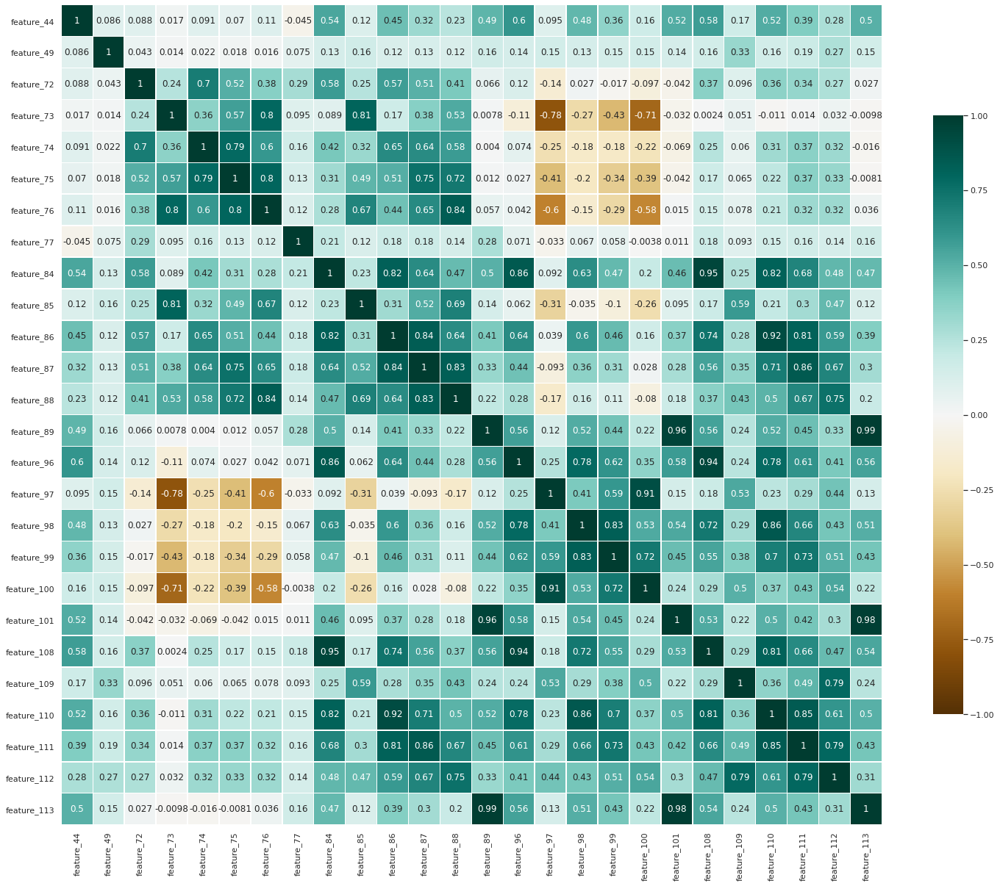

In [ ]:
corr = tag_15_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(25, 30))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 15
   - Here i have tried to find out between different features of Tag 15 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 15 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 15 category and on y axis resp is used.
   

feature_44 R2 score:0.0025
feature_49 R2 score:0.0001
feature_72 R2 score:0.0001
feature_73 R2 score:0.0139
feature_74 R2 score:0.0011
feature_75 R2 score:0.0039
feature_76 R2 score:0.0093
feature_77 R2 score:0.0018
feature_84 R2 score:0.0004
feature_85 R2 score:0.0161
feature_86 R2 score:0.0015
feature_87 R2 score:0.0051
feature_88 R2 score:0.0071
feature_89 R2 score:0.0059
feature_96 R2 score:0.0005
feature_97 R2 score:0.0082
feature_98 R2 score:0.0
feature_99 R2 score:0.0002
feature_100 R2 score:0.0049
feature_101 R2 score:0.0091
feature_108 R2 score:0.0007
feature_109 R2 score:0.0015
feature_110 R2 score:0.0008
feature_111 R2 score:0.0011
feature_112 R2 score:0.0009
feature_113 R2 score:0.0074


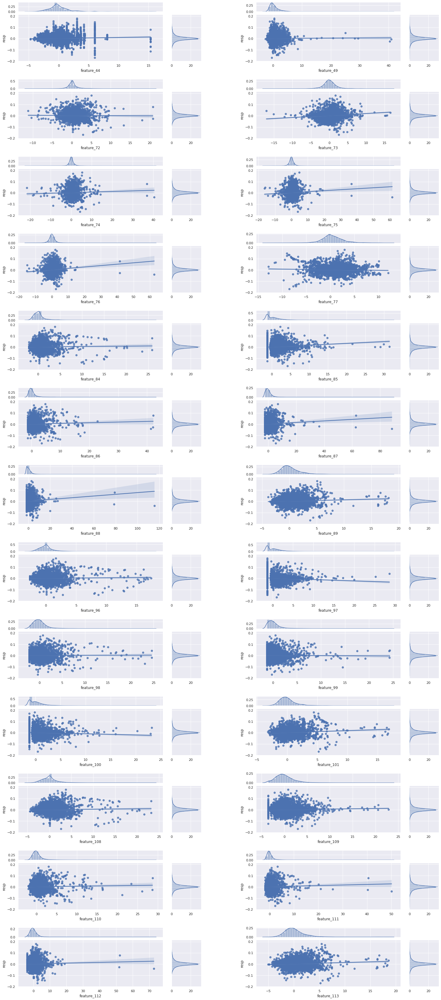

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(13, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_15_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between 73,74,75,76,85,87,88 features  and resp(target variable) can be seen in ****Linear Regression analysis**** above.
*  Negative relation between features 77,97 and resp(target variable) is found in this Group.
* Features 85 has highest **R2 score** in this tag of 0.016 and feature 73 has second highest **R2 score** of 0.013.
* Features 98 has lowest **R2 score** of 0.0 in this tag/Group of features.
 

# Group Tag 16
* This Group included Tag 16 features that are created with 17th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_16_df = sample_df[[*categories['tag_16'][0]]]


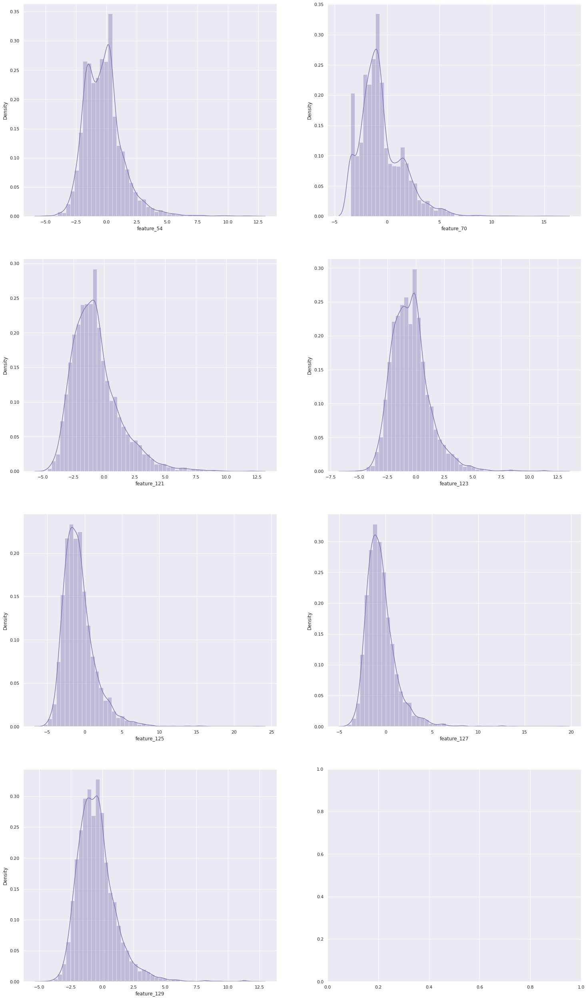

In [ ]:
fig, axes = plt.subplots(nrows=4
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_16_df.columns):
    sns.distplot(tag_16_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 16

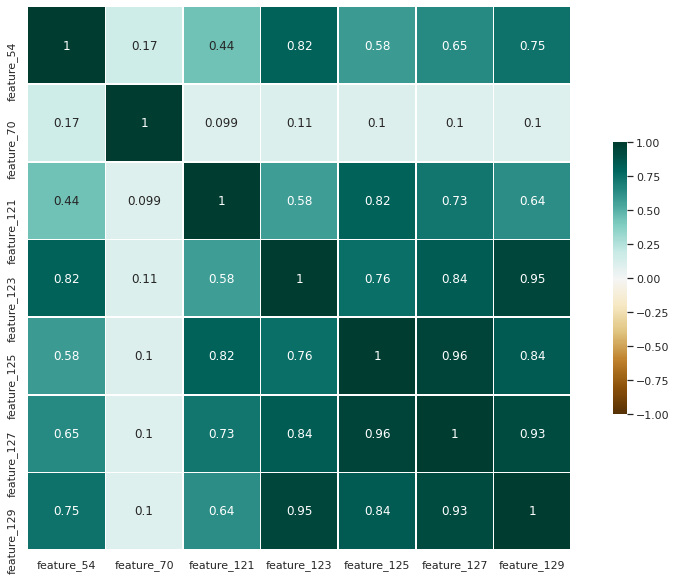

In [ ]:
corr = tag_16_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 10))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 16
   - Here i have tried to find out between different features of Tag 16 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 16 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 16 category and on y axis resp is used.
   

feature_54 R2 score:0.0
feature_70 R2 score:0.0008
feature_121 R2 score:0.0008
feature_123 R2 score:0.0001
feature_125 R2 score:0.0004
feature_127 R2 score:0.0003
feature_129 R2 score:0.0002


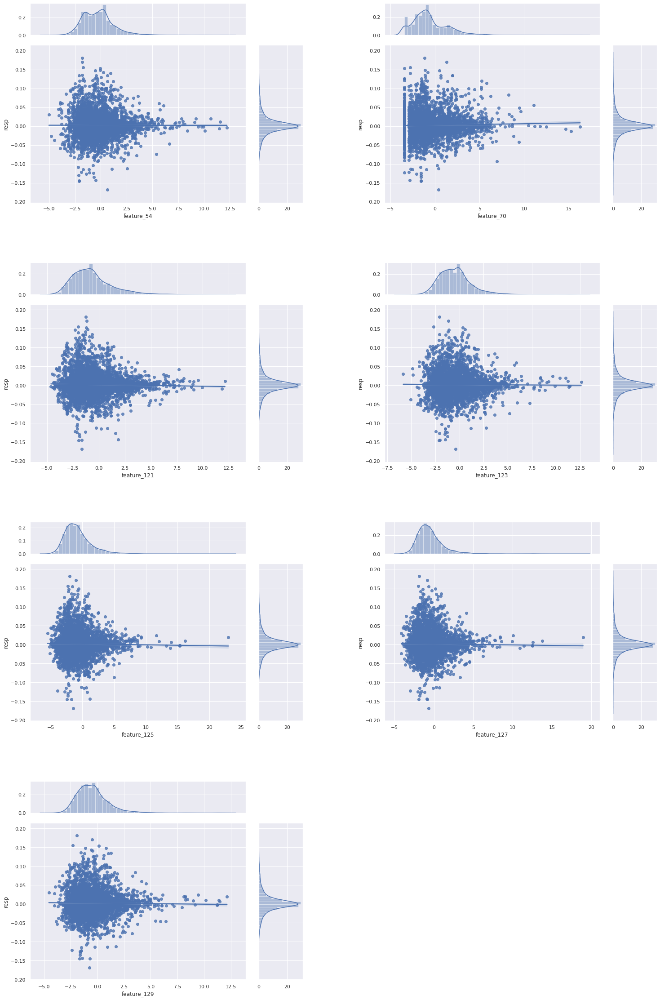

In [ ]:

ratio=4
f = plt.figure(figsize=(25,40))
outer_grid = gridspec.GridSpec(4, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_16_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* No positive or Negative Relation is seen  in This Group and resp(target variable)in ****Linear Regression analysis**** above.
* Features 70,121 has highest **R2 score** in this tag of 0.0008.
* Features 54 has lowest **R2 score** of 0.0 in this tag/Group of features.
* **This Tag looks like a relection of Previous Group**
 

# Group Tag 17
* This Group included Tag 17 features that are created with 18th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_17_df = sample_df[[*categories['tag_17'][0]]]


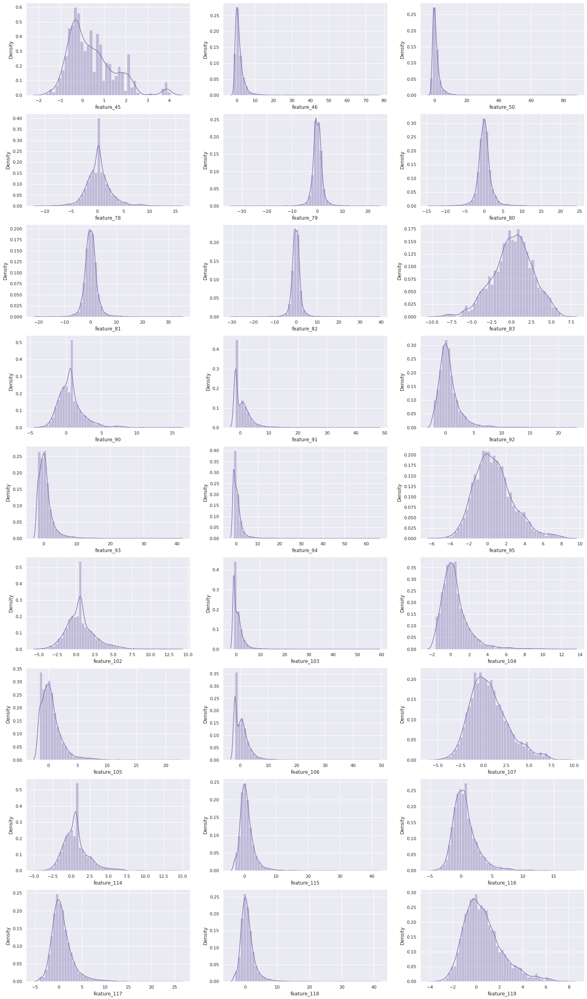

In [ ]:
fig, axes = plt.subplots(nrows=9
                         , ncols=3,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_17_df.columns):
    sns.distplot(tag_17_df[column],ax=axes[i//3,i%3],color='m')

# Correlation Analysis of Group 17

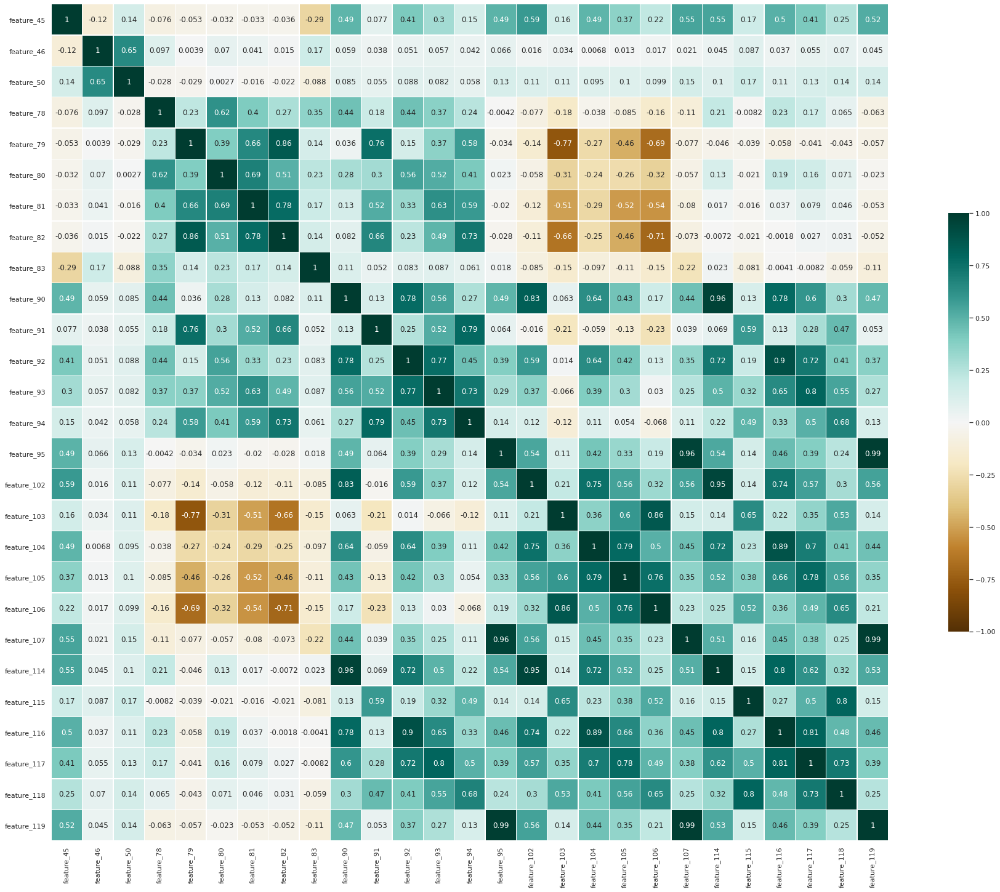

In [ ]:
corr = tag_17_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(35, 25))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 17
   - Here i have tried to find out between different features of Tag 17 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 17 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 17 category and on y axis resp is used.
   

feature_45 R2 score:0.0001
feature_46 R2 score:0.0004
feature_50 R2 score:0.0006
feature_78 R2 score:0.0001
feature_79 R2 score:0.0183
feature_80 R2 score:0.0005
feature_81 R2 score:0.0071
feature_82 R2 score:0.0136
feature_83 R2 score:0.0005
feature_90 R2 score:0.0005
feature_91 R2 score:0.0155
feature_92 R2 score:0.0
feature_93 R2 score:0.002
feature_94 R2 score:0.0067
feature_95 R2 score:0.0006
feature_102 R2 score:0.0004
feature_103 R2 score:0.0112
feature_104 R2 score:0.0014
feature_105 R2 score:0.0043
feature_106 R2 score:0.0111
feature_107 R2 score:0.0011
feature_114 R2 score:0.0005
feature_115 R2 score:0.0
feature_116 R2 score:0.0004
feature_117 R2 score:0.0001
feature_118 R2 score:0.0001
feature_119 R2 score:0.0008


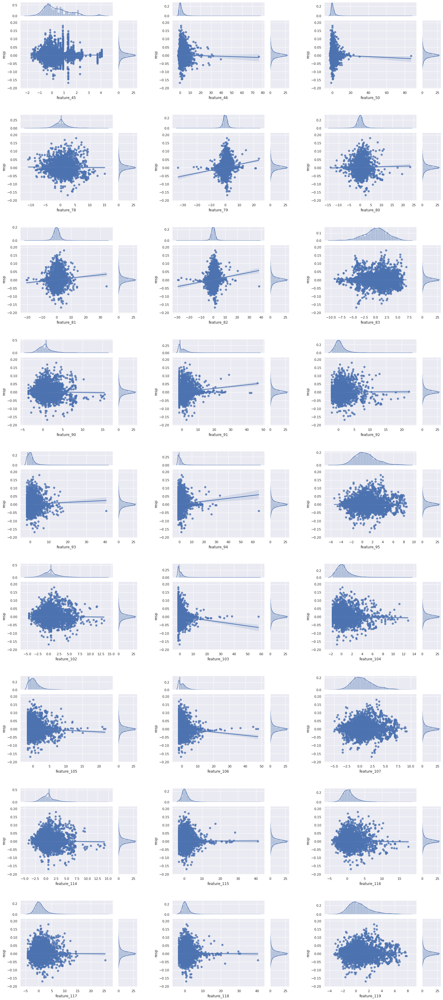

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(9, 3, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_17_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between features 79,81,82,91 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between features 46,50,103,106 and resp(target variable) is found in this Group.
* Features 79 has highest **R2 score** in this tag of 0.018 and feature 99 has second highest **R2 score** of 0.015.
* Features 115 has lowest **R2 score** of 0.0 in this tag/Group of features.
* **Features in this Tag have lower values of R2 Score than any other group that i have explored**
 

# Group Tag 18
* This Group included Tag 18 features that are created with 19th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_18_df = sample_df[[*categories['tag_18'][0]]]


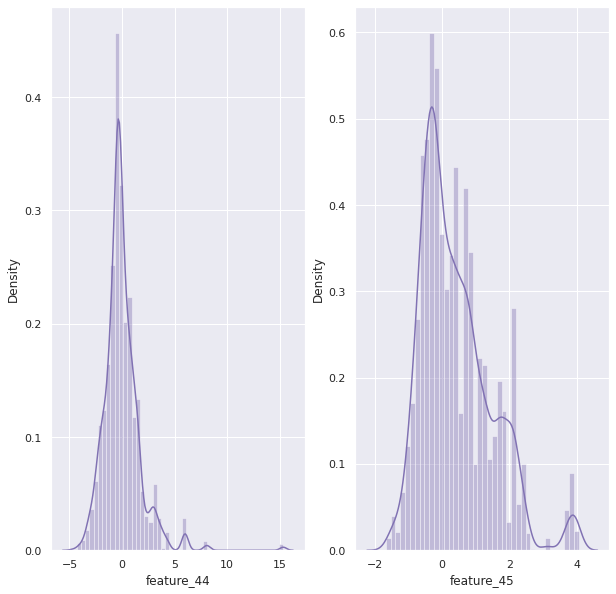

In [ ]:
fig, axes = plt.subplots(nrows=1
                         , ncols=2,figsize=(10,10))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_18_df.columns):
    sns.distplot(tag_18_df[column],ax=axes[i%2],color='m')

# Correlation Analysis of Group 18

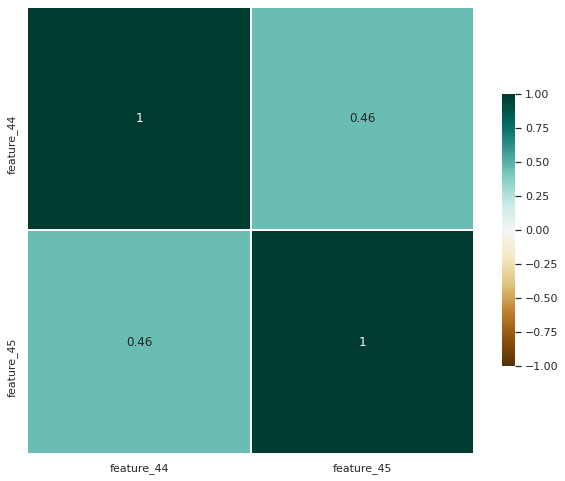

In [ ]:
corr = tag_18_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(10, 10))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* Both Features in this Tag have positive Correlation with other again validating my Hypothesis. 

   # Linear Regression Analysis of Group 18
   - Here i have tried to find out between different features of Tag 18 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 18 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 18 category and on y axis resp is used.
   

feature_44 R2 score:0.0025
feature_45 R2 score:0.0001


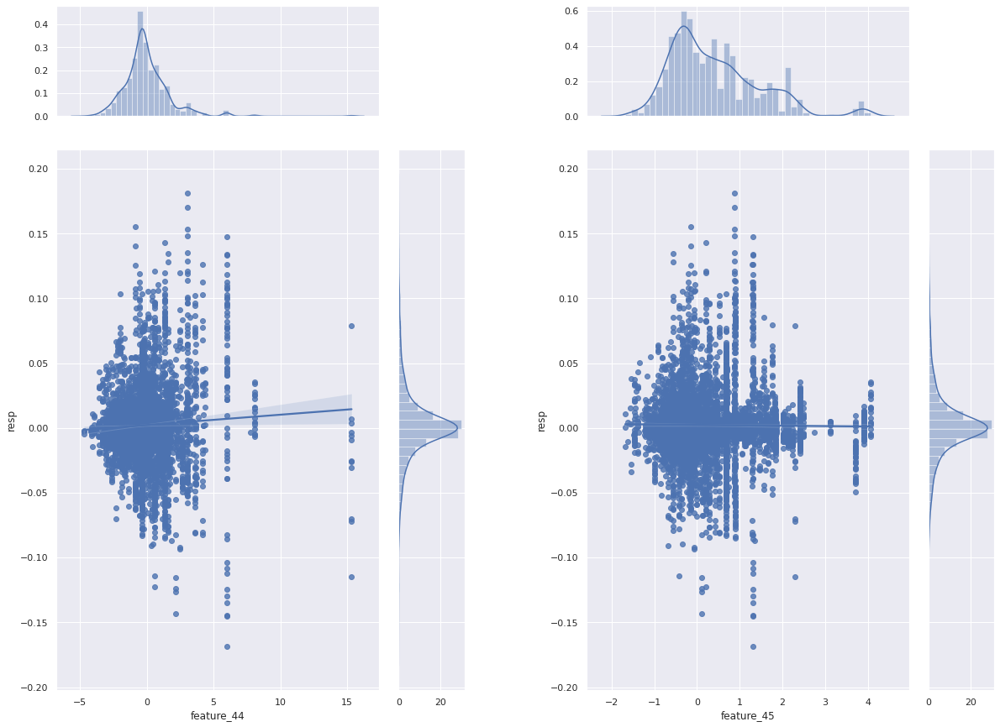

In [ ]:

ratio=4
f = plt.figure(figsize=(20,15))
outer_grid = gridspec.GridSpec(1, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_18_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation to some extent between features 44 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* No Negative relation between feat and resp(target variable) is found in this Group.
* Features 44 has highest **R2 score** in this tag of 0.018.
* Features 45 has lowest **R2 score** of 0.0001 in this tag/Group of features.
 

# Group Tag 19
* This Group included Tag 19 features that are created with 20th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_19_df = sample_df[[*categories['tag_19'][0]]]


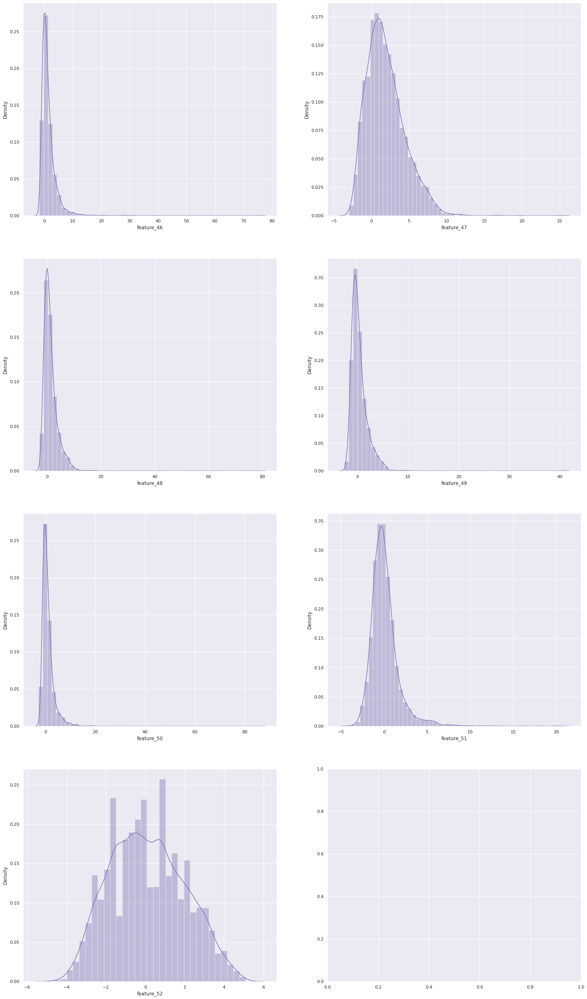

In [ ]:
fig, axes = plt.subplots(nrows=4
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_19_df.columns):
    sns.distplot(tag_19_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 19

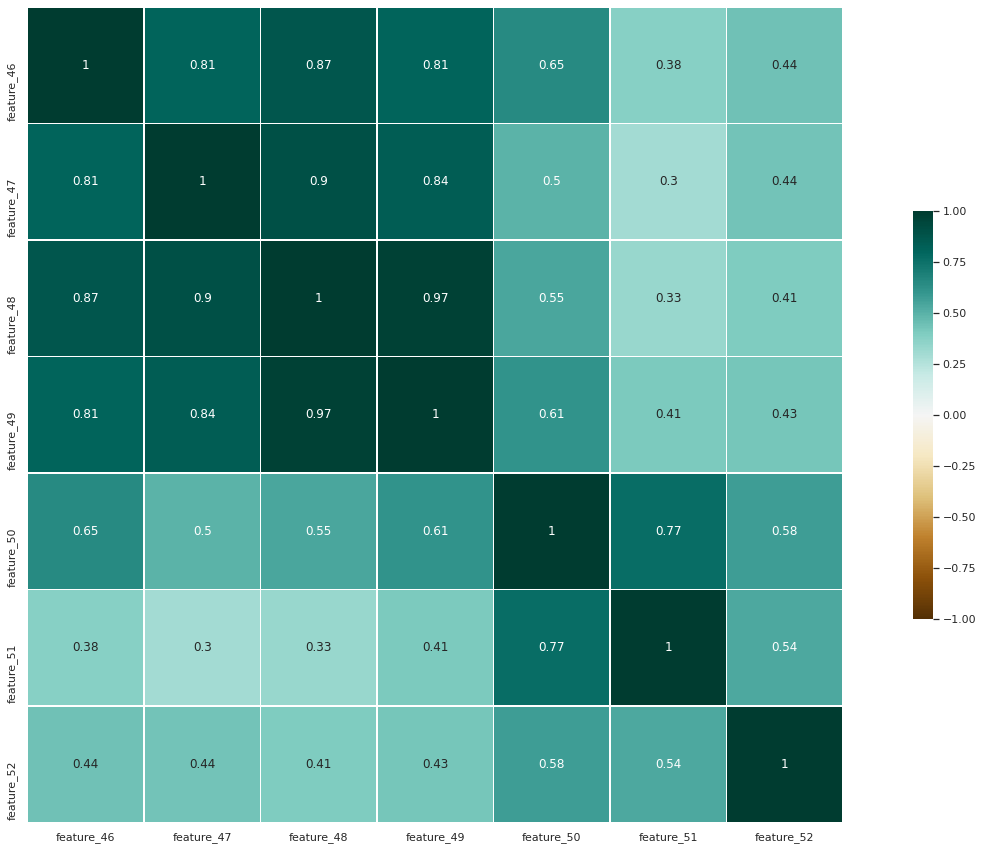

In [ ]:
corr = tag_19_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(25, 15))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

* Strong  Positive Corrrelation is found in this group as well.

   # Linear Regression Analysis of Group 19
   - Here i have tried to find out between different features of Tag 19 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 19 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 19 category and on y axis resp is used.
   

feature_46 R2 score:0.0004
feature_47 R2 score:0.0007
feature_48 R2 score:0.0002
feature_49 R2 score:0.0001
feature_50 R2 score:0.0006
feature_51 R2 score:0.0011
feature_52 R2 score:0.0005


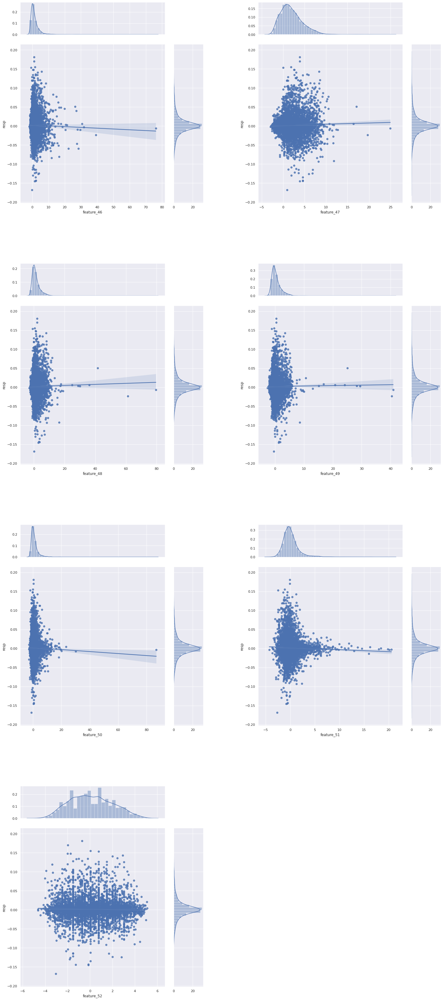

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(4, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_19_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


*  No Positive relation between features  and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between features 46,50, and resp(target variable) is found in this Group.
* Features 51 has highest **R2 score** in this tag of 0.0011 and feature 47 has second highest **R2 score** of 0.0007.
* Features 49 has lowest **R2 score** of 0.0001 in this tag/Group of features.
* **Features in this Tag and Tag 17 have lower values of R2 Score than any other group that i have explored**
 

# Group Tag 20
* This Group included Tag 20 features that are created with 21th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_20_df = sample_df[[*categories['tag_20'][0]]]

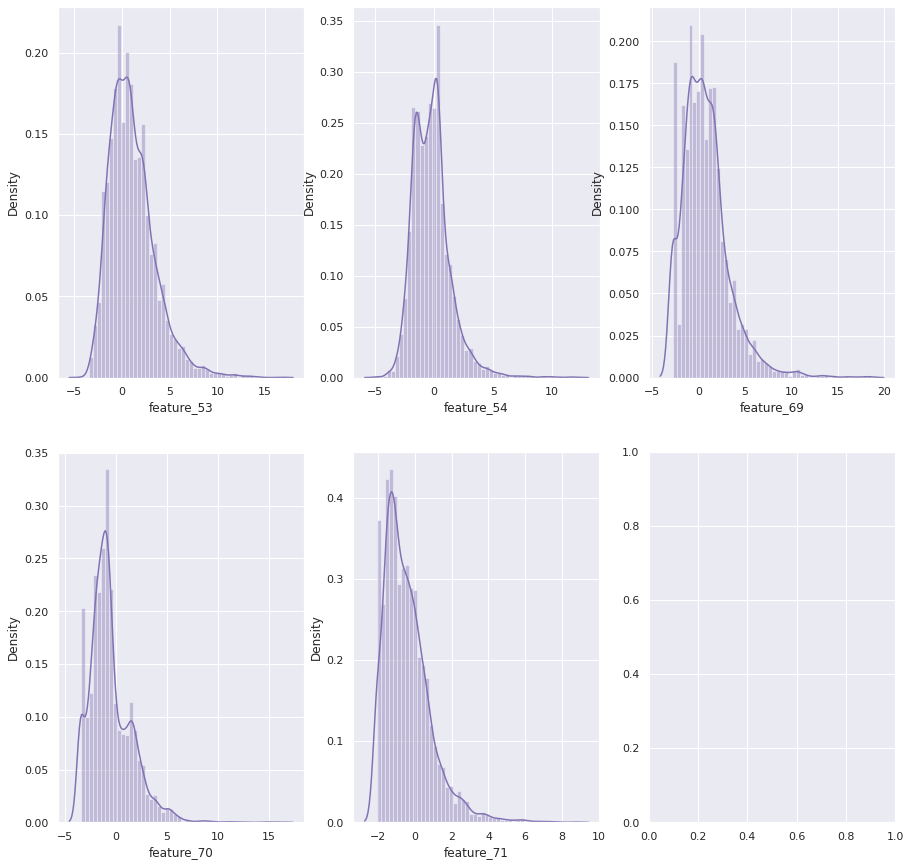

In [ ]:
fig, axes = plt.subplots(nrows=2
                         , ncols=3,figsize=(15,15))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_20_df.columns):
    sns.distplot(tag_20_df[column],ax=axes[i//3,i%3],color='m')

# Correlation Analysis of Group 20

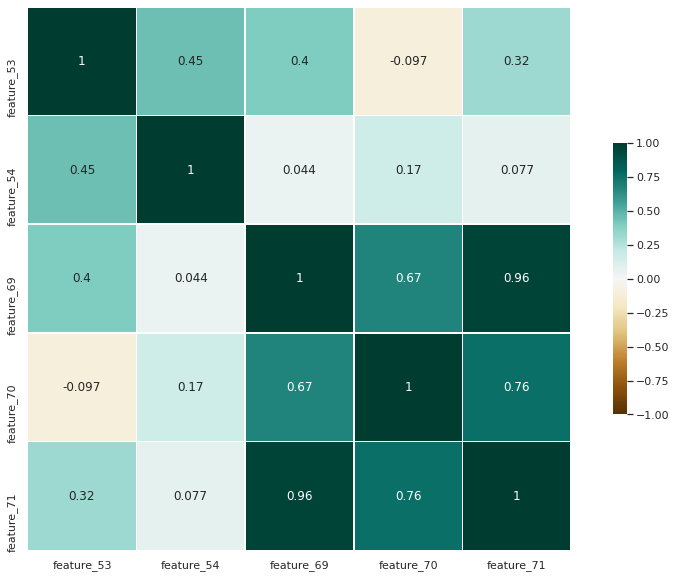

In [ ]:
corr = tag_20_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 10))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 20
   - Here i have tried to find out between different features of Tag 20 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 20 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 20 category and on y axis resp is used.
   

feature_53 R2 score:0.0005
feature_54 R2 score:0.0
feature_69 R2 score:0.0033
feature_70 R2 score:0.0008
feature_71 R2 score:0.0023


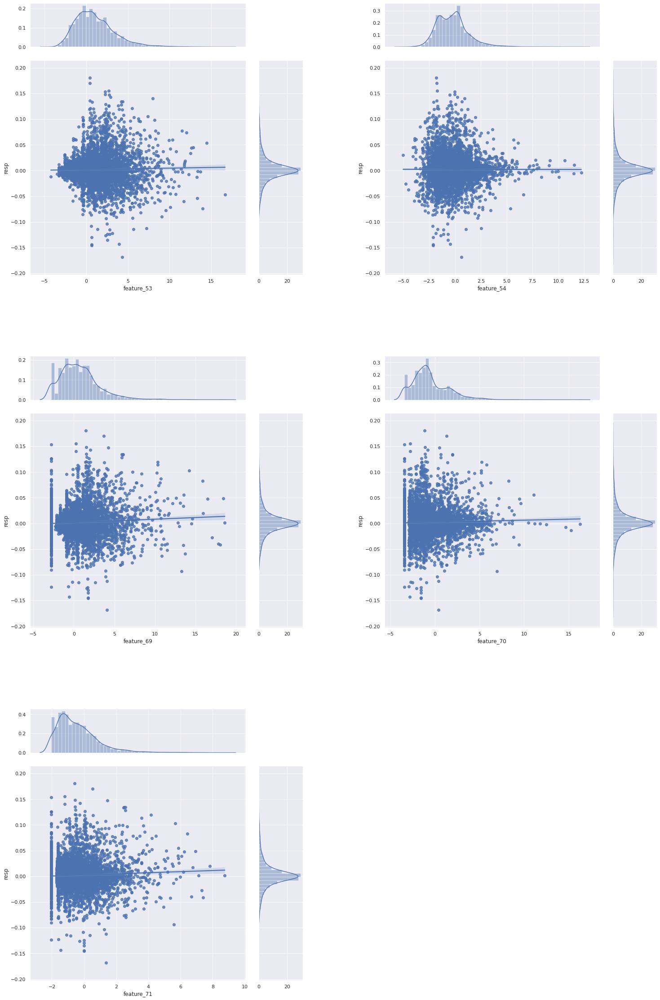

In [ ]:

ratio=4
f = plt.figure(figsize=(25,40))
outer_grid = gridspec.GridSpec(3, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_20_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* No  Positive Or Negative relation between features  and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Features 69 has highest **R2 score** in this tag of 0.0033 and feature 71 has second highest **R2 score** of 0.0023.
* Features 54 has lowest **R2 score** of 0.0 in this tag/Group of features.
 

# Group Tag 21
* This Group included Tag 21 features that are created with 22th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_21_df = sample_df[[*categories['tag_21'][0]]]

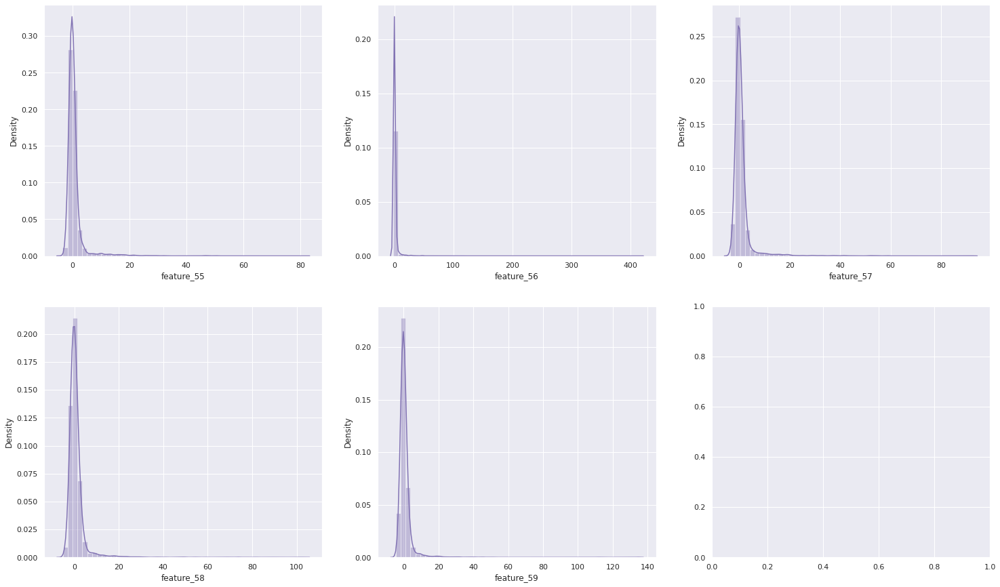

In [ ]:
fig, axes = plt.subplots(nrows=2
                         , ncols=3,figsize=(25,15))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_21_df.columns):
    sns.distplot(tag_21_df[column],ax=axes[i//3,i%3],color='m')

# Correlation Analysis of Group 21

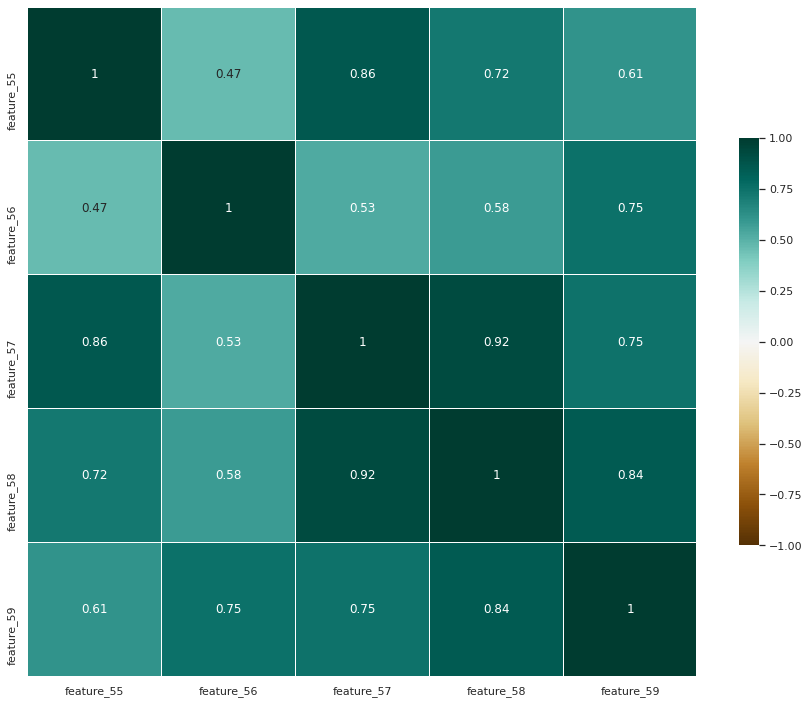

In [ ]:
corr = tag_21_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 15))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 21
   - Here i have tried to find out between different features of Tag 21 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 21 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 21 category and on y axis resp is used.
   

feature_55 R2 score:0.0006
feature_56 R2 score:0.0003
feature_57 R2 score:0.0007
feature_58 R2 score:0.0006
feature_59 R2 score:0.0007


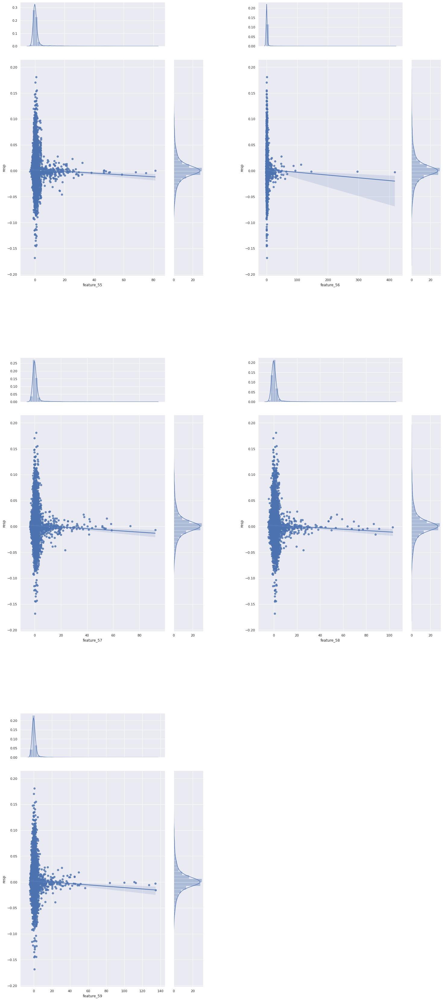

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(3, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_21_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Neutral relation between features  and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Features 59,57 have highest **R2 score** in this tag of 0.0007 and feature 55 ,58 has second highest **R2 score** of 0.015.
* Features 56 has lowest **R2 score** of 0.0 in this tag/Group of features.


# Group Tag 22
* This Group included Tag 22 features that are created with 23th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_22_df = sample_df[[*categories['tag_22'][0]]]

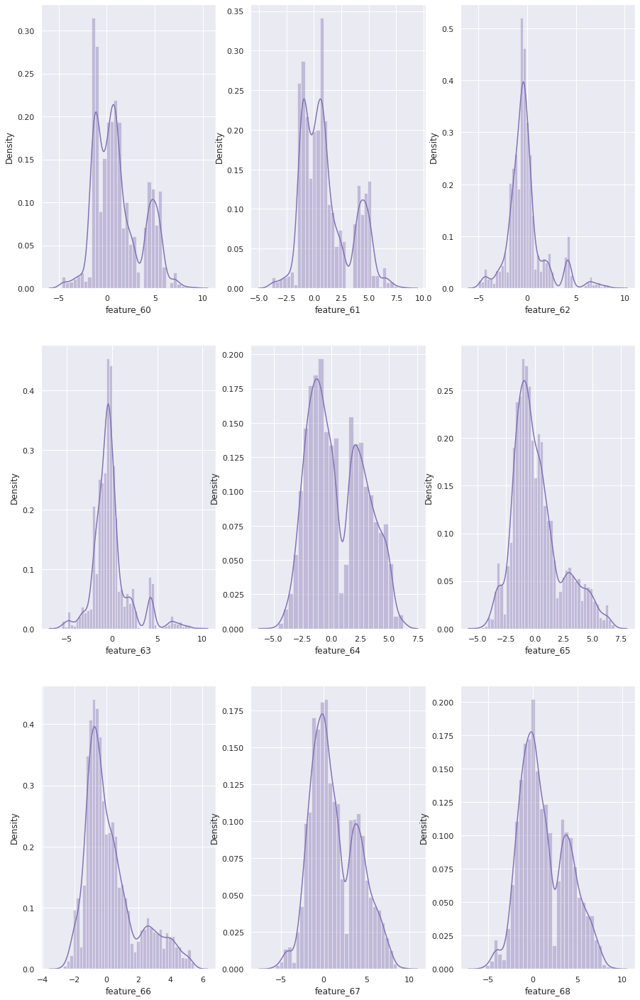

In [ ]:
fig, axes = plt.subplots(nrows=3
                         , ncols=3,figsize=(15,25))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_22_df.columns):
    sns.distplot(tag_22_df[column],ax=axes[i//3,i%3],color='m')

# Correlation Analysis of Group 22

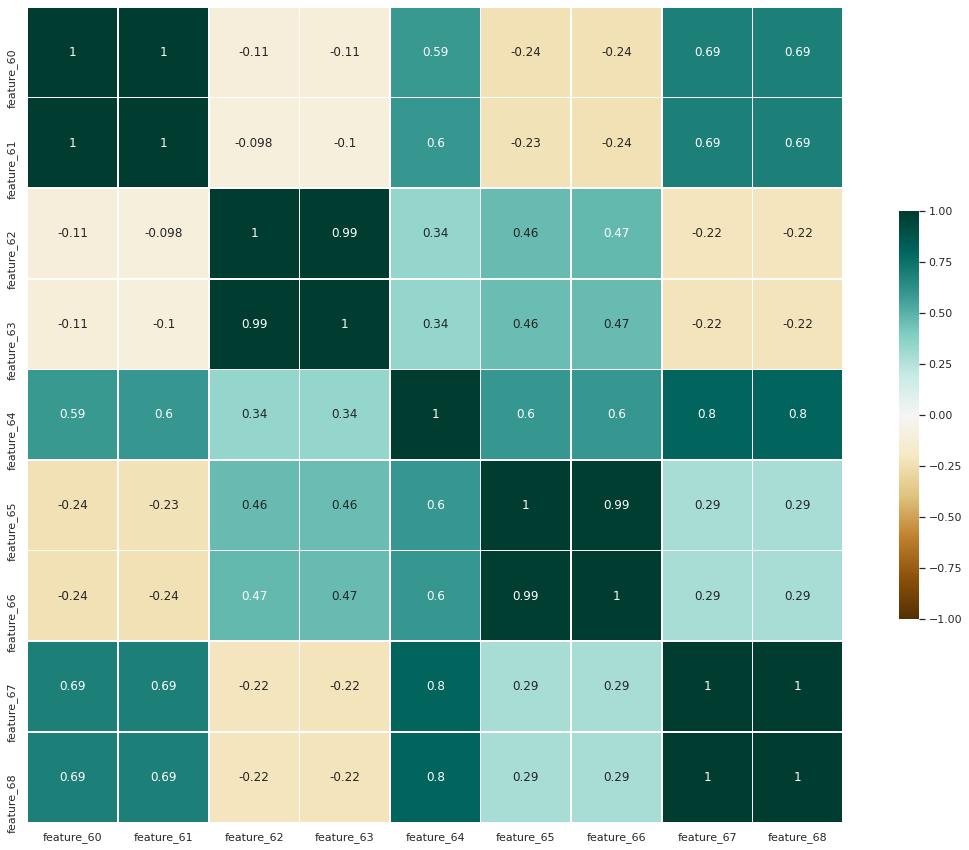

In [ ]:
corr = tag_22_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 15))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 22
   - Here i have tried to find out between different features of Tag 22 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 22 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 22 category and on y axis resp is used.
   

feature_60 R2 score:0.0004
feature_61 R2 score:0.0004
feature_62 R2 score:0.0
feature_63 R2 score:0.0
feature_64 R2 score:0.0008
feature_65 R2 score:0.0001
feature_66 R2 score:0.0001
feature_67 R2 score:0.0008
feature_68 R2 score:0.0009


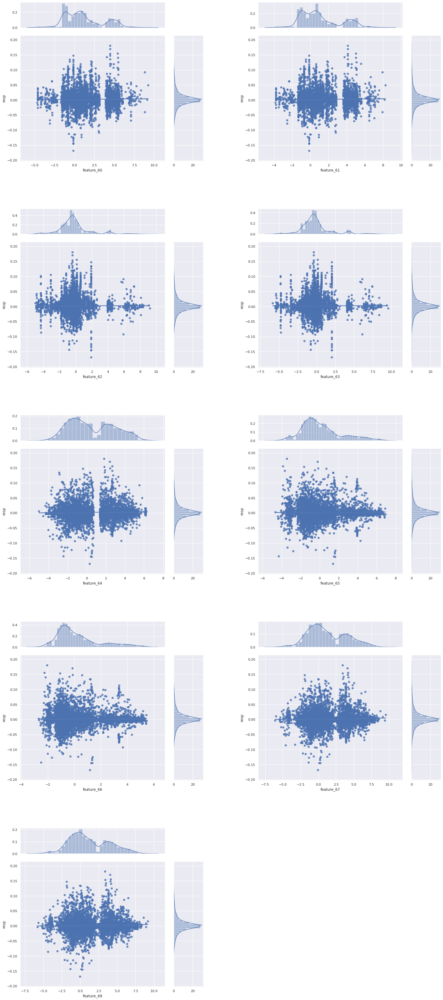

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(5, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_22_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Neutral relation between features  and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Feature 68 has highest **R2 score** in this tag of 0.009 and feature 67,64 has second highest **R2 score** of 0.0008.
* Features 62,63 have lowest **R2 score** of 0.0 in this tag/Group of features.
 

# Group Tag 23
* This Group included Tag 23 features that are created with 24th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_23_df = sample_df[[*categories['tag_23'][0]]]

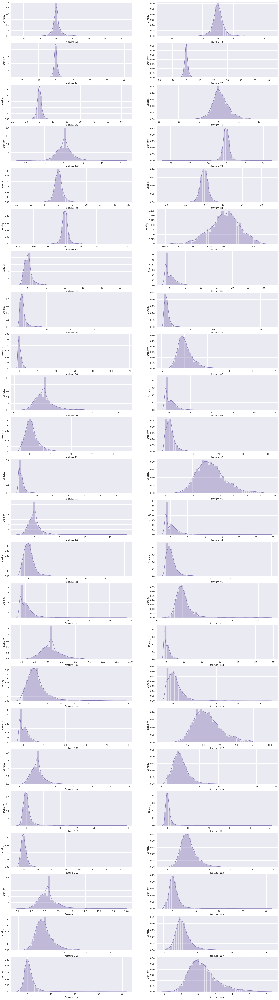

In [ ]:
fig, axes = plt.subplots(nrows=24
                         , ncols=2,figsize=(25,95))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_23_df.columns):
    sns.distplot(tag_23_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 23

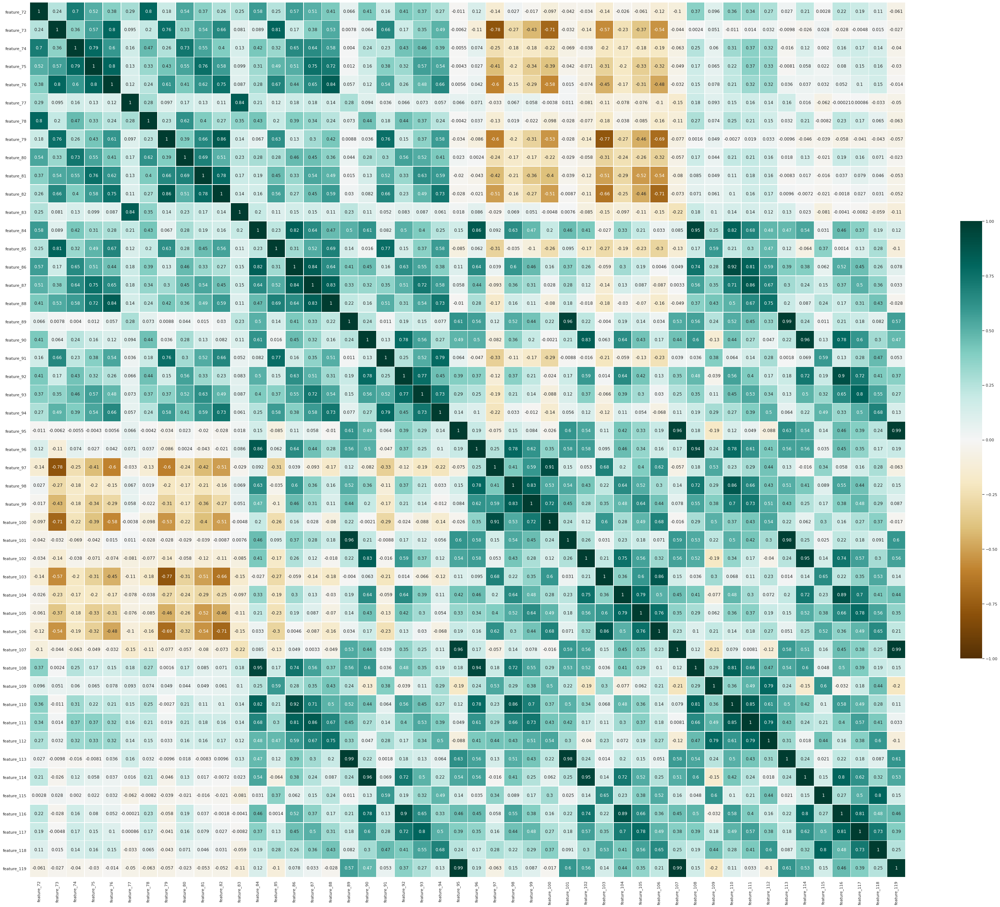

In [ ]:
corr = tag_23_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(55, 45))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 23
   - Here i have tried to find out between different features of Tag 23 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 23 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 23 category and on y axis resp is used.
   

feature_72 R2 score:0.0001
feature_73 R2 score:0.0139
feature_74 R2 score:0.0011
feature_75 R2 score:0.0039
feature_76 R2 score:0.0093
feature_77 R2 score:0.0018
feature_78 R2 score:0.0001
feature_79 R2 score:0.0183
feature_80 R2 score:0.0005
feature_81 R2 score:0.0071
feature_82 R2 score:0.0136
feature_83 R2 score:0.0005
feature_84 R2 score:0.0004
feature_85 R2 score:0.0161
feature_86 R2 score:0.0015
feature_87 R2 score:0.0051
feature_88 R2 score:0.0071
feature_89 R2 score:0.0059
feature_90 R2 score:0.0005
feature_91 R2 score:0.0155
feature_92 R2 score:0.0
feature_93 R2 score:0.002
feature_94 R2 score:0.0067
feature_95 R2 score:0.0006
feature_96 R2 score:0.0005
feature_97 R2 score:0.0082
feature_98 R2 score:0.0
feature_99 R2 score:0.0002
feature_100 R2 score:0.0049
feature_101 R2 score:0.0091
feature_102 R2 score:0.0004
feature_103 R2 score:0.0112
feature_104 R2 score:0.0014
feature_105 R2 score:0.0043
feature_106 R2 score:0.0111
feature_107 R2 score:0.0011
feature_108 R2 score:0.0007

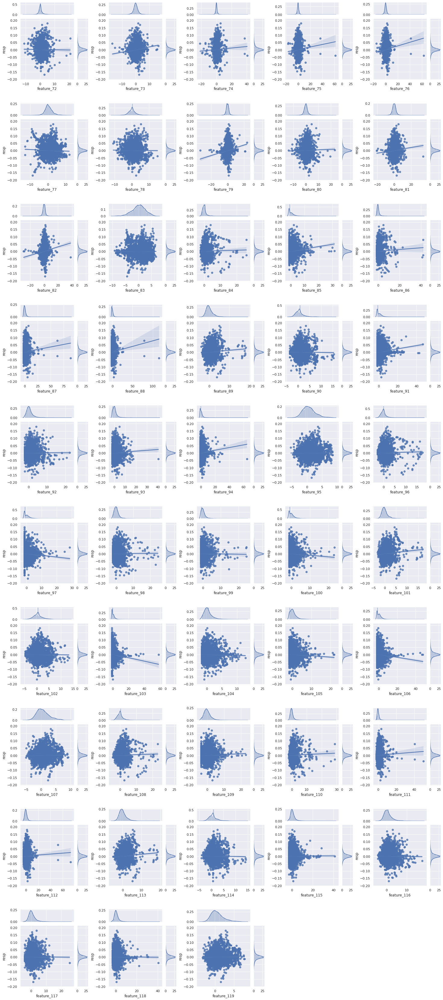

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(10, 5, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_23_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between features 73,74,75,76,79,81,82,85,87,88,91,94,111,101 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between features 77,103,106 and resp(target variable) is found in this Group.
* Features 79 has highest **R2 score** in this tag of 0.018 and feature 73 has second highest **R2 score** of 0.016.
* Features 92 has lowest **R2 score** of 0.0 in this tag/Group of features.
 

# Group Tag 24
* This Group included Tag 24 features that are created with 25th similar concept another thing to note here is that some of the features are created with multiple concept. 

In [ ]:
tag_24_df = sample_df[[*categories['tag_24'][0]]]

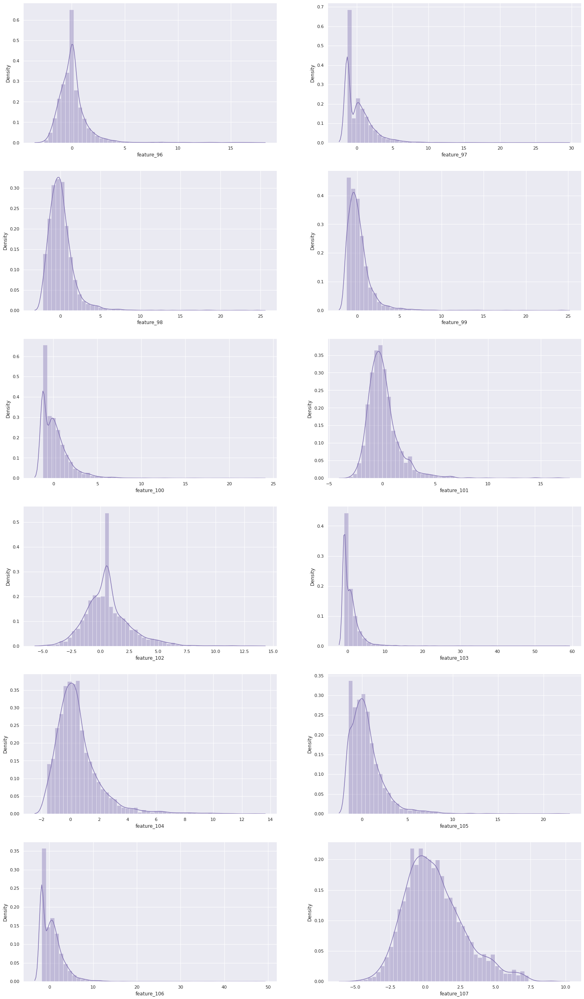

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_24_df.columns):
    sns.distplot(tag_24_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 24

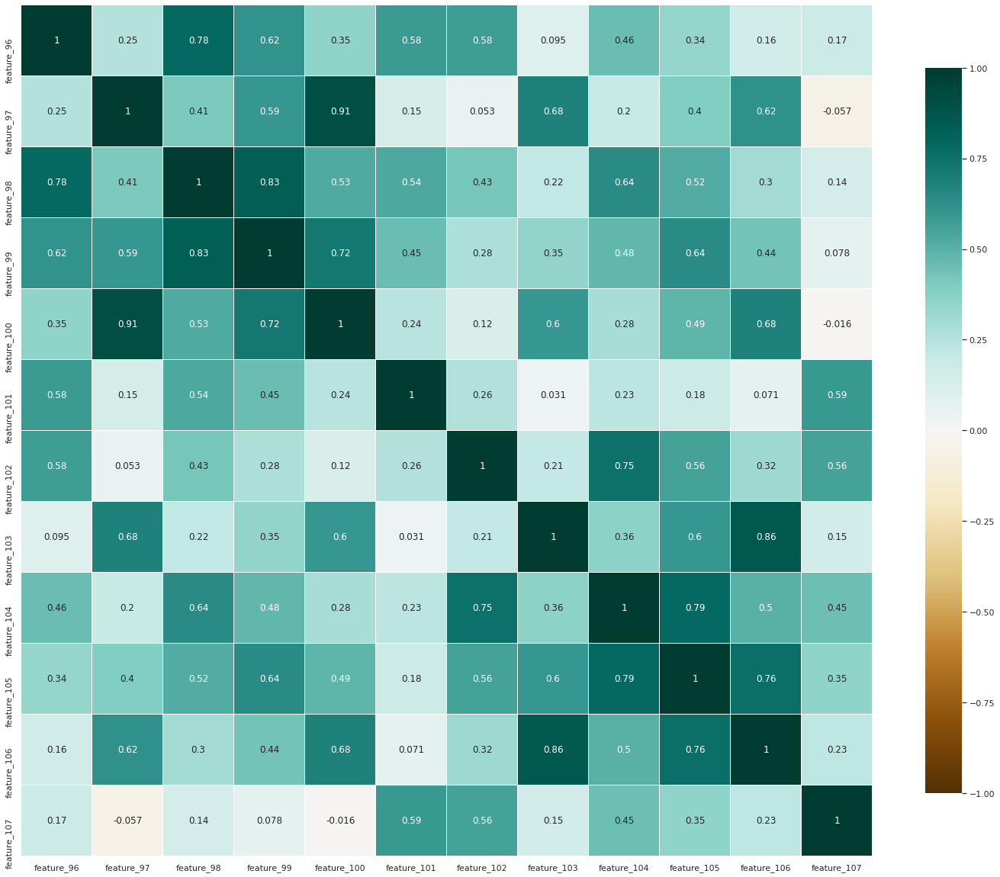

In [ ]:
corr = tag_24_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(25, 35))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 24
   - Here i have tried to find out between different features of Tag 24 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 24 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 24 category and on y axis resp is used.
   

feature_96 R2 score:0.0005
feature_97 R2 score:0.0082
feature_98 R2 score:0.0
feature_99 R2 score:0.0002
feature_100 R2 score:0.0049
feature_101 R2 score:0.0091
feature_102 R2 score:0.0004
feature_103 R2 score:0.0112
feature_104 R2 score:0.0014
feature_105 R2 score:0.0043
feature_106 R2 score:0.0111
feature_107 R2 score:0.0011


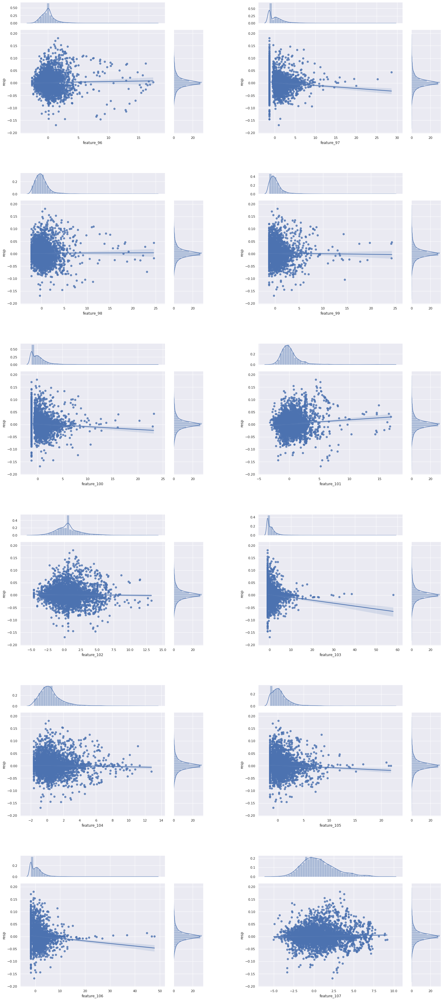

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_24_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between features 96,101 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between features 100,103,105,106 and resp(target variable) is found in this Group.
* Features 103 has highest **R2 score** in this tag of 0.0112 and feature 106 has second highest **R2 score** of 0.0111.
* Features 98 has lowest **R2 score** of 0.0 in this tag/Group of features.
 

# Group Tag 25
* This Group included Tag 25 features that are created with 26th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_25_df = sample_df[[*categories['tag_25'][0]]]

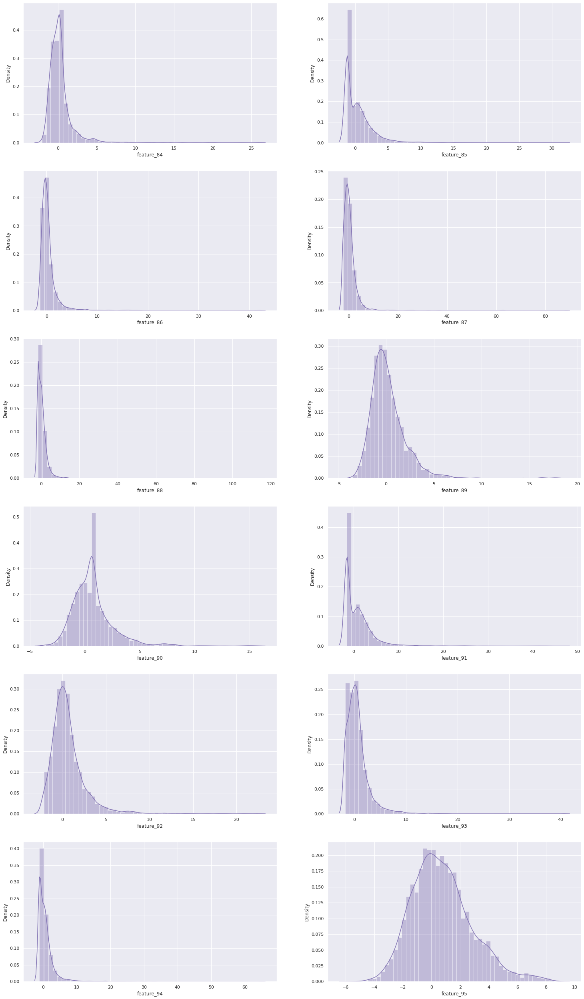

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_25_df.columns):
    sns.distplot(tag_25_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 25

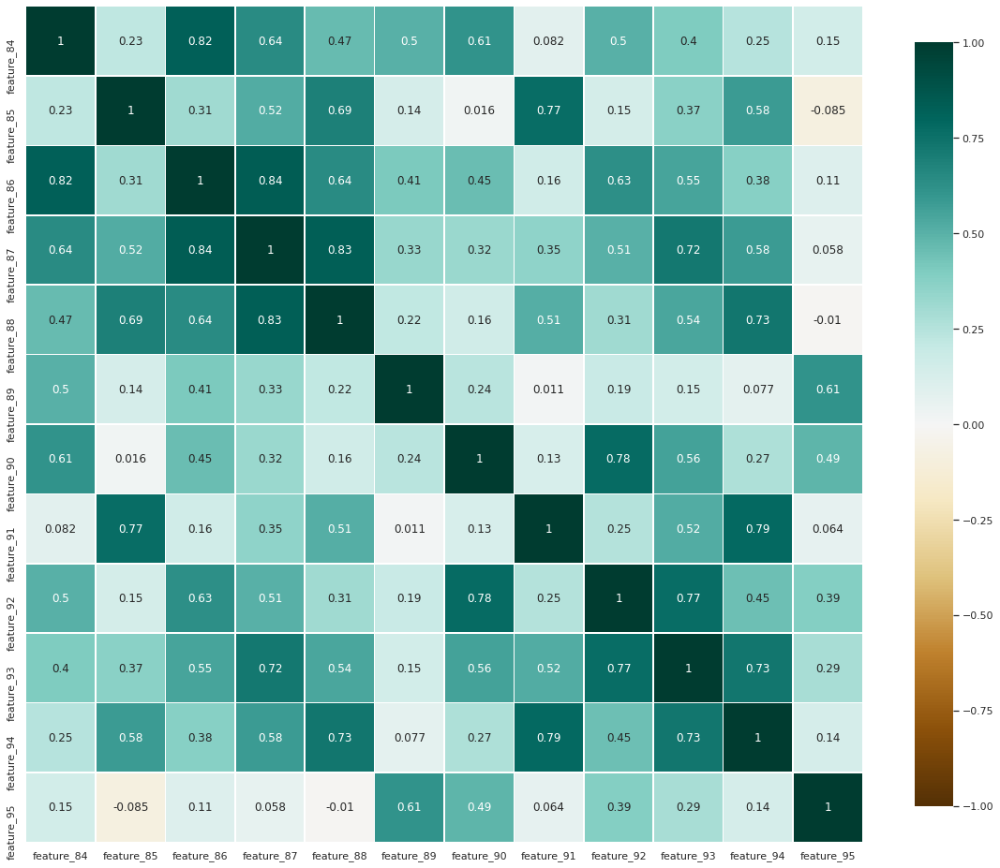

In [ ]:
corr = tag_25_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 30))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 25
   - Here i have tried to find out between different features of Tag 25 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 25 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 25 category and on y axis resp is used.
   

feature_84 R2 score:0.0004
feature_85 R2 score:0.0161
feature_86 R2 score:0.0015
feature_87 R2 score:0.0051
feature_88 R2 score:0.0071
feature_89 R2 score:0.0059
feature_90 R2 score:0.0005
feature_91 R2 score:0.0155
feature_92 R2 score:0.0
feature_93 R2 score:0.002
feature_94 R2 score:0.0067
feature_95 R2 score:0.0006


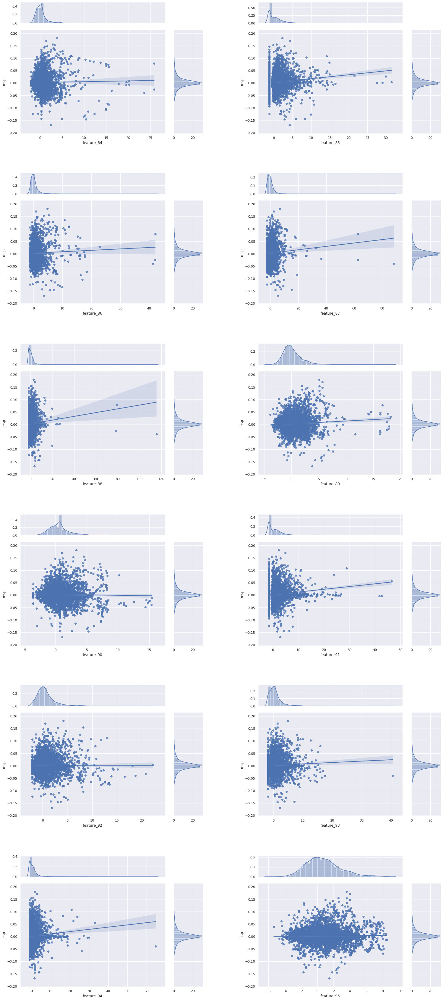

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_25_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between features 85,86,87,88,89,91,94,111,101 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between feature 90 and resp(target variable) is found in this Group.
* Features 85 has highest **R2 score** in this tag of 0.016 and feature 91 has second highest **R2 score** of 0.015.
* Features 92 has lowest **R2 score** of 0.0 in this tag/Group of features.
 

# Group Tag 26
* This Group included Tag 26 features that are created with 27th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_26_df = sample_df[[*categories['tag_26'][0]]]

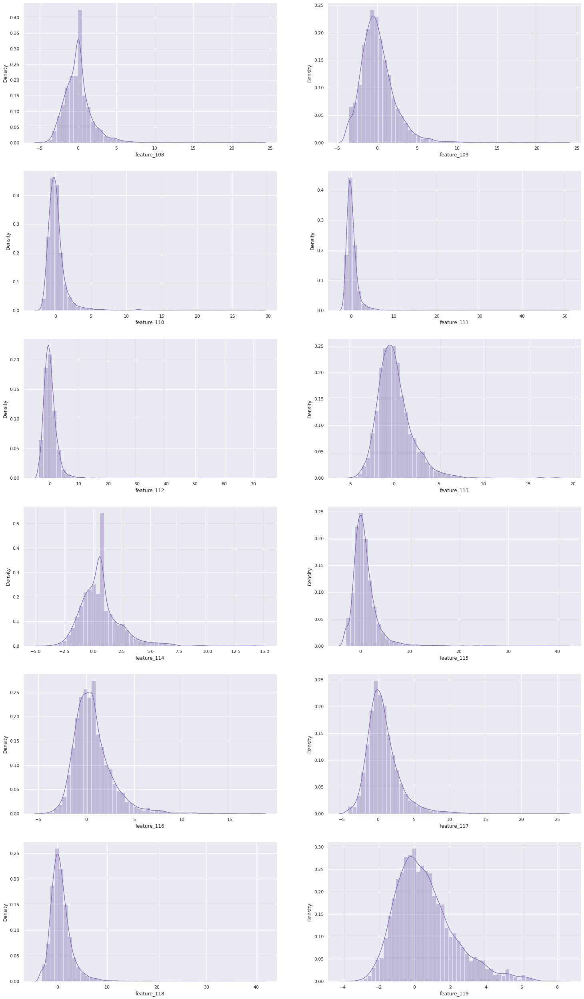

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_26_df.columns):
    sns.distplot(tag_26_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 26

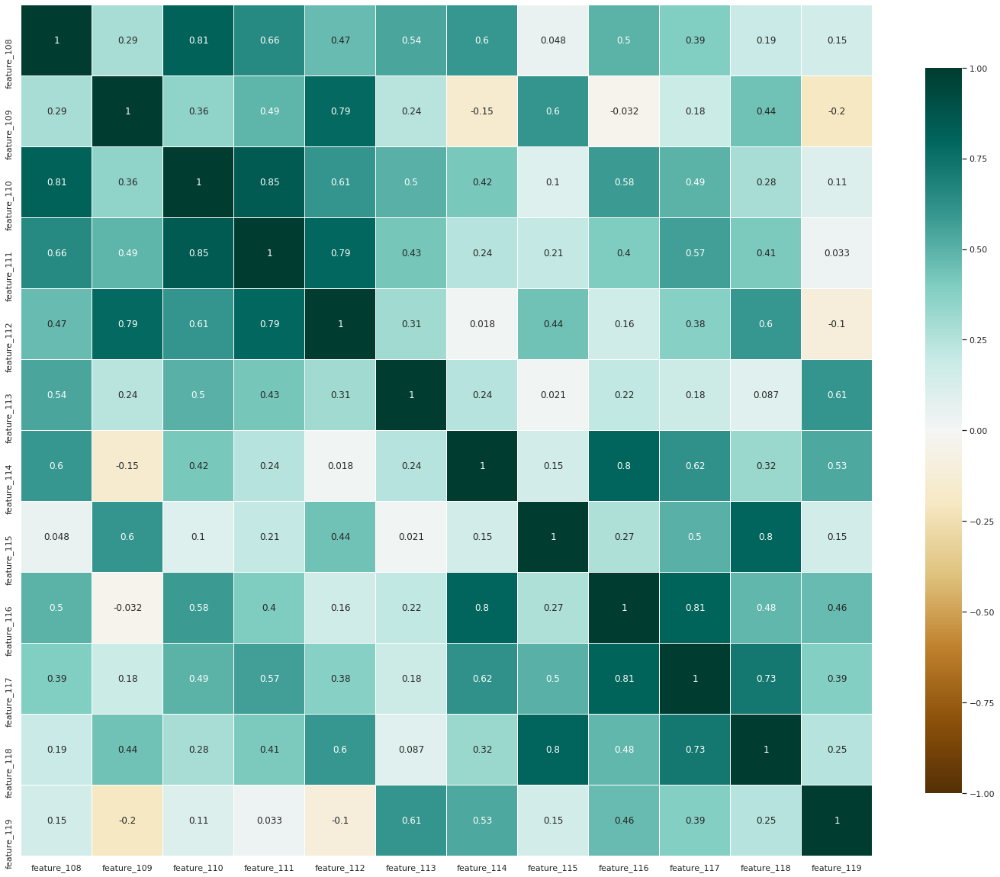

In [ ]:
corr = tag_26_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(25, 35))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 26
   - Here i have tried to find out between different features of Tag 26 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 26 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 26 category and on y axis resp is used.
   

feature_108 R2 score:0.0007
feature_109 R2 score:0.0015
feature_110 R2 score:0.0008
feature_111 R2 score:0.0011
feature_112 R2 score:0.0009
feature_113 R2 score:0.0074
feature_114 R2 score:0.0005
feature_115 R2 score:0.0
feature_116 R2 score:0.0004
feature_117 R2 score:0.0001
feature_118 R2 score:0.0001
feature_119 R2 score:0.0008


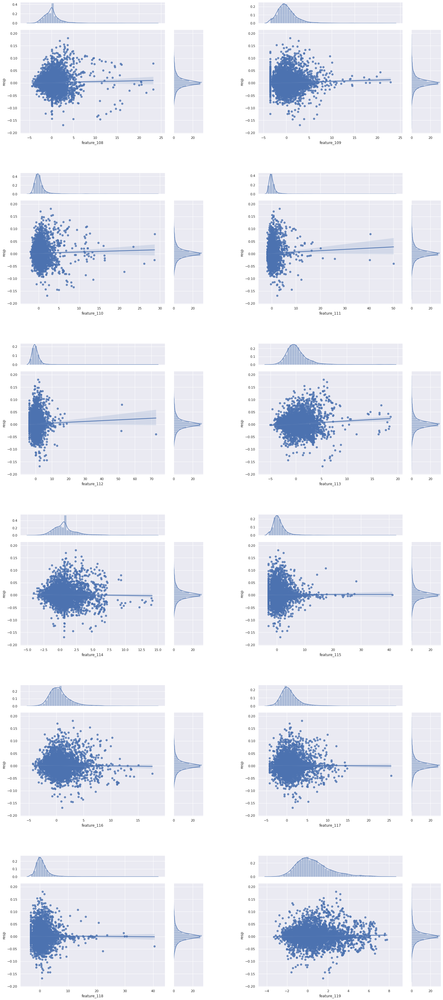

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_26_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between features 10,111,112,113 and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between feature 116 and resp(target variable) is found in this Group.
* Features 113 has highest **R2 score** in this tag of 0.0074 and feature 109 has second highest **R2 score** of 0.0015.
* Features 115 has lowest **R2 score** of 0.0 in this tag/Group of features.
 

# Group Tag 27
* This Group included Tag 27 features that are created with 28th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_27_df = sample_df[[*categories['tag_27'][0]]]

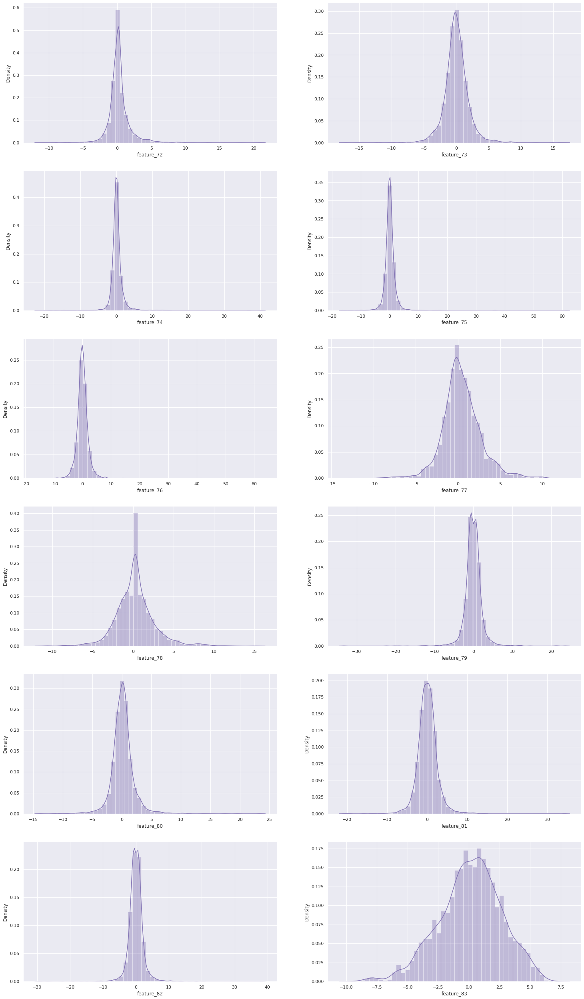

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_27_df.columns):
    sns.distplot(tag_27_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 27

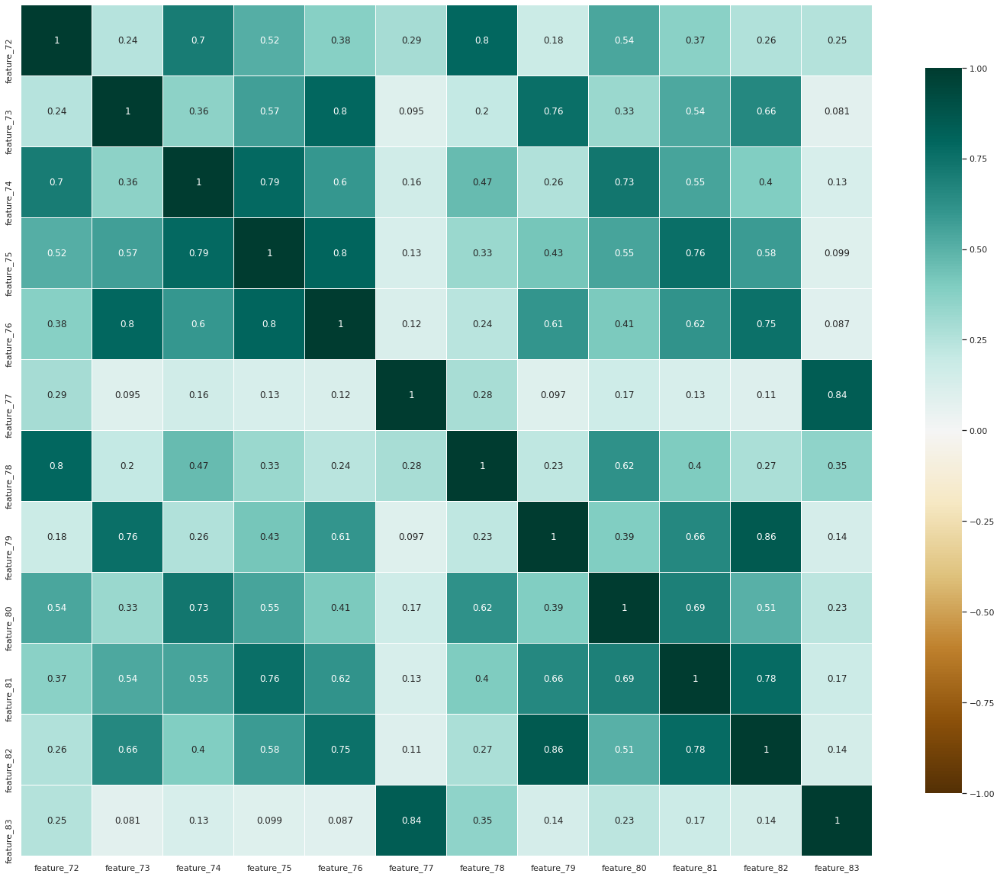

In [ ]:
corr = tag_27_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(25, 35))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 27
   - Here i have tried to find out between different features of Tag 27 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 27 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 27 category and on y axis resp is used.
   

feature_72 R2 score:0.0001
feature_73 R2 score:0.0139
feature_74 R2 score:0.0011
feature_75 R2 score:0.0039
feature_76 R2 score:0.0093
feature_77 R2 score:0.0018
feature_78 R2 score:0.0001
feature_79 R2 score:0.0183
feature_80 R2 score:0.0005
feature_81 R2 score:0.0071
feature_82 R2 score:0.0136
feature_83 R2 score:0.0005


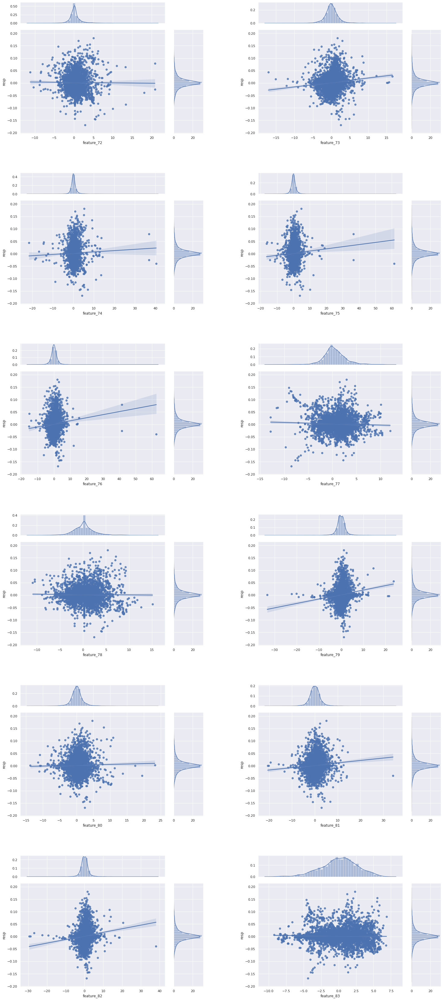

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_27_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


* Positive relation between features 73,74,75,76,79,81,80,82, and resp(target variable) can be seen in ****Linear Regression analysis**** above.
* Negative relation between feature 78 and resp(target variable) is found in this Group.
* Features 79 has highest **R2 score** in this tag of 0.018 and feature 73 has second highest **R2 score** of 0.016.
* Features 72 has lowest **R2 score** of 0.0001 in this tag/Group of features.
 

# Group Tag 28
* This Group included Tag 28 features that are created with 29th similar concept another thing to note here is that some of the features are created with multiple concept.

In [ ]:
tag_28_df = sample_df[[*categories['tag_28'][0]]]

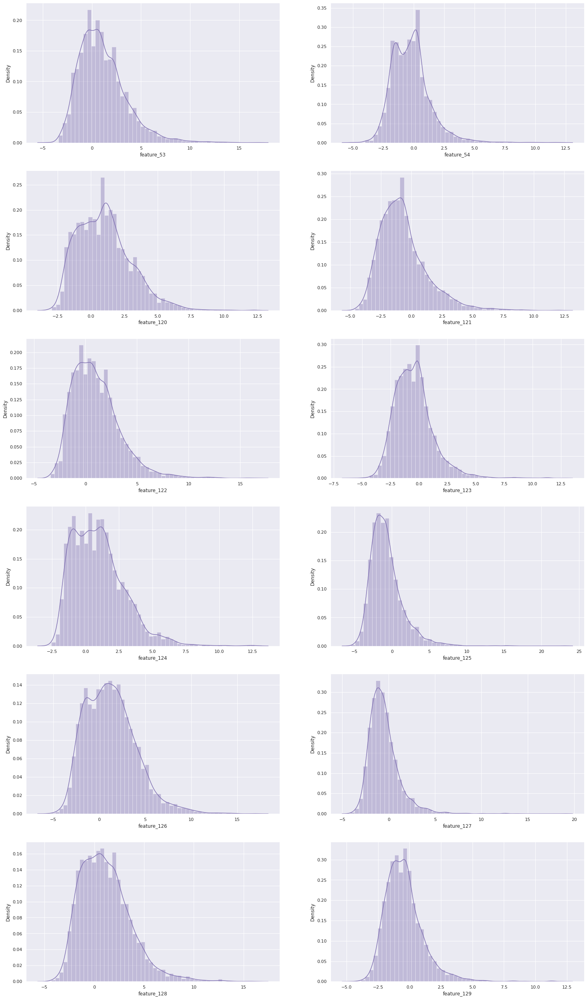

In [ ]:
fig, axes = plt.subplots(nrows=6
                         , ncols=2,figsize=(25,45))
# fig = plt.figure(figsize = (25,20))
for i, column in enumerate(tag_28_df.columns):
    sns.distplot(tag_28_df[column],ax=axes[i//2,i%2],color='m')

# Correlation Analysis of Group 28

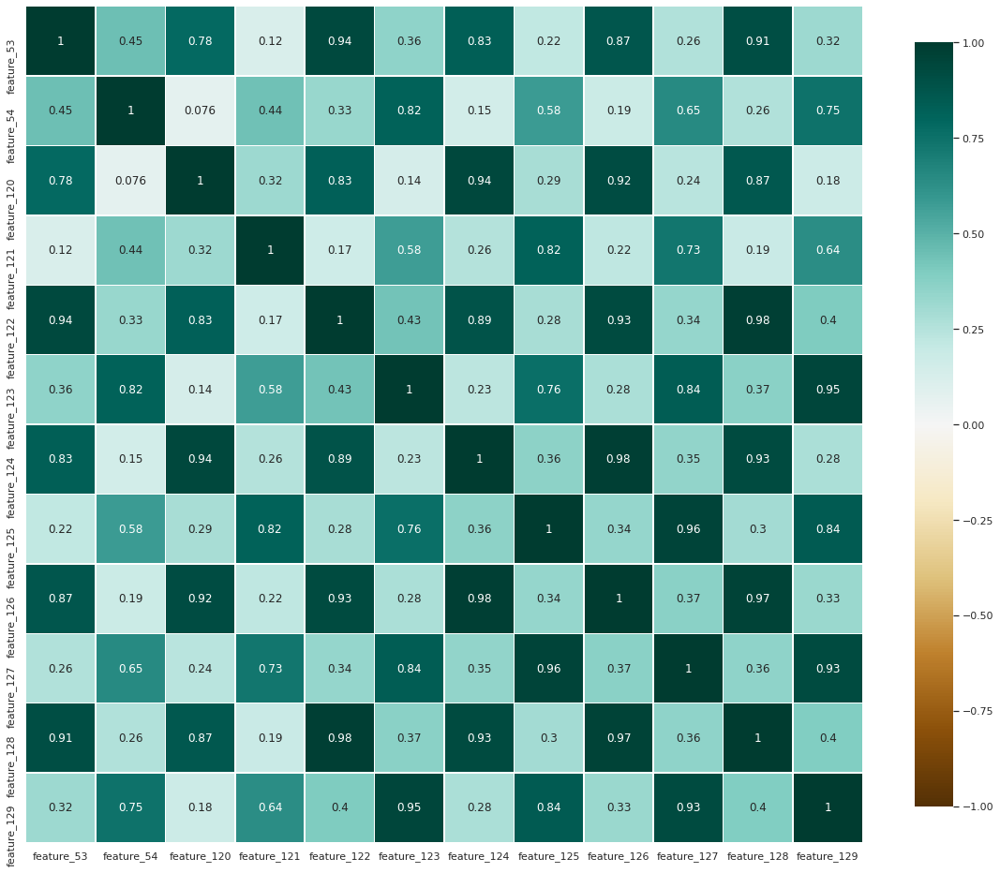

In [ ]:
corr = tag_28_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 30))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='BrBG',  center=0,vmin=-1, vmax=1, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

   # Linear Regression Analysis of Group 28
   - Here i have tried to find out between different features of Tag 28 and resp.
   - for this i have plotted scatter plot  along with marginal distribution of each features in Tag 28 and fitted a linear model.
   - in these chart on x axis these are the different featues that belong to Tag 28 category and on y axis resp is used.
   

feature_53 R2 score:0.0005
feature_54 R2 score:0.0
feature_120 R2 score:0.0
feature_121 R2 score:0.0008
feature_122 R2 score:0.0004
feature_123 R2 score:0.0001
feature_124 R2 score:0.0001
feature_125 R2 score:0.0004
feature_126 R2 score:0.0002
feature_127 R2 score:0.0003
feature_128 R2 score:0.0002
feature_129 R2 score:0.0002


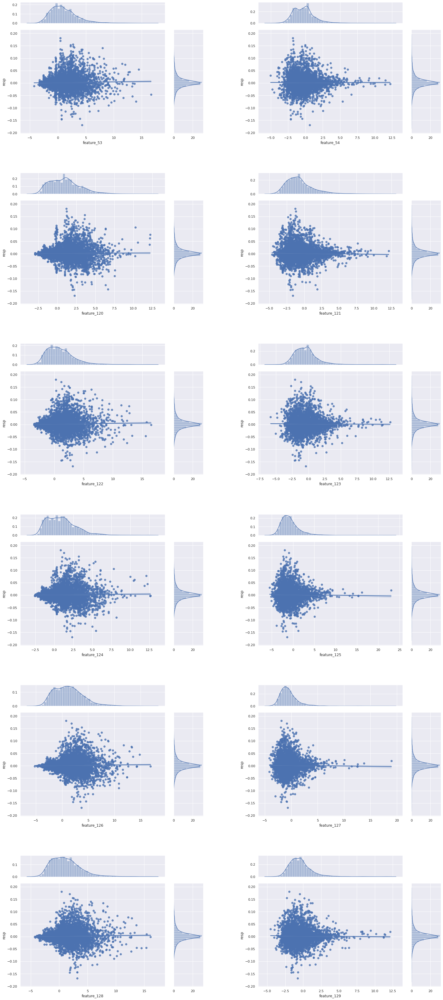

In [ ]:

ratio=4
f = plt.figure(figsize=(25,60))
outer_grid = gridspec.GridSpec(6, 2, wspace=0.3, hspace=0.3)
for i, column in enumerate(tag_28_df.columns):
    gs = gridspec.GridSpecFromSubplotSpec(ratio+1, ratio+1,
            subplot_spec=outer_grid[i], wspace=0.3, hspace=0.3)
    g = myjoint(y="resp", x=column, data=sample_df, ratio=ratio)
    g = g.plot(sns.regplot, sns.distplot)
#     g = g.plot(sns.scatterplot,sns.distplot)
#     plt.xlabel(f"{column}")
    r2_score = r2(x=sample_df[column],y=sample_df["resp"])
    plt.xlabel(f"{column} R2 score:{round(r2_score,4)}")
    print(f"{column} R2 score:{round(r2_score,4)}")
# f.tight_layout()


*  NO Positive  or Negative relation between features and resp(target variable) is  Present   in ****Linear Regression analysis**** above.
* Features 121 has highest **R2 score** in this tag of 0.0121. 
* Features 120 has lowest **R2 score** of 0.0 in this tag/Group of features.
 

# Valueable Insights
These are some insights

* All the feature that are in same tag has some correlation with each other. 
* but there is one features that has no correlation with any other feature in that group and these features are present in first 5 groups that i have explored.
* This correlation pattern exist in group of first features it means that two features(for example 1,2) will have strong correlation then (3,4) will have strong correlation
* by Looking at the distribution of  features that have no correlation with any other member in group it seems that they have been created form same or combination of concepts that are being used in weight feature as they both have similar distribution of data.
* Apart from features that belong to tag 0, Other group's first 6 features have correlation in between them and have no strong correlation with any other member. Last 10 features have same strong correlation patterns as first 6 have in between them.

* Features with Postive Relation with Resp value tend to have Higer R2 Score than Features with Negative Relation for example features 30 and 40 have Highest **R2 Score** in The Groups that are explored.
* Group Tag 6 have Highest Number of features as well Highest Number of R2 score seen in any other Group. **This Validates my Hypothsis about High Significance of the features that are present in this Group**.

* **Postive Relation and Higher R2 Score Between Resp and features indicates that these features can better explain the Resp Value Behaviour**
* **Features 41 ,42 and 43 have Different Distribution than any other feature.This means that they have been created from one similar idea/concept.**
* **Features in  Tag 18,19,20,21,22,28 and Tag 17 have lower values of R2 Score than any other group that i have explored. This can be due to high Skewness and kurtosis that is present in these features. Some of features have bimodel distribution instead of Normal distribution.These might be reasons of low  R2 score of these features.**

